In [2]:
import torch
from torch.utils.data import DataLoader
from levee_hunter.augmentations import no_deformations_transform, normalize_only
from levee_hunter.segmentation_dataset import SegmentationDataset
from levee_hunter.utils import count_parameters
from levee_hunter.plots import infer_and_visualize
from levee_hunter.train_test_split_dataset import train_test_split_dataset
import numpy as np
import segmentation_models_pytorch as smp

import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt

/Users/pawel/miniforge3/envs/Fathom/lib/python3.11/site-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.4 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
/Users/pawel/1PhD_UCL/Fathom/GitHub_Stuff/levee_hunter/augmentations.py:12: UserWarning: Argument 'alpha_affine' is not valid and will be ignored.
  A.ElasticTransform(
/Users/pawel/miniforge3/envs/Fathom/lib/python3.11/site-packages/torchvision/io/image.py:14: UserWarning: Failed to load image Python extension: 'dlopen(/Users/pawel/miniforge3/envs/Fathom/lib/python3.11/site-packages/torchvision/image.so, 0x0006): Library not loaded: @rpath/libjpeg.9.dylib
  Referenced from: <EB3FF92A-5EB1-3EE8-AF8B-5923C1265422> /Users/pawel/miniforge3/envs/Fathom/lib/python3.11/site-packages/torchvision/image.so
  Reason: tried: '/Users/pawel/miniforge3/envs/Fath

# General Idea

There are three different datasets which were chosen by manually looking through 664 images in the original dataset which had removed invalid images (values lower than -9999) and kept only 0.1 empty images. So the original dataset from which those 3 are created already contained empty images.

1. good_dataset - contains images which likely do not have missing levees or not too much missing levees, already has some empty images
2. better_dataset - contains images which most likely do not contain any missing levees, has less empty images as well
3. bad_dataset - contains images which likely have some missing levees, this can be used for validation by eye

In [5]:
# Load the datasets
good_dataset = torch.load(
    "../data/processed/w3-4-based-datasets/good_dataset_1m_512.pth"
)
better_dataset = torch.load(
    "../data/processed/w3-4-based-datasets/better_dataset_1m_512.pth"
)
bad_dataset = torch.load("../data/processed/w3-4-based-datasets/bad_dataset_1m_512.pth")

weights = torch.load("../data/raw/w4-Lidar/1m_resolution/weights_512.pt")

print(len(good_dataset))
print(len(better_dataset))
print(len(bad_dataset))

/var/folders/tk/2_f29kq533g52jyhs9y4xt000000gn/T/ipykernel_6272/12312291.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  good_dataset = torch.load(


FileNotFoundError: [Errno 2] No such file or directory: '../data/processed/w3-4-based-datasets/good_dataset_1m_512.pth'

In [7]:
device = "cuda" if torch.cuda.is_available() else "cpu"

In [6]:
# Set transforms, for training use augmentations, for testing just normalize
good_dataset.transform = no_deformations_transform
better_dataset.transform = no_deformations_transform
bad_dataset.transform = normalize_only


device = "cuda" if torch.cuda.is_available() else "cpu"
# Convert to tensor and move to device
weights = weights.to(device)

good_dataset.weights = weights

NameError: name 'good_dataset' is not defined

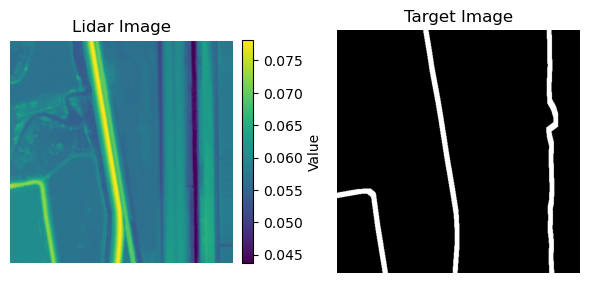

In [4]:
good_dataset.plot(139, transform=True)

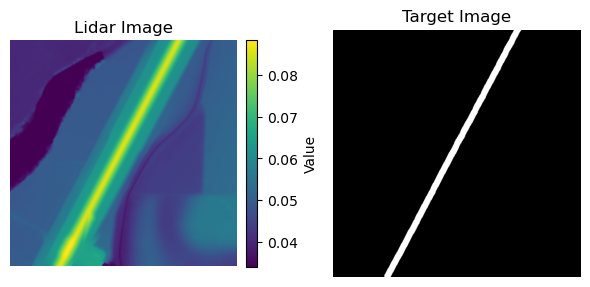

In [5]:
better_dataset.plot(100, transform=True)

# First I am going to train on good_images dataset

but I also need to split it into validation and training:

In [6]:
good_dataset.images

array([[[[ 1.6803144 ,  1.6973474 ,  1.6729718 , ...,  3.282481  ,
           3.6113925 ,  3.931547  ],
         [ 1.6951562 ,  1.6946843 ,  1.6762486 , ...,  3.086074  ,
           3.452169  ,  3.7715452 ],
         [ 1.6746852 ,  1.6712484 ,  1.6768758 , ...,  2.884044  ,
           3.2538874 ,  3.5915453 ],
         ...,
         [ 1.8609376 ,  1.8334405 ,  1.8229692 , ...,  1.7354727 ,
           1.7737556 ,  1.7328143 ],
         [ 1.8595314 ,  1.8293723 ,  1.8093734 , ...,  1.7671896 ,
           1.7678077 ,  1.7223411 ],
         [ 1.8456205 ,  1.8215612 ,  1.8115631 , ...,  1.7793746 ,
           1.7671908 ,  1.7339101 ]]],


       [[[ 1.6457782 ,  1.82031   ,  1.9087467 , ...,  1.9048452 ,
           1.8915626 ,  1.8873445 ],
         [ 1.5921801 ,  1.7703056 ,  1.8817165 , ...,  1.9146881 ,
           1.8981266 ,  1.8939077 ],
         [ 1.5487489 ,  1.7115594 ,  1.8584356 , ...,  1.923282  ,
           1.9068747 ,  1.9067199 ],
         ...,
         [ 1.7707819 ,  1.756406

In [7]:
training_dataset, val_dataset = train_test_split_dataset(good_dataset, test_size=0.2)

len(training_dataset), len(val_dataset)

(704, 177)

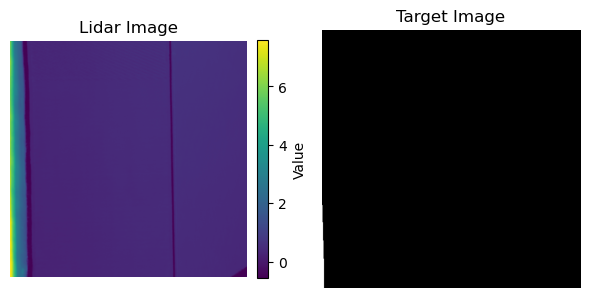

In [8]:
training_dataset.plot(19)

In [9]:
training_dataset.weights[:20]

tensor([2., 2., 2., 2., 2., 1., 2., 2., 2., 2., 2., 1., 2., 2., 2., 2., 2., 2.,
        2., 1.])

In [10]:
batch_size = 32

train_loader = DataLoader(training_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=len(val_dataset), shuffle=False)

train_loader.dataset.images[0].shape, len(train_loader.dataset.images)

((1, 512, 512), 704)

# Model

In [8]:
model = smp.Unet(
    encoder_name="resnet34", encoder_weights="imagenet", in_channels=1, classes=1
).to(device)

# Define weighted loss function
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-3)

In [12]:
training_dataset.weights_return = True

In [ ]:
best_loss = float("inf")
epochs = 25

train_loss_list = []
val_loss_list = []

for epoch in range(epochs):
    model.train()
    train_loss = 0.0

    for batch in train_loader:
        if training_dataset.weights_return:
            images, mask, weights = batch  # Extract weights if present
            images, mask, weights = (
                images.to(device),
                mask.to(device),
                weights.to(device),
            )
        else:
            images, mask = batch
            images, mask = images.to(device), mask.to(device)
            weights = torch.ones_like(mask)  # Default weights = 1 if not provided

        optimizer.zero_grad()
        output = model(images)

        # Compute weighted loss
        # By default reduction is mean, so it would take an average over
        # all images and all pixels in the batch, returning single scalar
        # But that would make it impossible to apply weights
        # So in our case we set reduction to none, this creates an instance of
        # loss function which is then applied to output, mask, where output is actually
        # an array of outputs (batch_size, 1, H, W)
        loss = nn.BCEWithLogitsLoss(reduction="none")(
            output, mask
        )  # Compute per-element loss

        # Computing weighted loss is just computing a weighted average
        # We normally would do loss.mean() which gets an average over
        # all images in batch and all their pixels
        # Here we want to still take an average over pixels, but
        # the average over images should be weighted
        # loss.shape = (batch_size, 1, H, W), so to average over pixels
        # we can take mean with dim=(2,3) argument, this results in
        # loss.shapr = (batch_size, 1), so to multiply by weights we need to
        # reshape with .view(-1, 1). Then to get weighted average we sum the loss
        # and divide over sum of weights
        # Loss is then just a scalar for which we can then compute gradients with
        # respect to model parameters
        loss = loss.mean(
            dim=(2, 3)
        )  # Compute mean over H and W (pixel-wise mean per image)

        # Normalize by total weight sum (to match validation loss scale)
        loss = (loss * weights.view(-1, 1)).sum() / weights.sum()

        loss.backward()
        optimizer.step()
        train_loss += loss.item()

    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for batch in val_loader:
            images, mask = batch  # Validation does not use weights
            images, mask = images.to(device), mask.to(device)

            output = model(images)
            loss = nn.BCEWithLogitsLoss()(output, mask)  # Standard loss for validation

            val_loss += loss.item()

    train_loss /= len(train_loader)
    val_loss /= len(val_loader)

    train_loss_list.append(train_loss)
    val_loss_list.append(val_loss)

    print(
        f"Epoch: {epoch+1}/{epochs} Train Loss: {train_loss:.6f} Val Loss: {val_loss:.6f}"
    )

Epoch: 1/25 Train Loss: 0.412550 Val Loss: 0.252540
Epoch: 2/25 Train Loss: 0.180131 Val Loss: 0.144511
Epoch: 3/25 Train Loss: 0.114575 Val Loss: 0.122266
Epoch: 4/25 Train Loss: 0.084971 Val Loss: 0.079770
Epoch: 5/25 Train Loss: 0.069656 Val Loss: 0.065382
Epoch: 6/25 Train Loss: 0.061554 Val Loss: 0.060186
Epoch: 7/25 Train Loss: 0.057579 Val Loss: 0.056127
Epoch: 8/25 Train Loss: 0.053253 Val Loss: 0.055324
Epoch: 9/25 Train Loss: 0.049669 Val Loss: 0.053768
Epoch: 10/25 Train Loss: 0.047429 Val Loss: 0.051699
Epoch: 11/25 Train Loss: 0.045781 Val Loss: 0.049107
Epoch: 12/25 Train Loss: 0.045683 Val Loss: 0.046991
Epoch: 13/25 Train Loss: 0.043637 Val Loss: 0.047422
Epoch: 14/25 Train Loss: 0.044470 Val Loss: 0.047797
Epoch: 15/25 Train Loss: 0.042826 Val Loss: 0.051658
Epoch: 16/25 Train Loss: 0.042046 Val Loss: 0.048616
Epoch: 17/25 Train Loss: 0.042330 Val Loss: 0.047853
Epoch: 18/25 Train Loss: 0.041286 Val Loss: 0.043936
Epoch: 19/25 Train Loss: 0.040366 Val Loss: 0.046392
Ep

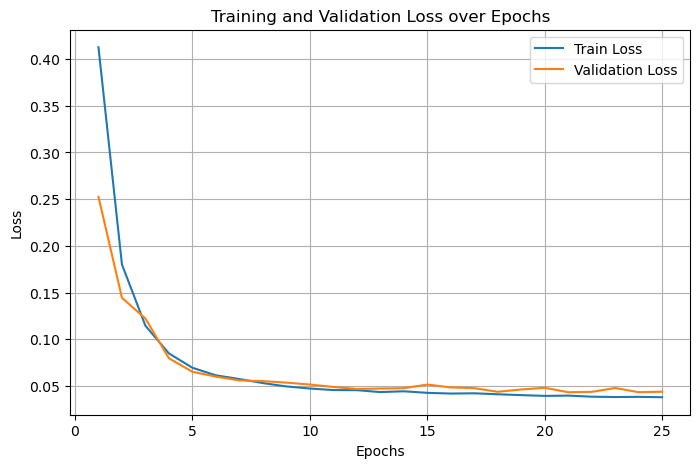

In [14]:
# Plot training and validation loss
epochs_range = range(1, len(train_loss_list) + 1)

plt.figure(figsize=(8, 5))
plt.plot(epochs_range, train_loss_list, label="Train Loss")
plt.plot(epochs_range, val_loss_list, label="Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Training and Validation Loss over Epochs")
plt.legend()
plt.grid(True)
plt.show()

In [15]:
def compute_iou(preds, masks, threshold=0.5):
    """
    Compute IoU (Intersection over Union) for binary segmentation.

    Args:
    - preds: Model predictions (logits before activation)
    - masks: Ground truth masks
    - threshold: Binarization threshold (default 0.5)

    Returns:
    - IoU score
    """
    preds = torch.sigmoid(preds)  # Apply sigmoid to get probabilities
    preds = (preds > threshold).float()  # Convert to binary mask

    intersection = (preds * masks).sum(dim=(1, 2, 3))  # TP
    union = ((preds + masks) > 0).sum(dim=(1, 2, 3))  # TP + FP + FN

    iou = (intersection + 1e-6) / (union + 1e-6)  # Avoid division by zero
    return iou.mean().item()


# Evaluation loop
model.eval()
iou_scores = []

with torch.no_grad():
    for images, masks in val_loader:
        images, masks = images.to(device), masks.to(device)
        outputs = model(images)  # Get logits
        iou = compute_iou(outputs, masks)  # Compute IoU
        iou_scores.append(iou)

mean_iou = np.mean(iou_scores)
print(f"Mean IoU on validation set: {mean_iou:.4f}")

Mean IoU on validation set: 0.9821


In [16]:
torch.save(model.state_dict(), "../models/w4-based-models/unet-model_good.pth")

print("Saved model at ../models/w4-based-models/unet-model_good.pth")

Saved model at ../models/w4-based-models/unet-model_good.pth


In [17]:
from levee_hunter.plots import infer_and_visualize

0


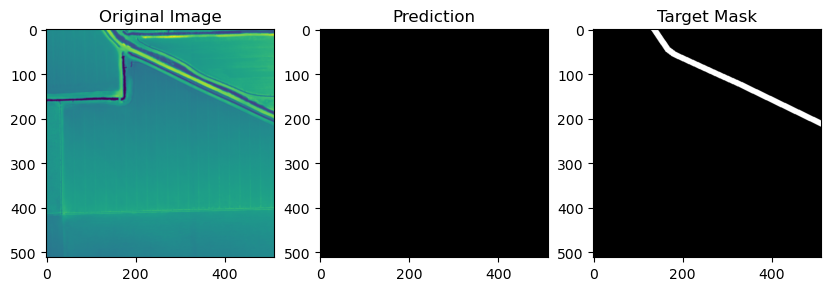

1


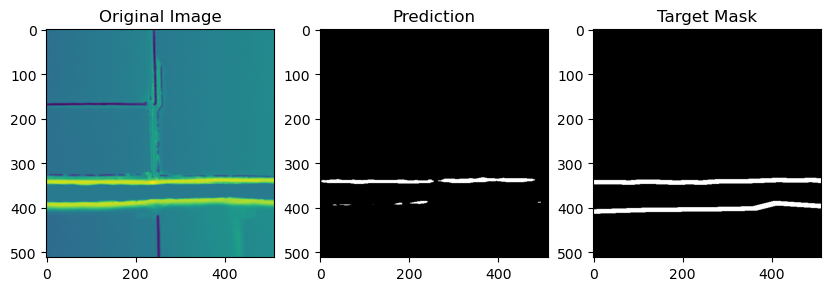

2


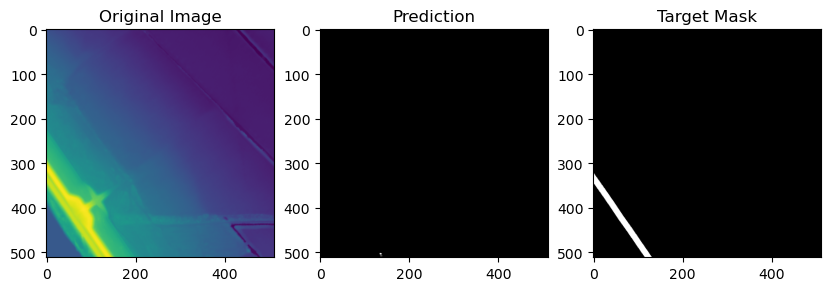

3


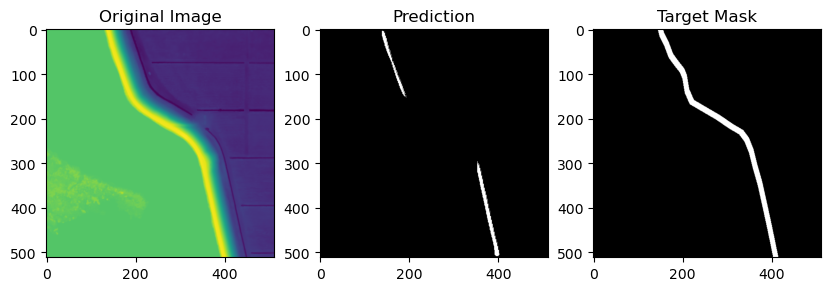

4


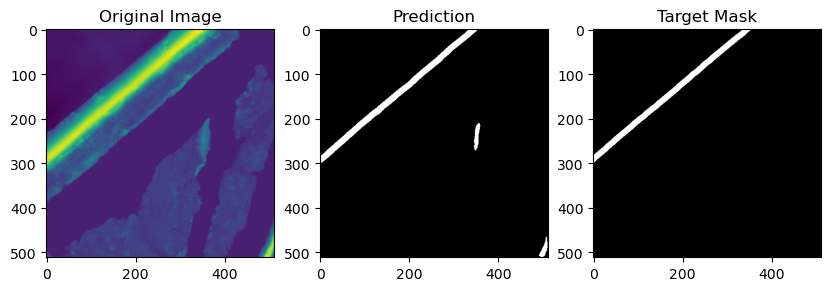

5


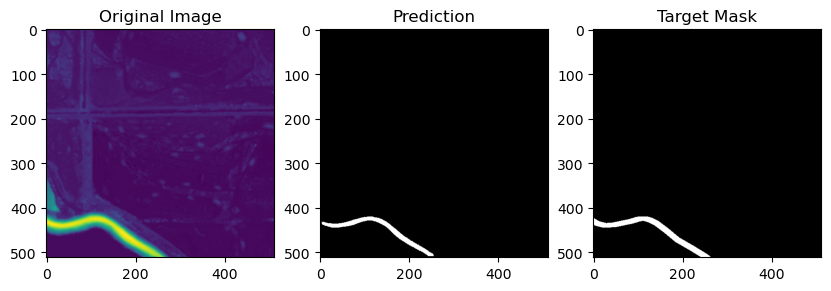

6


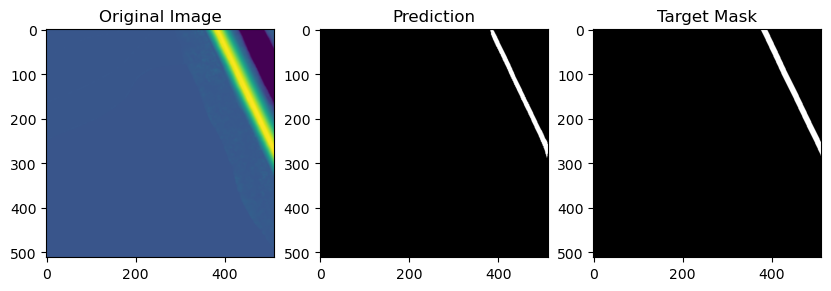

7


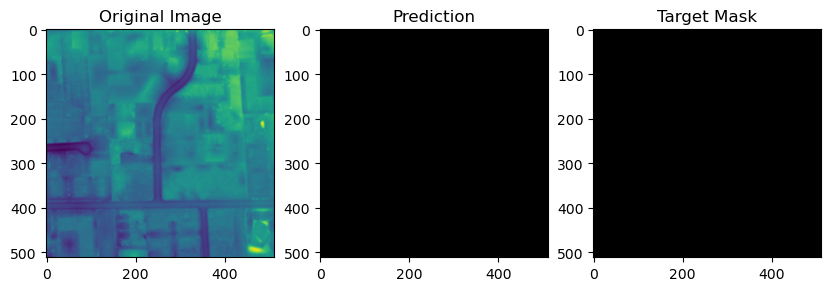

8


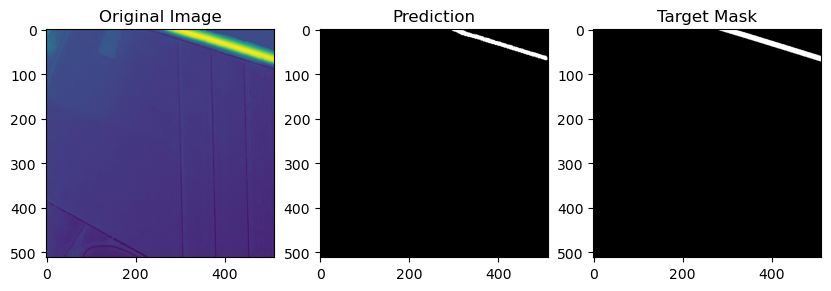

9


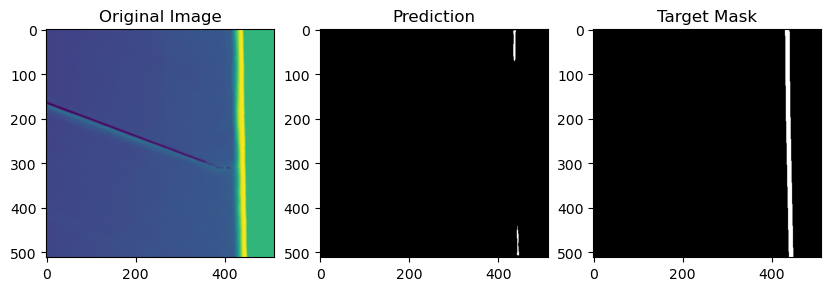

10


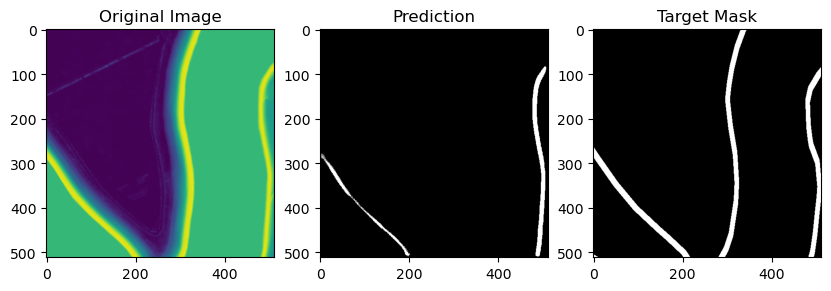

11


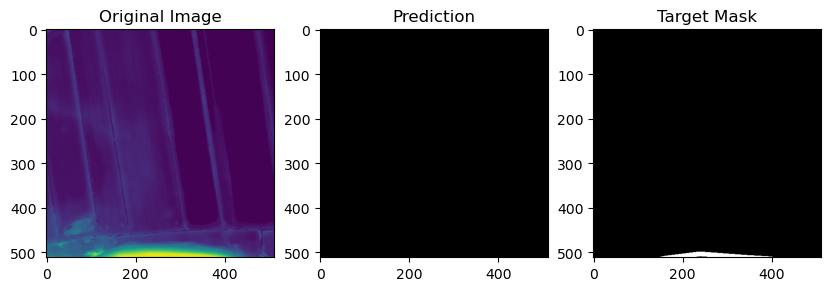

12


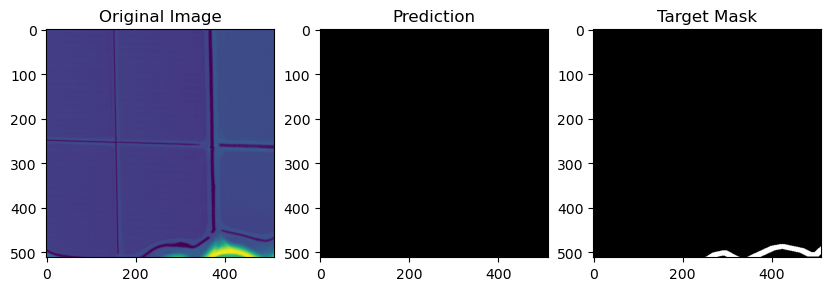

13


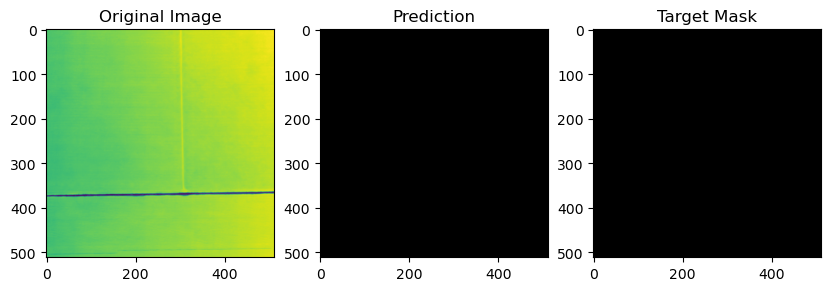

14


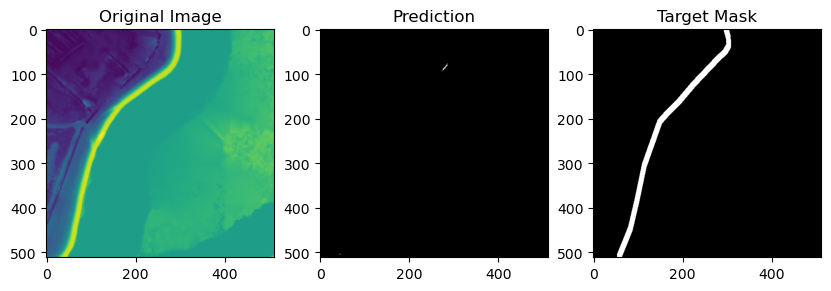

15


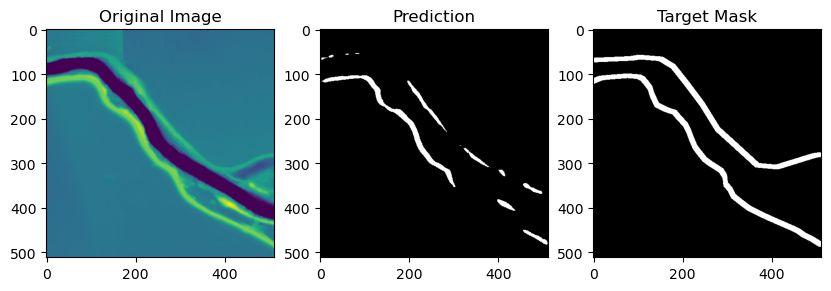

16


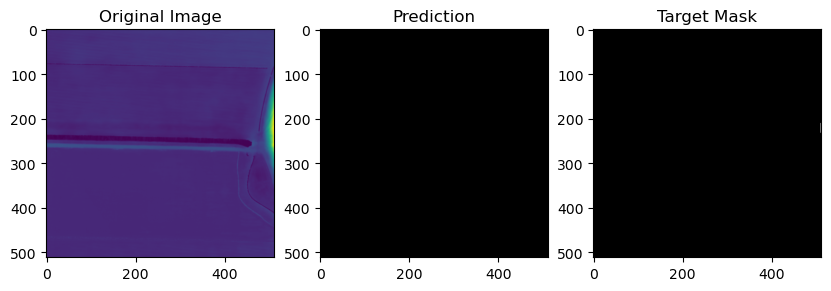

17


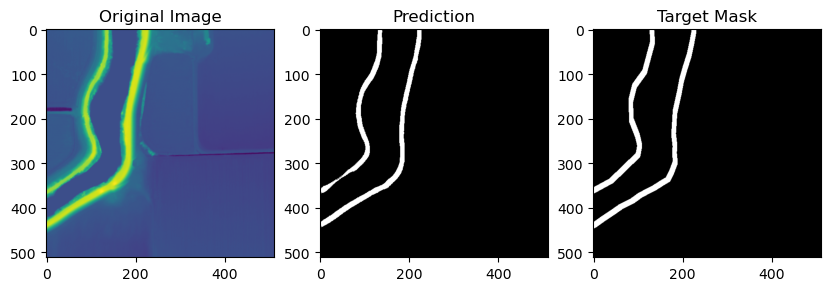

18


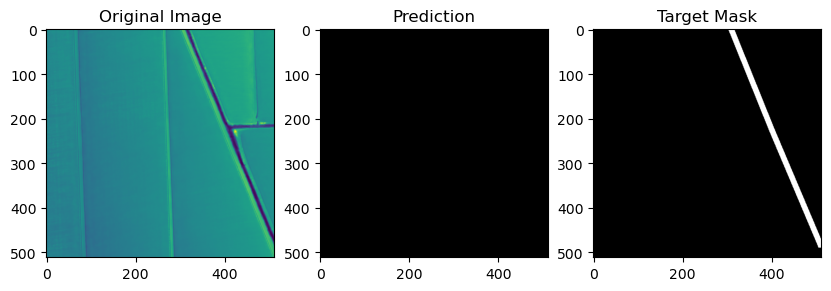

19


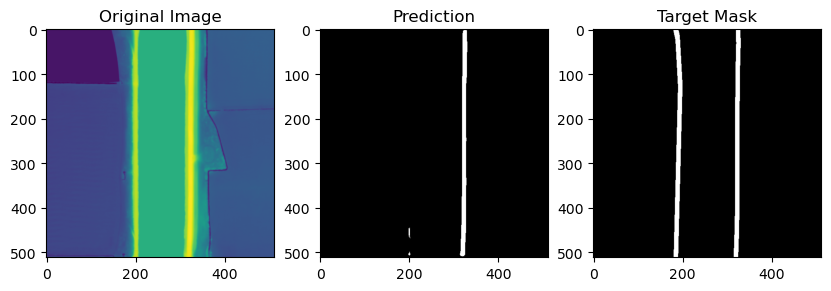

20


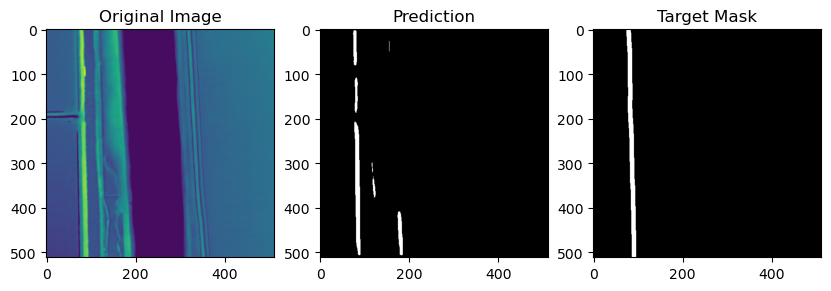

21


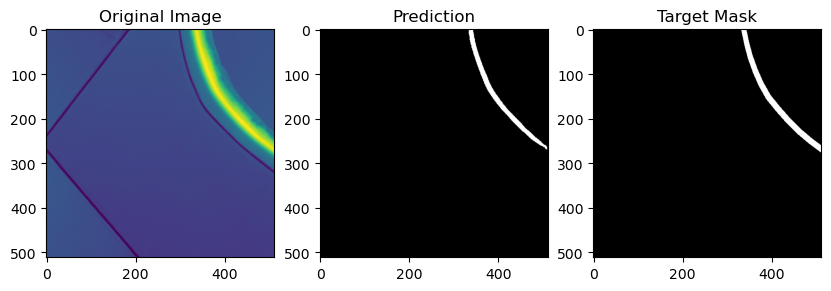

22


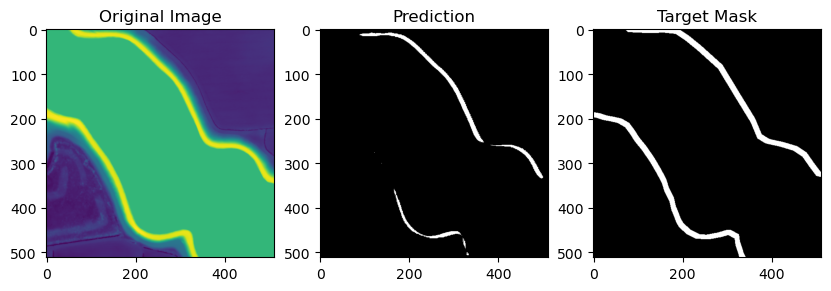

23


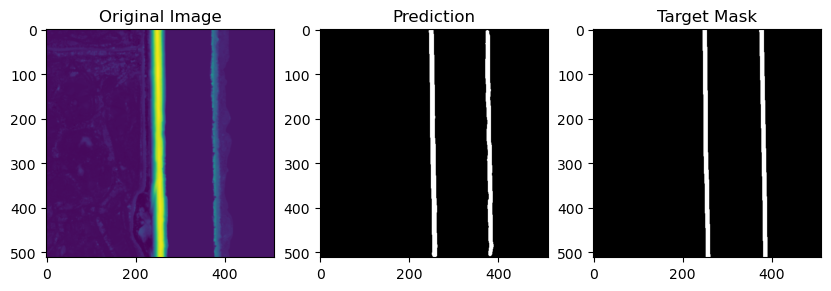

24


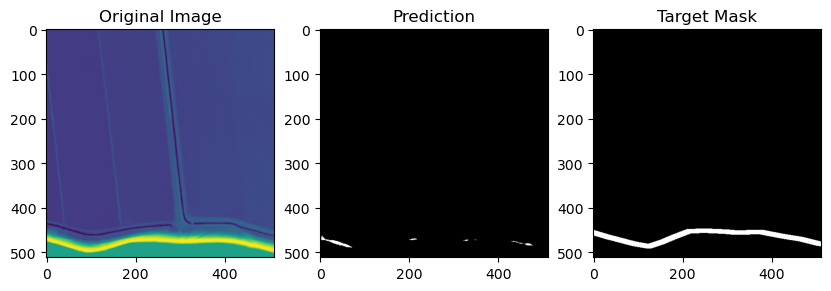

25


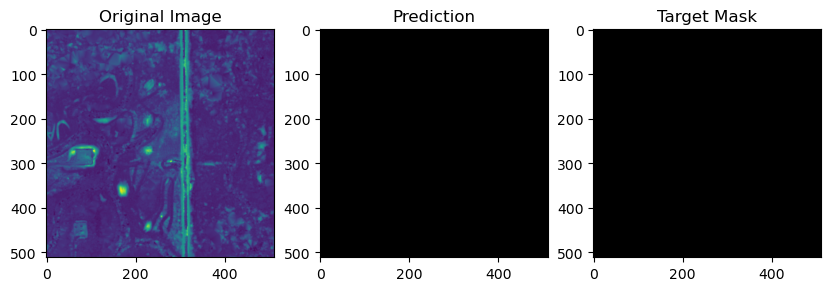

26


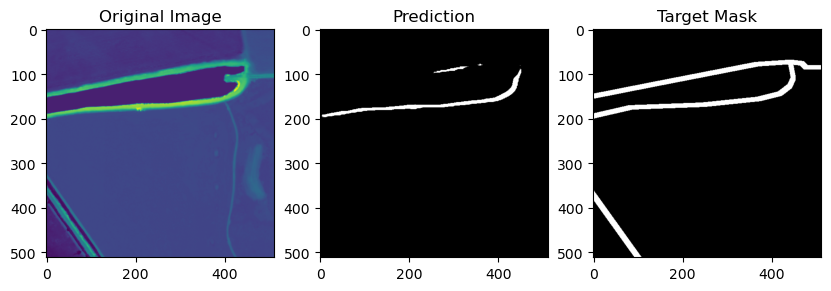

27


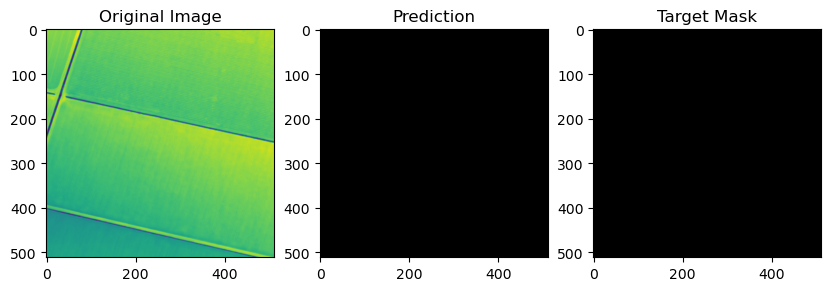

28


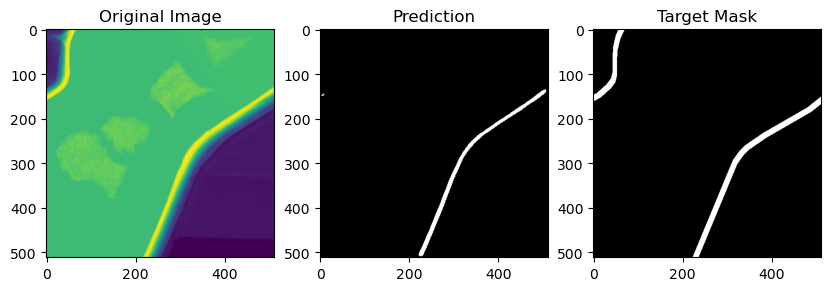

29


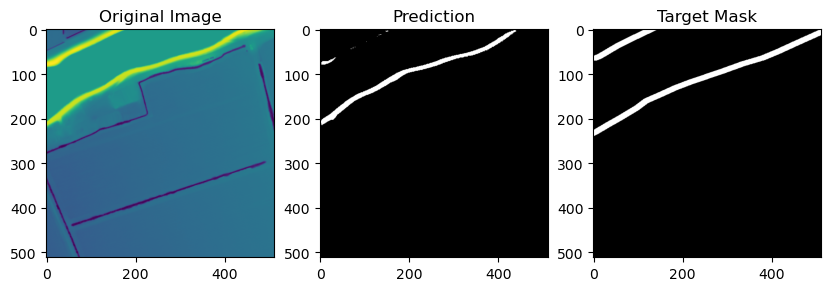

30


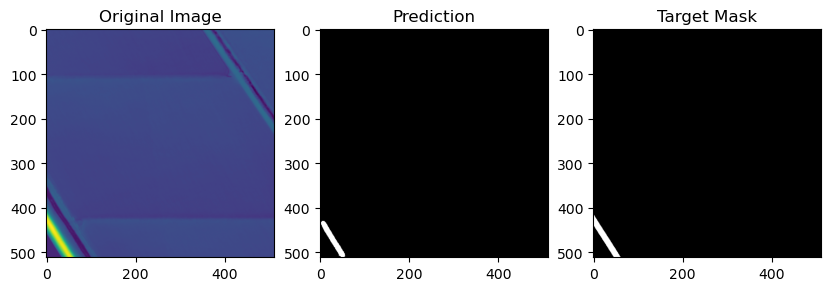

31


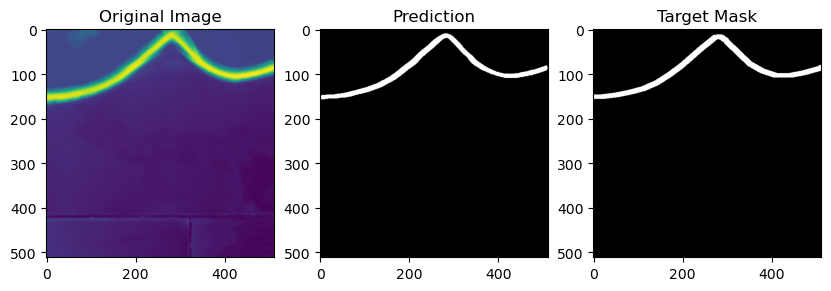

32


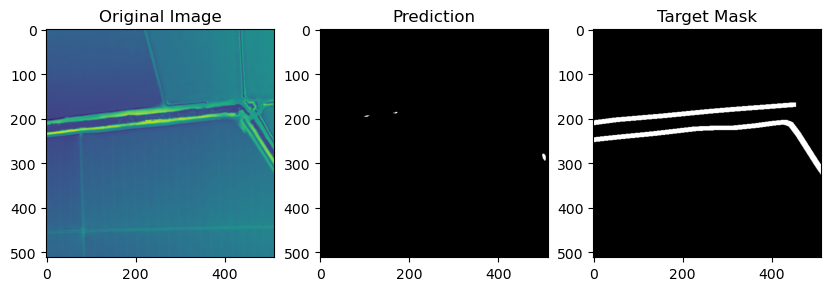

33


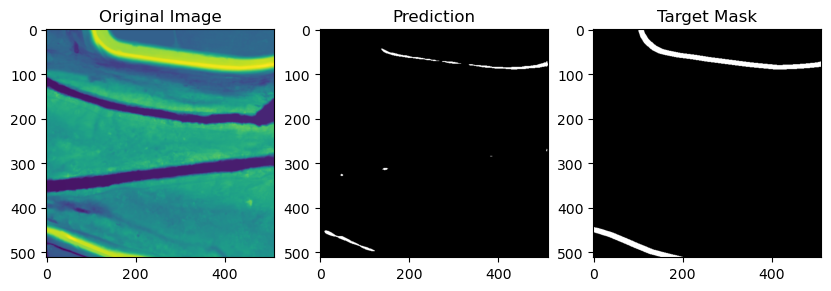

34


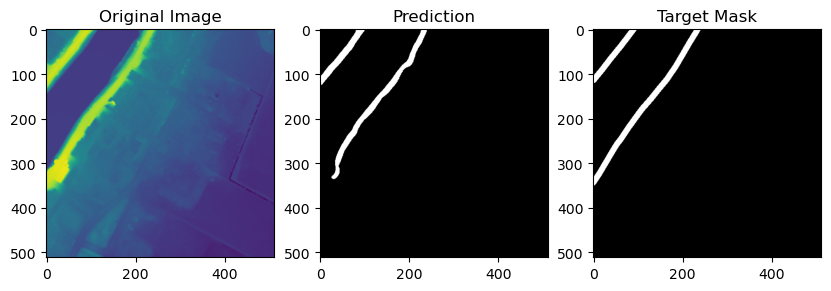

35


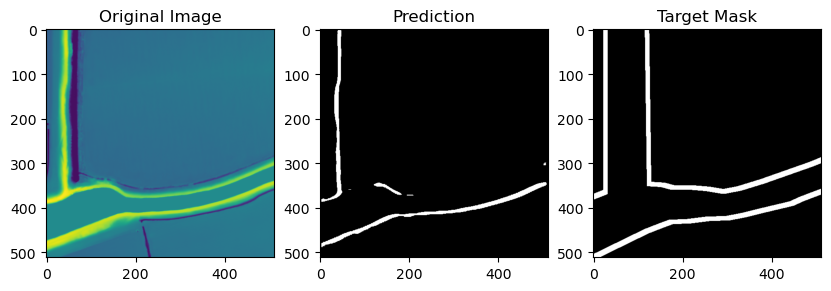

36


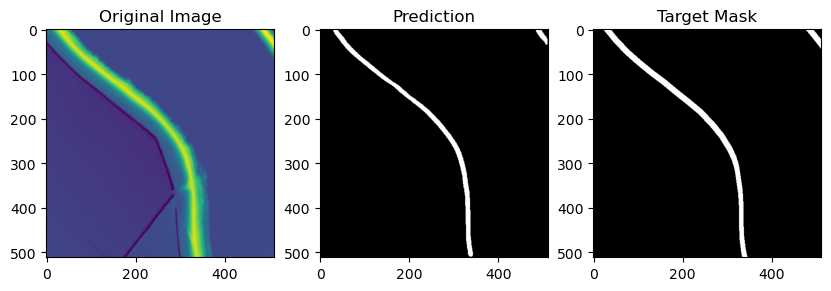

37


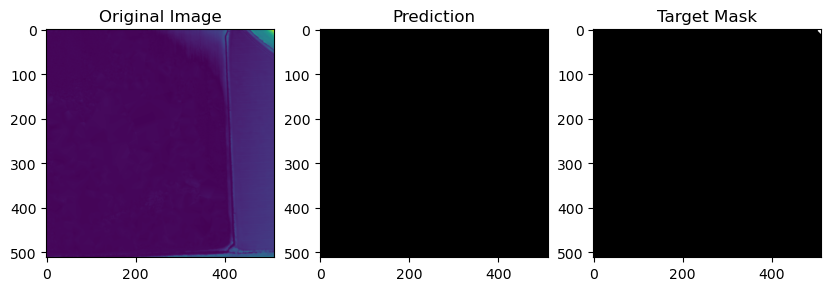

38


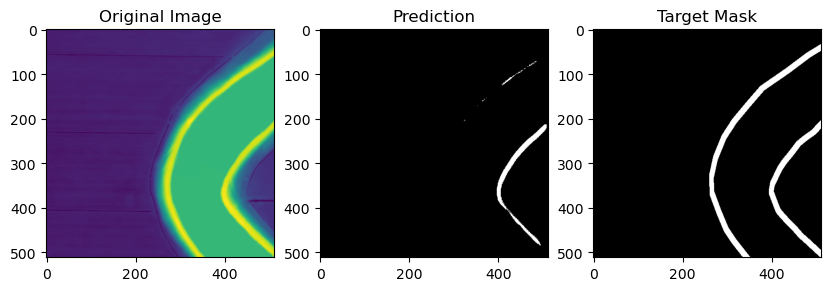

39


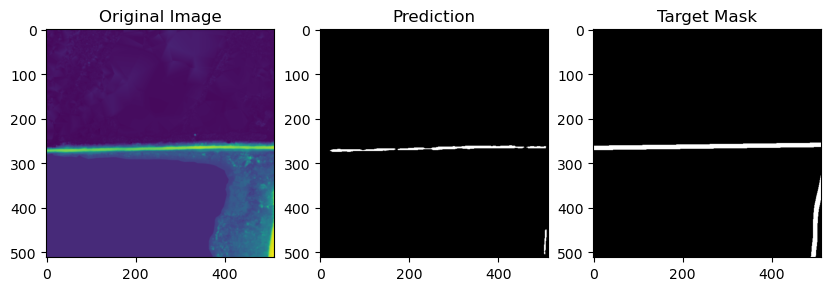

40


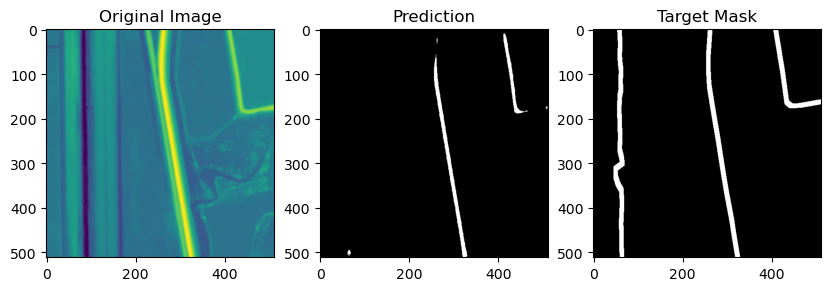

41


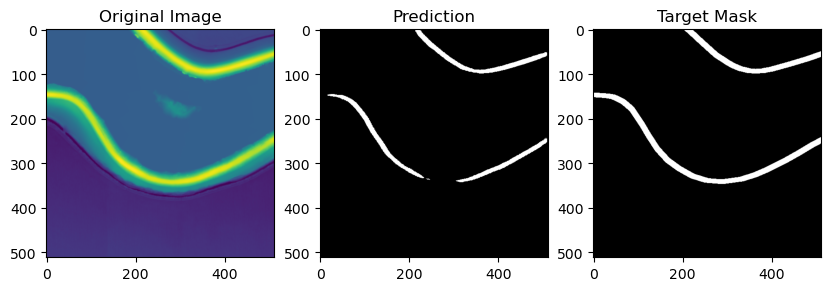

42


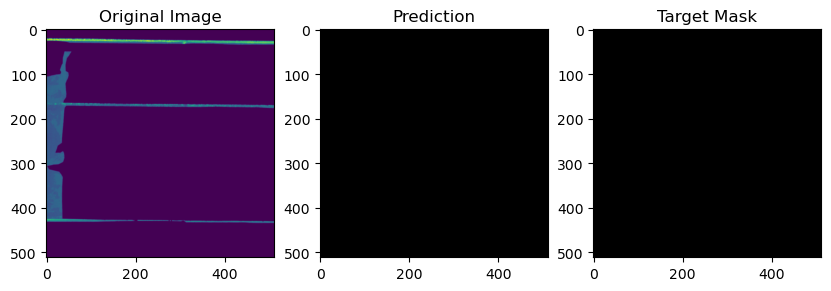

43


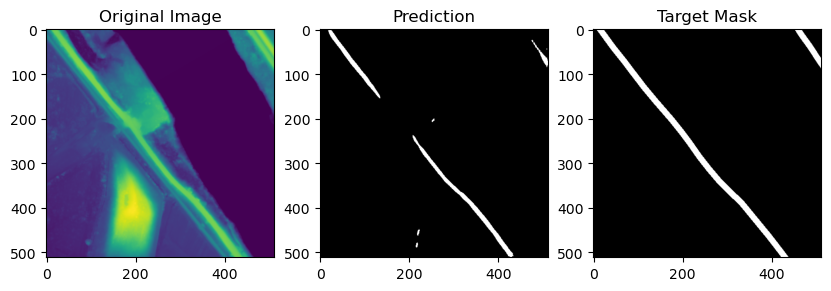

44


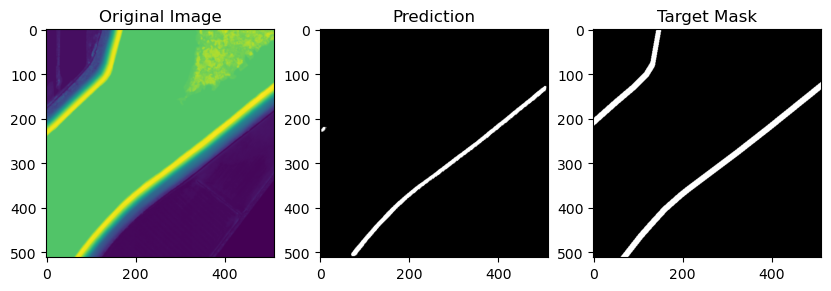

45


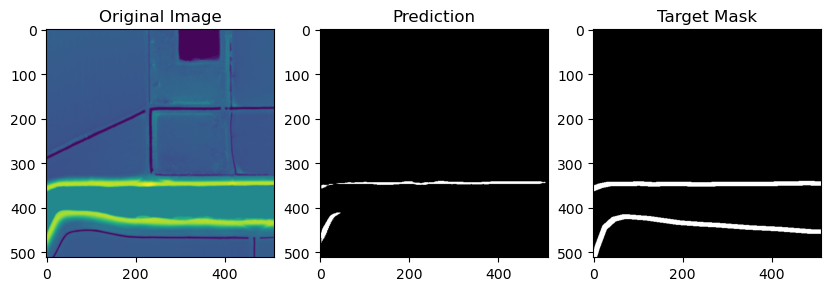

46


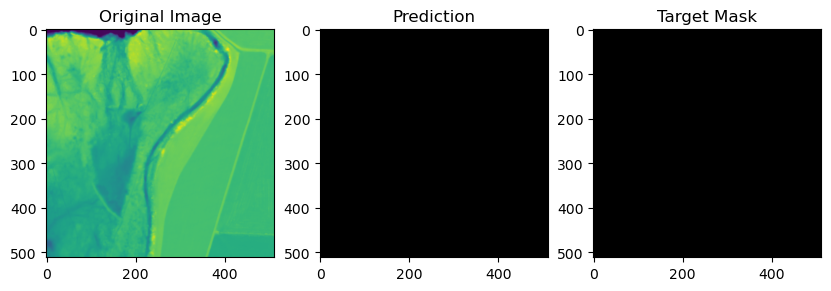

47


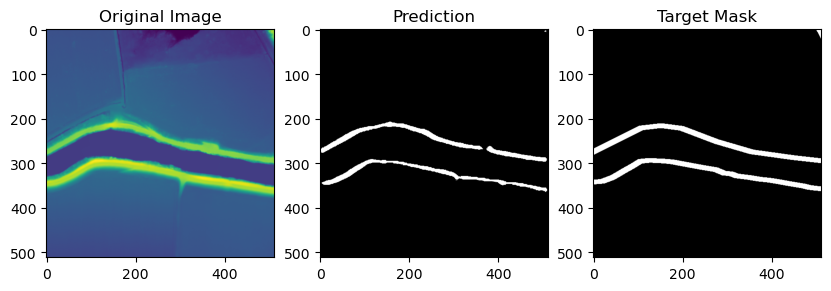

48


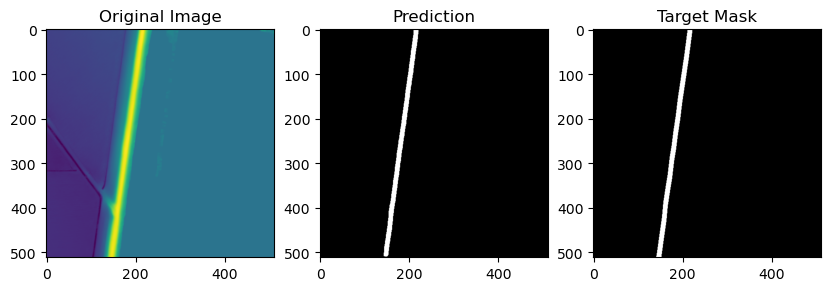

49


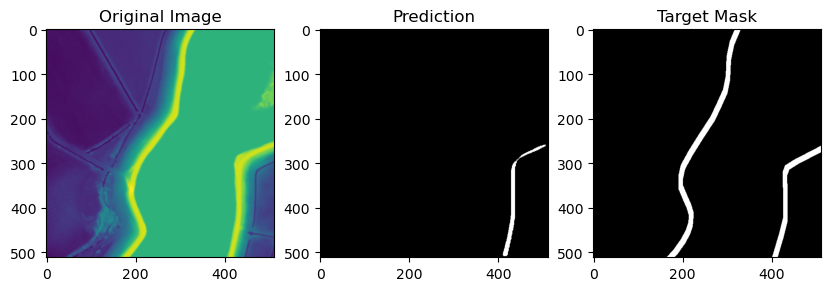

50


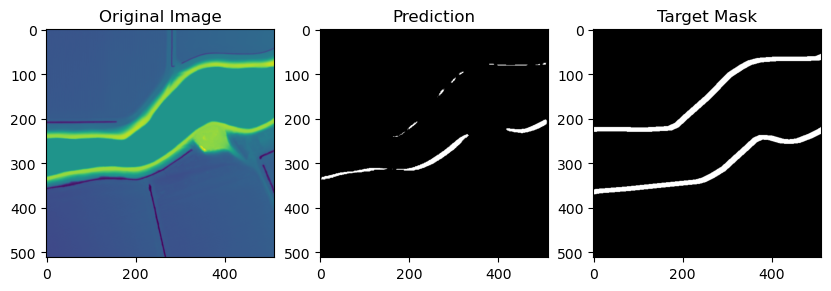

51


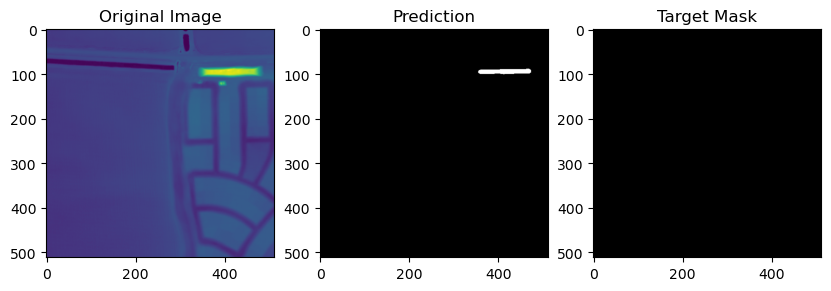

52


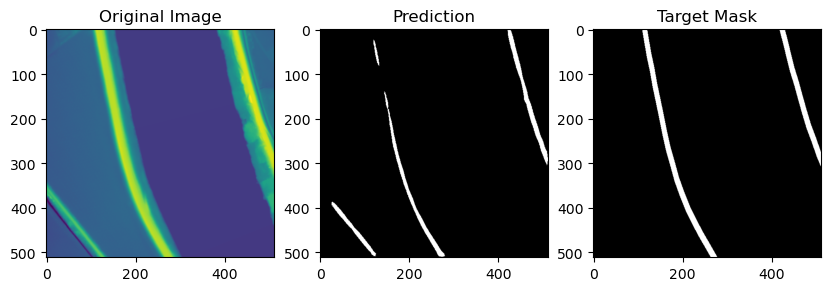

53


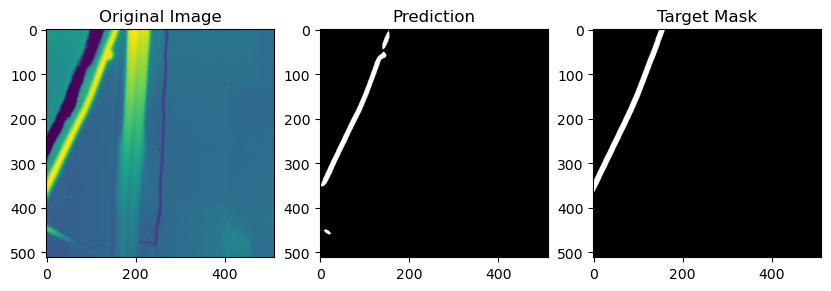

54


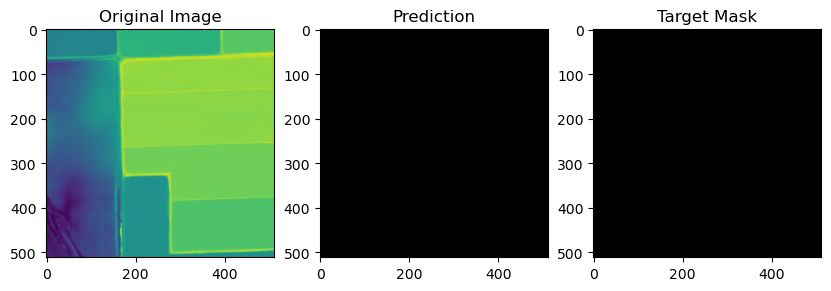

55


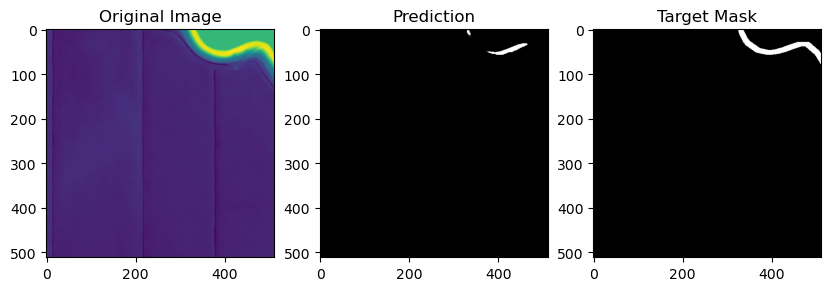

56


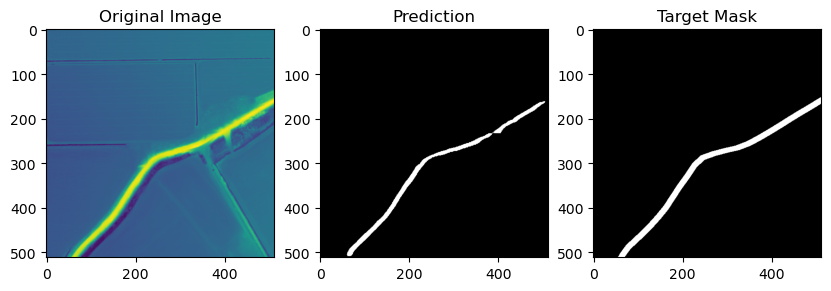

57


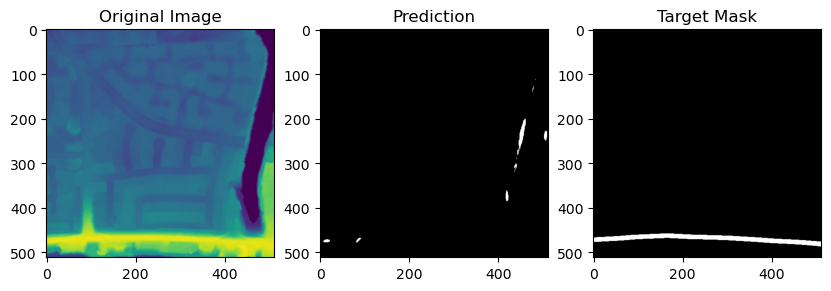

58


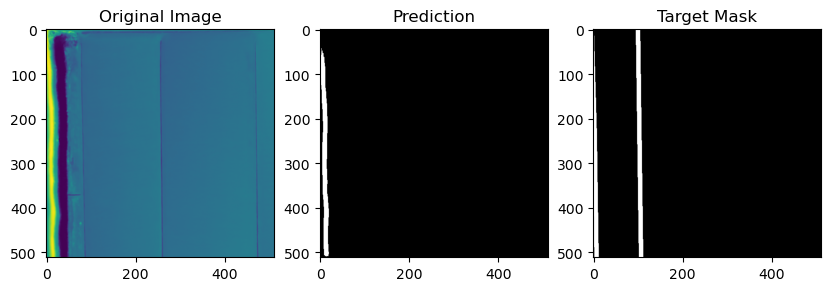

59


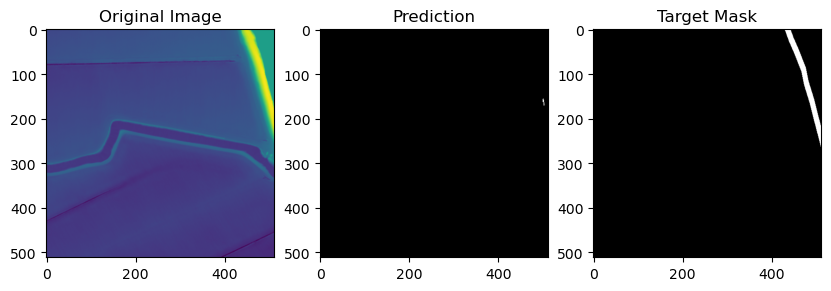

In [18]:
val_dataset.transform = normalize_only
for ix in range(60):
    sample_image, sample_mask = val_dataset[ix]
    # sample_image = sample_image.unsqueeze(0)
    print(ix)
    output = infer_and_visualize(model, sample_image, sample_mask, apply_sigmoid=True)

In [19]:
training_dataset.transform

Compose([
  HorizontalFlip(p=0.5),
  VerticalFlip(p=0.5),
  RandomRotate90(p=0.5),
  Normalize(p=1.0, mean=0.0, std=1.0, max_pixel_value=255.0, normalization='standard'),
], p=1.0, bbox_params=None, keypoint_params=None, additional_targets={}, is_check_shapes=True)

In [20]:
from levee_hunter.augmentations import train_transform

training_dataset.transform = train_transform
training_dataset.transform

Compose([
  HorizontalFlip(p=0.5),
  VerticalFlip(p=0.5),
  RandomRotate90(p=0.5),
  ShiftScaleRotate(p=0.5, shift_limit_x=(-0.0625, 0.0625), shift_limit_y=(-0.0625, 0.0625), scale_limit=(-0.09999999999999998, 0.10000000000000009), rotate_limit=(-15, 15), interpolation=1, border_mode=4, value=0.0, mask_value=0.0, rotate_method='largest_box', mask_interpolation=0),
  ElasticTransform(p=0.5, interpolation=1, border_mode=4, value=None, mask_value=None, mask_interpolation=0, alpha=1.0, sigma=50.0, approximate=False, same_dxdy=False),
  Normalize(p=1.0, mean=0.0, std=1.0, max_pixel_value=255.0, normalization='standard'),
], p=1.0, bbox_params=None, keypoint_params=None, additional_targets={}, is_check_shapes=True)

In [21]:
batch_size = 32

train_loader = DataLoader(training_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=len(val_dataset), shuffle=False)

train_loader.dataset.images[0].shape, len(train_loader.dataset.images)

((1, 512, 512), 704)

In [22]:
model = smp.Unet(
    encoder_name="resnet34", encoder_weights="imagenet", in_channels=1, classes=1
).to(device)

# Define weighted loss function
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-3)

In [23]:
training_dataset.weights_return

True

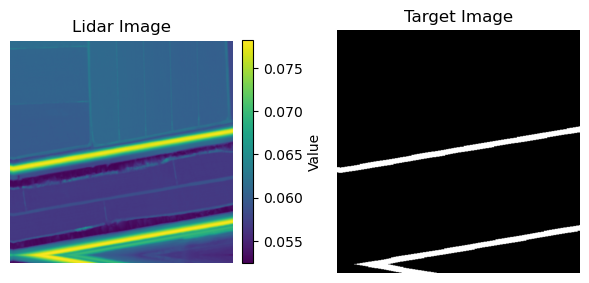

In [30]:
training_dataset.plot(idx=21, transform=True)

In [31]:
best_loss = float("inf")
epochs = 25

train_loss_list = []
val_loss_list = []

for epoch in range(epochs):
    model.train()
    train_loss = 0.0

    for batch in train_loader:
        if training_dataset.weights_return:
            images, mask, weights = batch  # Extract weights if present
            images, mask, weights = (
                images.to(device),
                mask.to(device),
                weights.to(device),
            )
        else:
            images, mask = batch
            images, mask = images.to(device), mask.to(device)
            weights = torch.ones_like(mask)  # Default weights = 1 if not provided

        optimizer.zero_grad()
        output = model(images)

        # Compute weighted loss
        # By default reduction is mean, so it would take an average over
        # all images and all pixels in the batch, returning single scalar
        # But that would make it impossible to apply weights
        # So in our case we set reduction to none, this creates an instance of
        # loss function which is then applied to output, mask, where output is actually
        # an array of outputs (batch_size, 1, H, W)
        loss = nn.BCEWithLogitsLoss(reduction="none")(
            output, mask
        )  # Compute per-element loss

        # Computing weighted loss is just computing a weighted average
        # We normally would do loss.mean() which gets an average over
        # all images in batch and all their pixels
        # Here we want to still take an average over pixels, but
        # the average over images should be weighted
        # loss.shape = (batch_size, 1, H, W), so to average over pixels
        # we can take mean with dim=(2,3) argument, this results in
        # loss.shapr = (batch_size, 1), so to multiply by weights we need to
        # reshape with .view(-1, 1). Then to get weighted average we sum the loss
        # and divide over sum of weights
        # Loss is then just a scalar for which we can then compute gradients with
        # respect to model parameters
        loss = loss.mean(
            dim=(2, 3)
        )  # Compute mean over H and W (pixel-wise mean per image)

        # Normalize by total weight sum (to match validation loss scale)
        loss = (loss * weights.view(-1, 1)).sum() / weights.sum()

        loss.backward()
        optimizer.step()
        train_loss += loss.item()

    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for batch in val_loader:
            images, mask = batch  # Validation does not use weights
            images, mask = images.to(device), mask.to(device)

            output = model(images)
            loss = nn.BCEWithLogitsLoss()(output, mask)  # Standard loss for validation

            val_loss += loss.item()

    train_loss /= len(train_loader)
    val_loss /= len(val_loader)

    train_loss_list.append(train_loss)
    val_loss_list.append(val_loss)

    print(
        f"Epoch: {epoch+1}/{epochs} Train Loss: {train_loss:.6f} Val Loss: {val_loss:.6f}"
    )

Epoch: 1/25 Train Loss: 0.572898 Val Loss: 0.561503
Epoch: 2/25 Train Loss: 0.265745 Val Loss: 0.189720
Epoch: 3/25 Train Loss: 0.172969 Val Loss: 0.142152
Epoch: 4/25 Train Loss: 0.121117 Val Loss: 0.104901
Epoch: 5/25 Train Loss: 0.089419 Val Loss: 0.080904
Epoch: 6/25 Train Loss: 0.074265 Val Loss: 0.072237
Epoch: 7/25 Train Loss: 0.065254 Val Loss: 0.068451
Epoch: 8/25 Train Loss: 0.060448 Val Loss: 0.059850
Epoch: 9/25 Train Loss: 0.055106 Val Loss: 0.055490
Epoch: 10/25 Train Loss: 0.053197 Val Loss: 0.053485
Epoch: 11/25 Train Loss: 0.050595 Val Loss: 0.051329
Epoch: 12/25 Train Loss: 0.049570 Val Loss: 0.051265
Epoch: 13/25 Train Loss: 0.046948 Val Loss: 0.050177
Epoch: 14/25 Train Loss: 0.045729 Val Loss: 0.049519
Epoch: 15/25 Train Loss: 0.044682 Val Loss: 0.051693
Epoch: 16/25 Train Loss: 0.044950 Val Loss: 0.045605
Epoch: 17/25 Train Loss: 0.043932 Val Loss: 0.046171
Epoch: 18/25 Train Loss: 0.041982 Val Loss: 0.044113
Epoch: 19/25 Train Loss: 0.041575 Val Loss: 0.044332
Ep

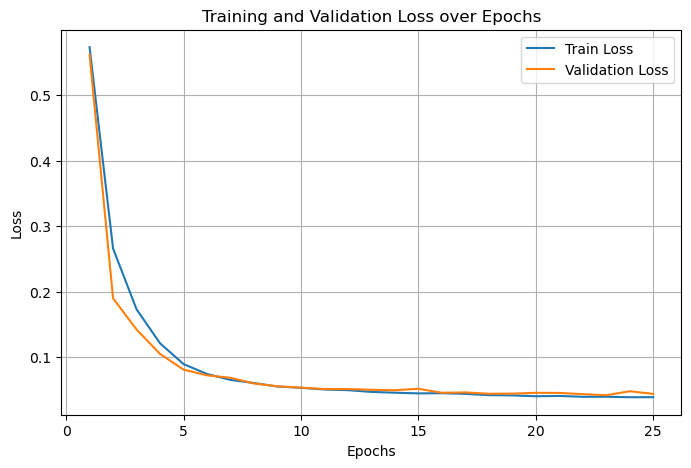

In [32]:
# Plot training and validation loss
epochs_range = range(1, len(train_loss_list) + 1)

plt.figure(figsize=(8, 5))
plt.plot(epochs_range, train_loss_list, label="Train Loss")
plt.plot(epochs_range, val_loss_list, label="Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Training and Validation Loss over Epochs")
plt.legend()
plt.grid(True)
plt.show()

In [33]:
torch.save(model.state_dict(), "../models/w4-based-models/unet-model_good2.pth")

print("Saved model at ../models/w4-based-models/unet-model_good2.pth")

Saved model at ../models/w4-based-models/unet-model_good2.pth


0


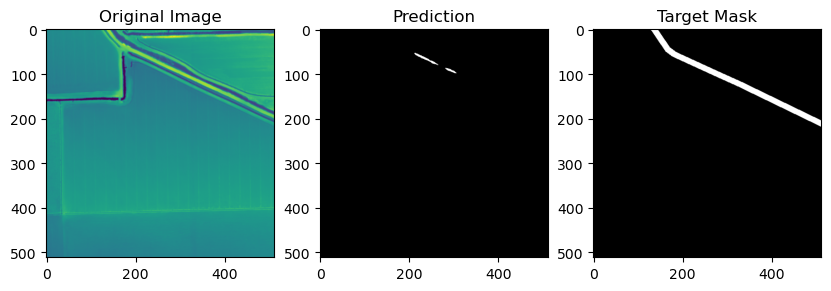

1


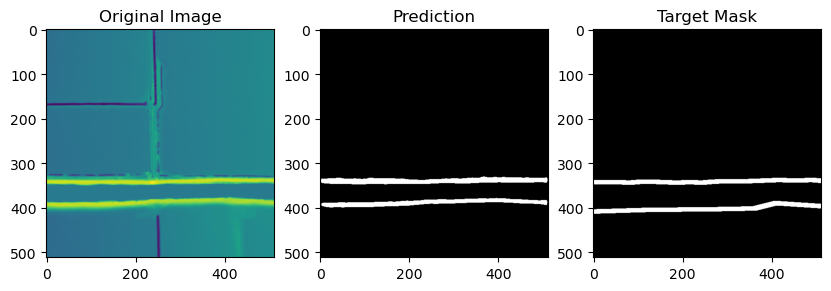

2


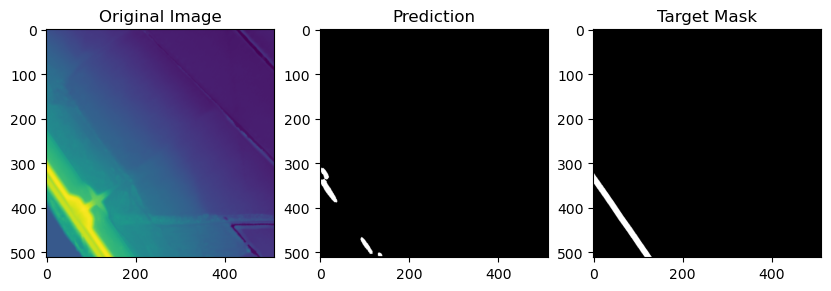

3


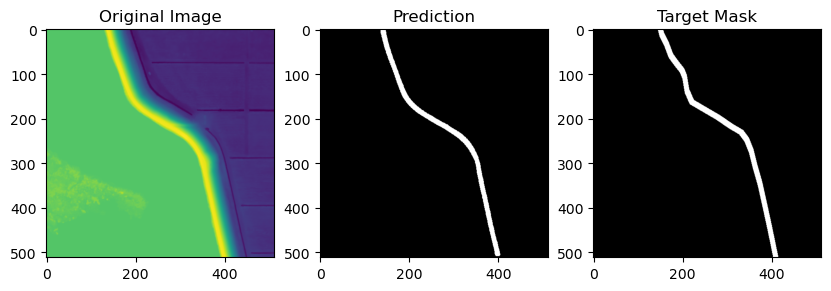

4


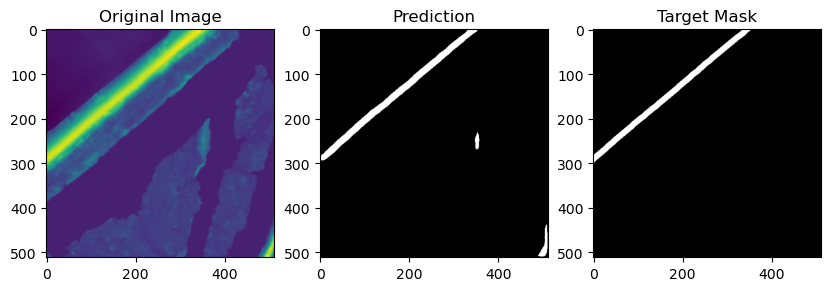

5


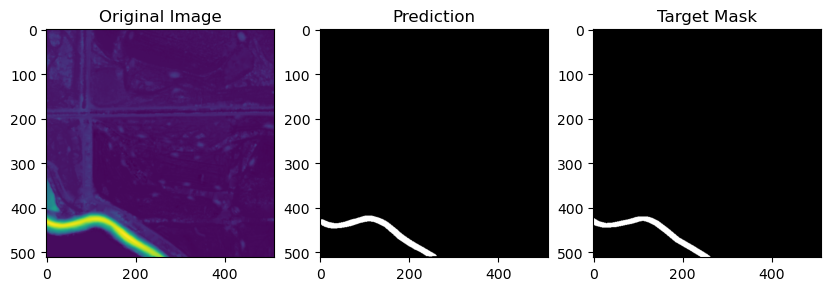

6


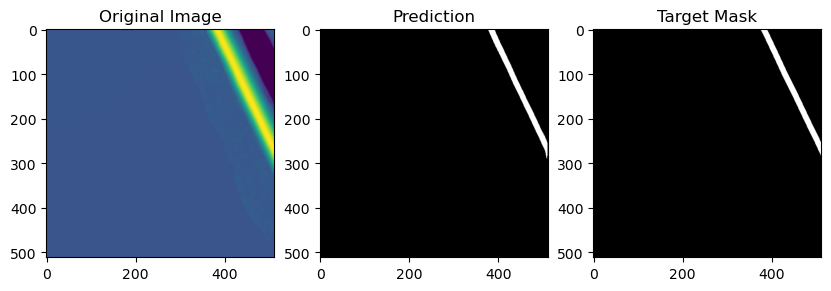

7


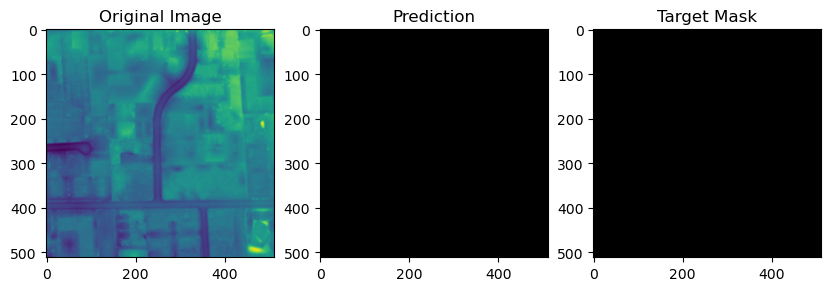

8


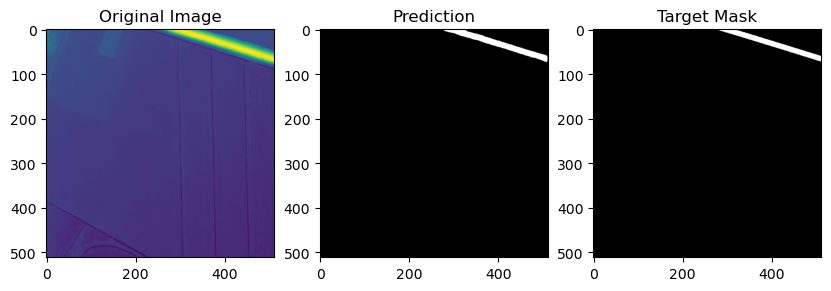

9


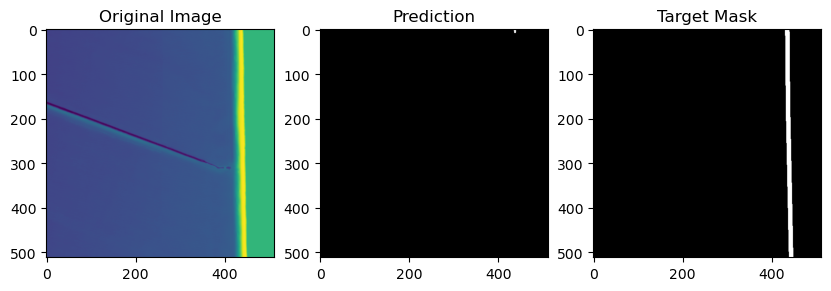

10


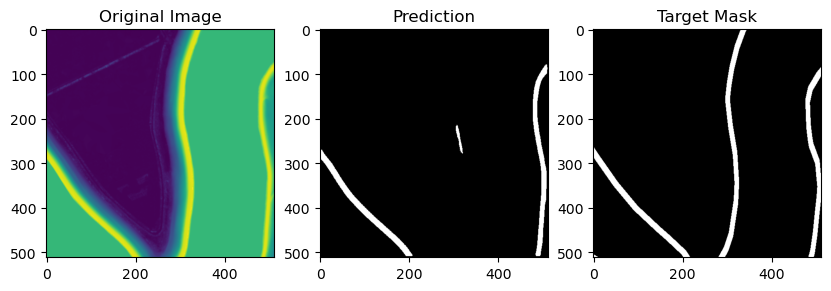

11


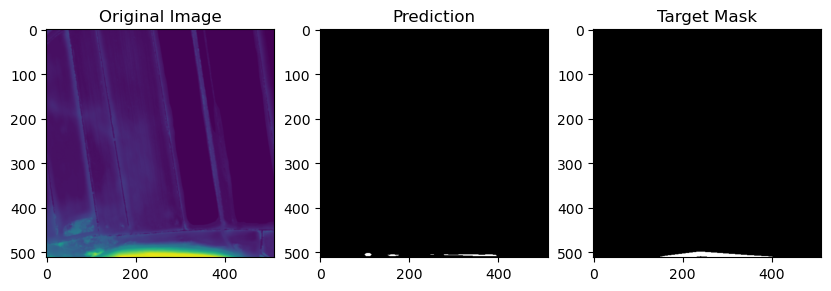

12


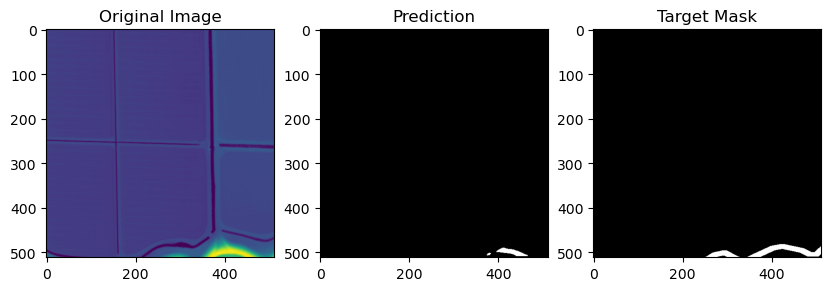

13


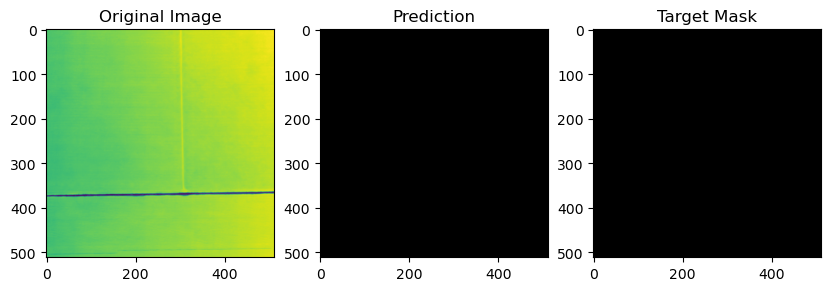

14


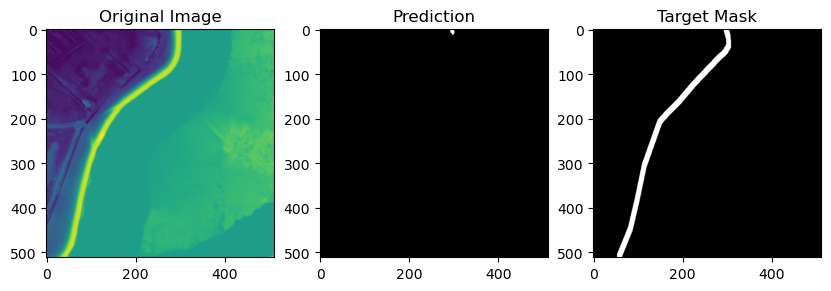

15


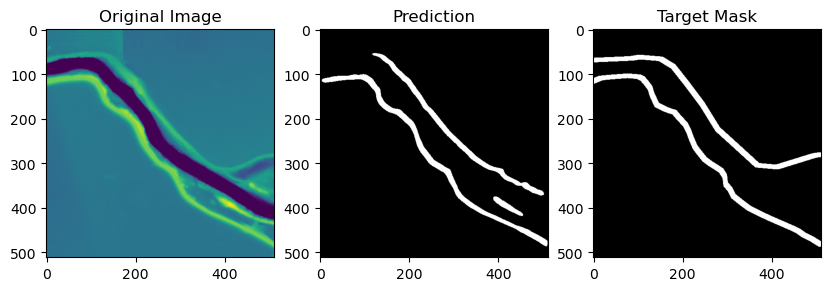

16


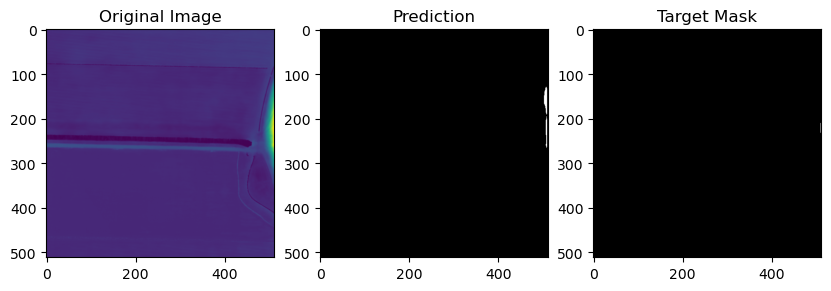

17


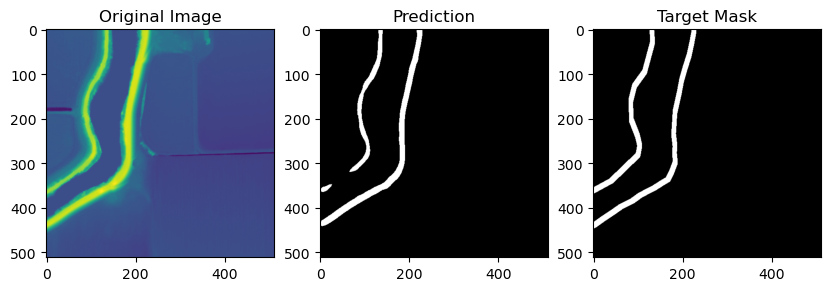

18


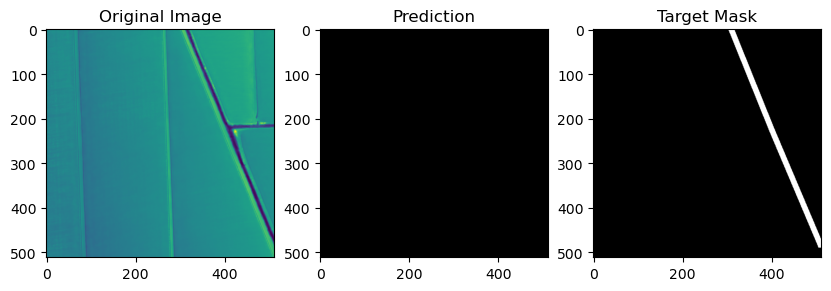

19


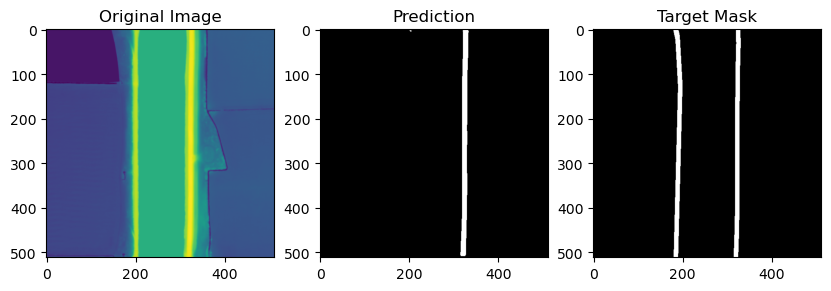

20


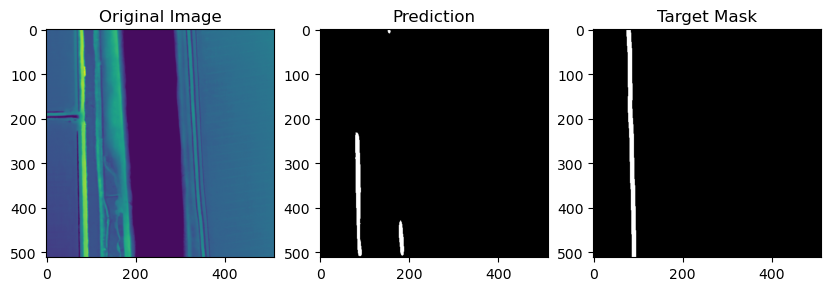

21


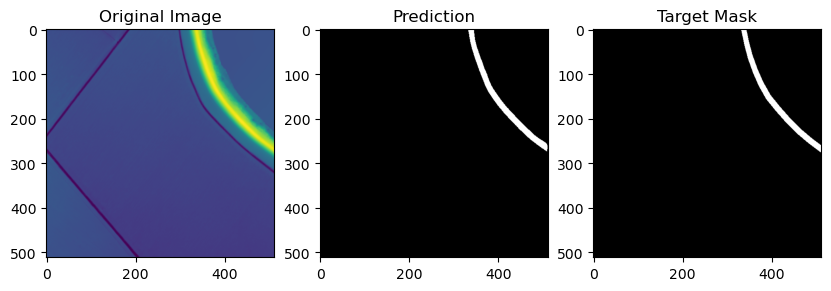

22


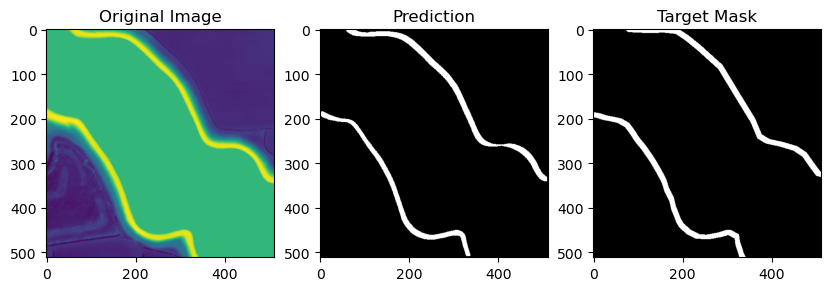

23


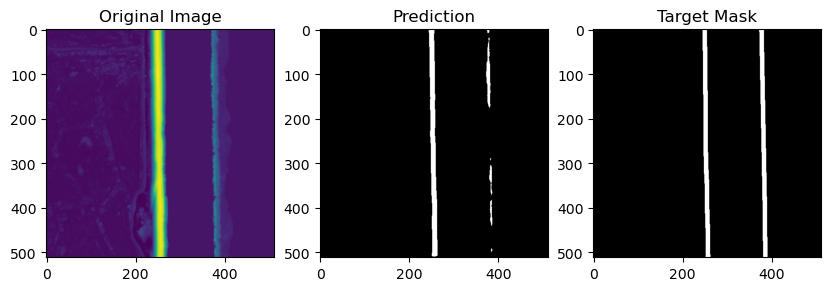

24


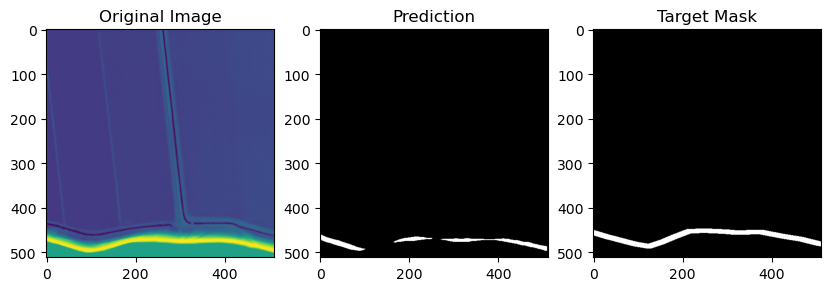

25


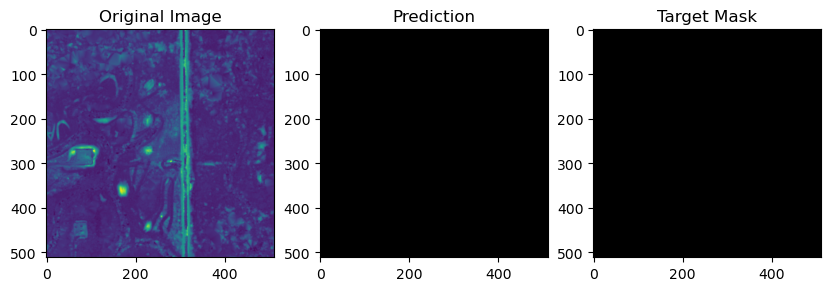

26


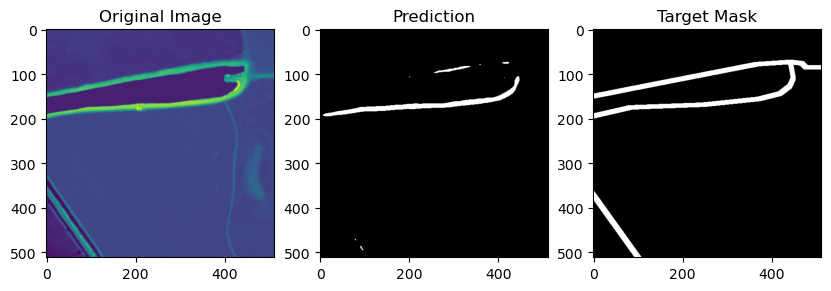

27


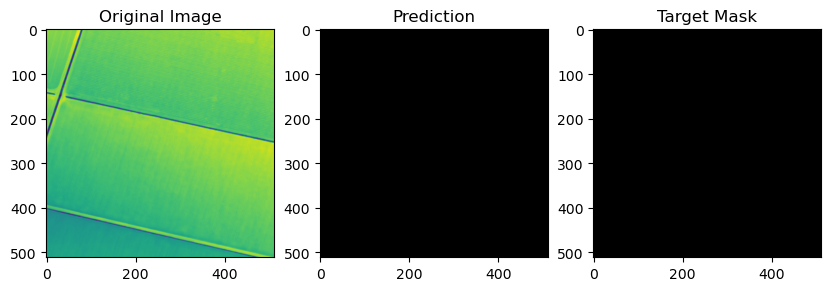

28


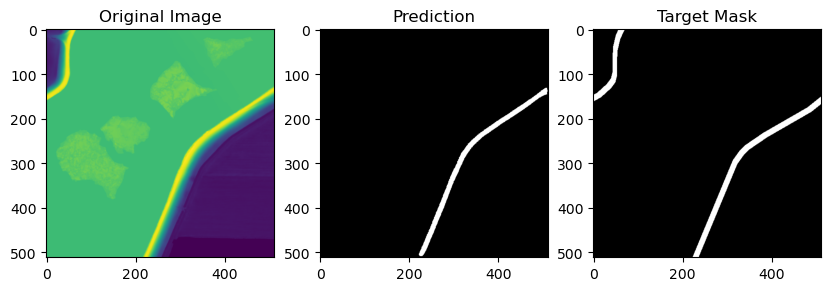

29


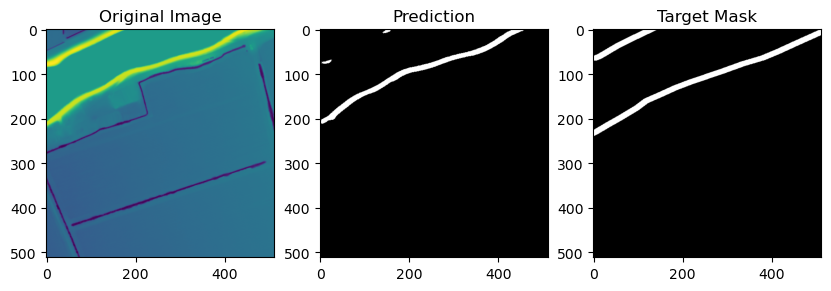

30


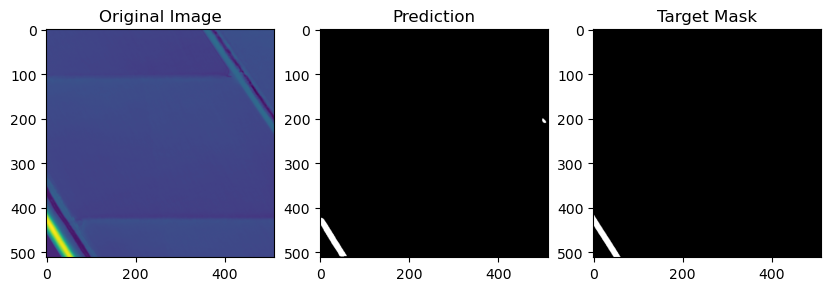

31


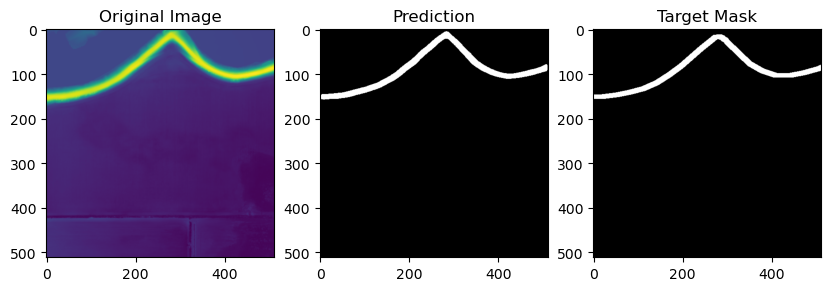

32


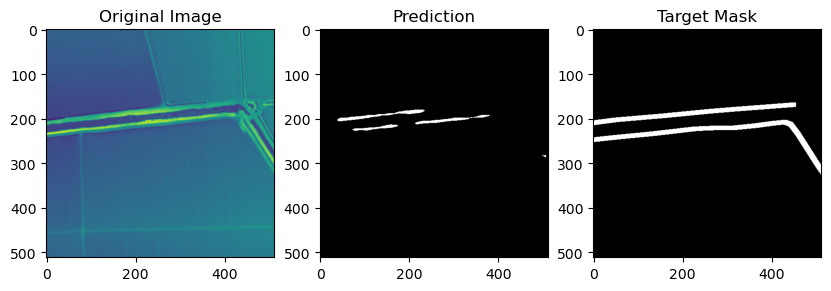

33


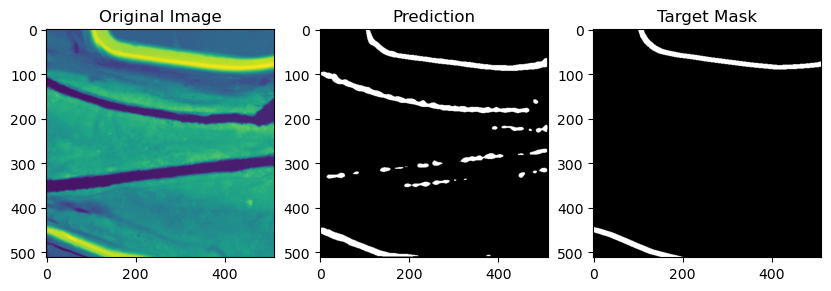

34


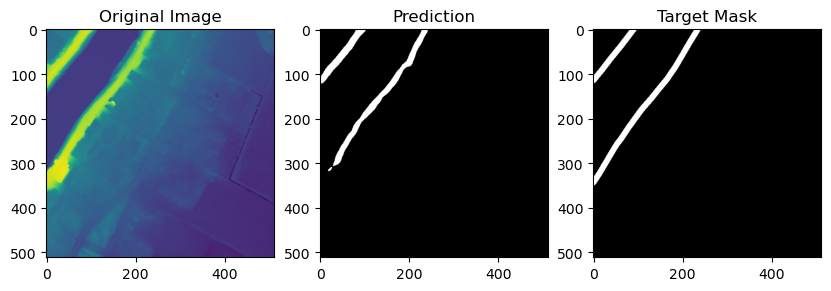

35


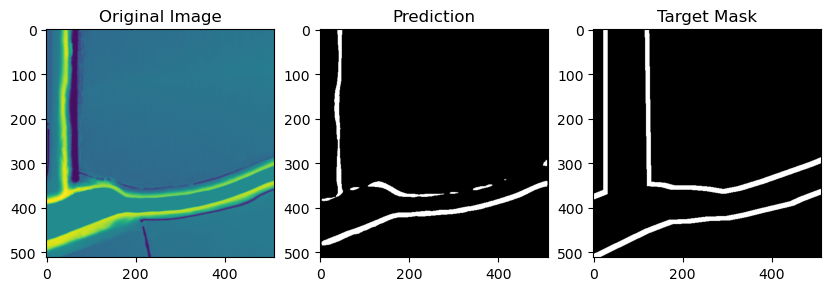

36


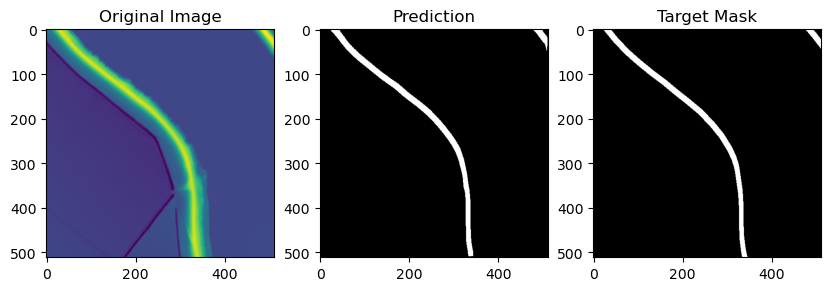

37


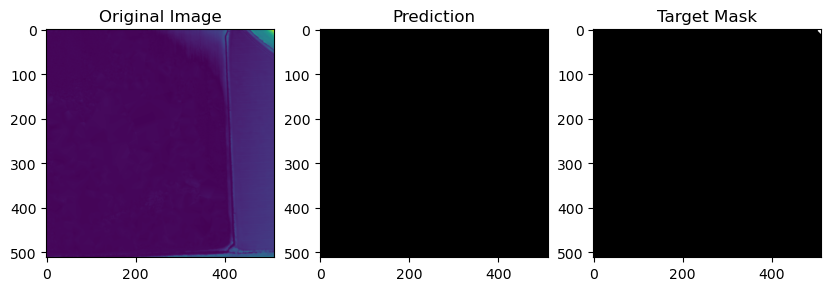

38


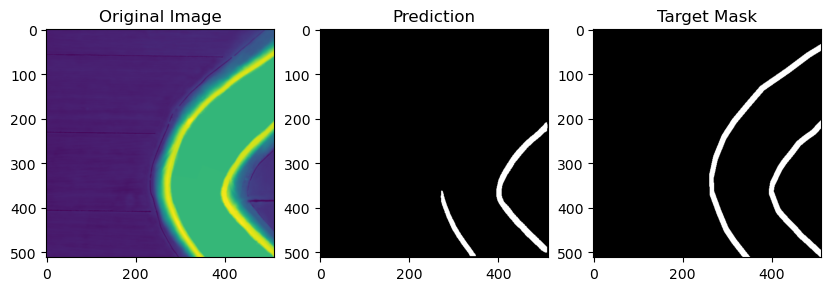

39


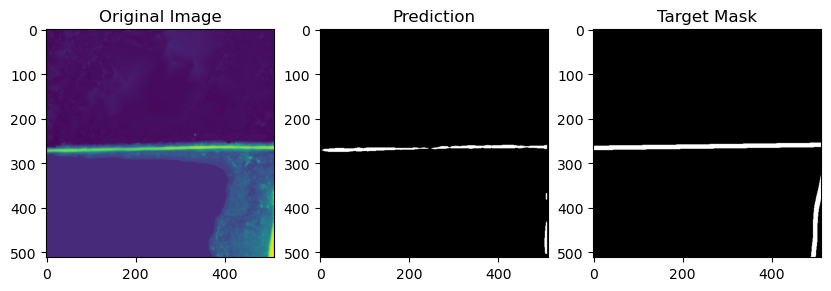

40


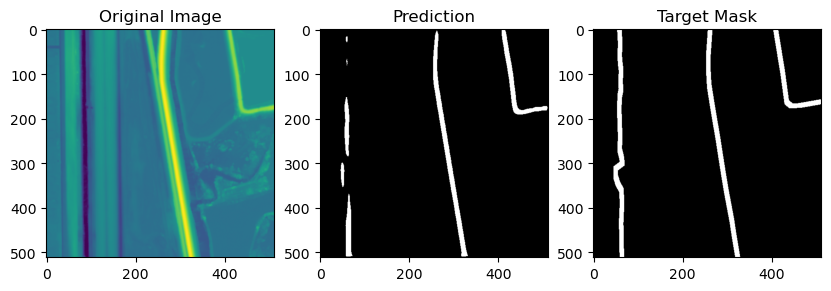

41


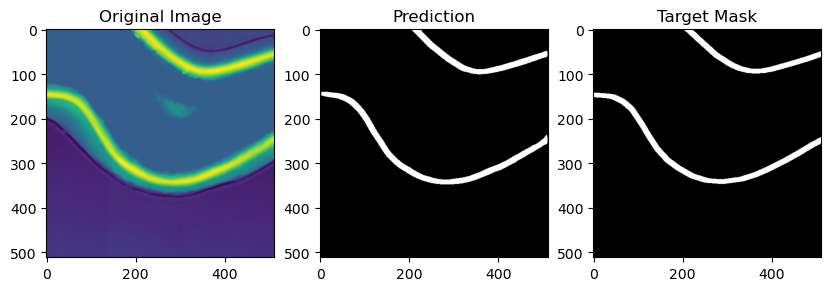

42


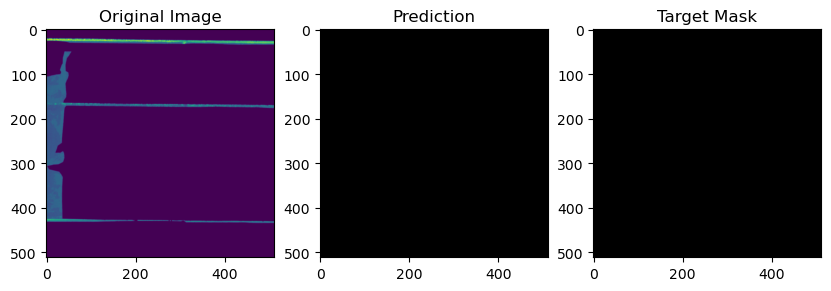

43


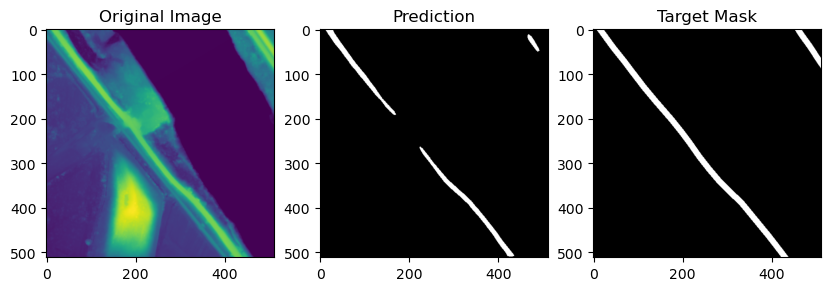

44


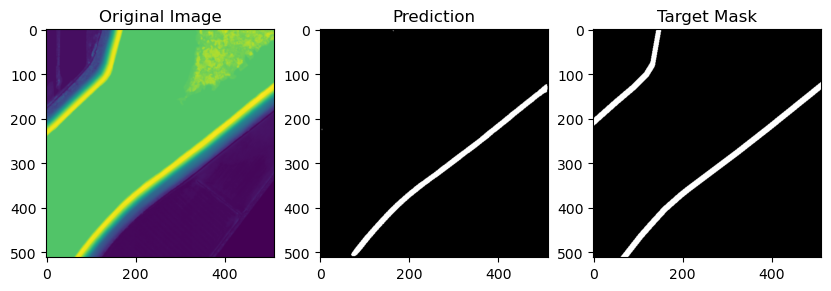

45


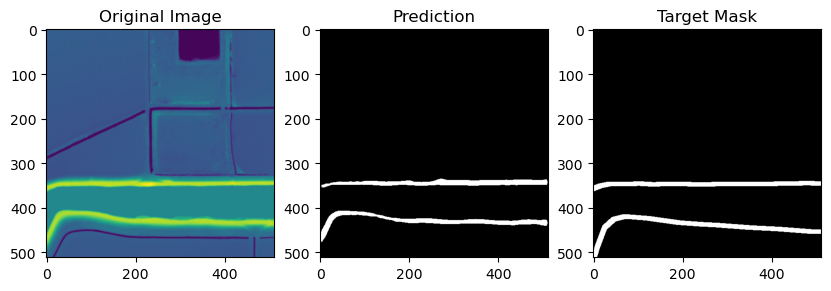

46


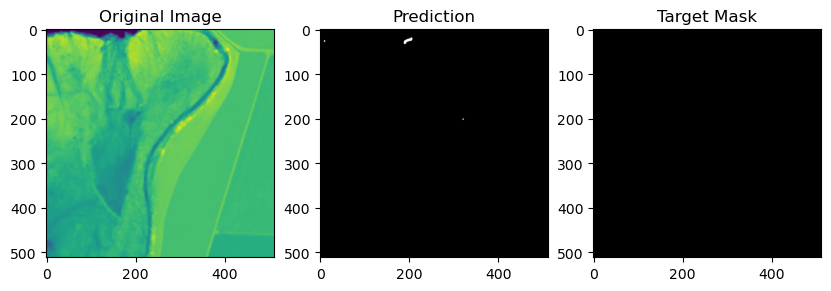

47


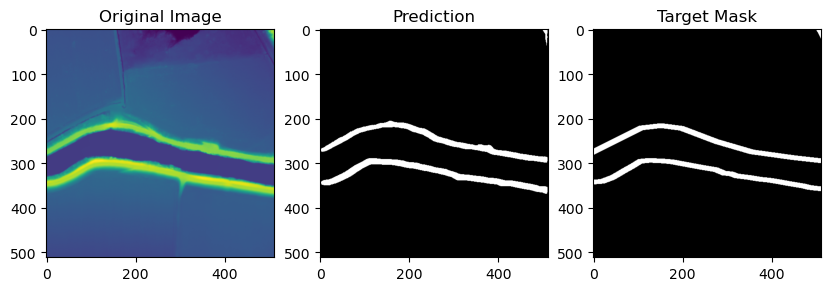

48


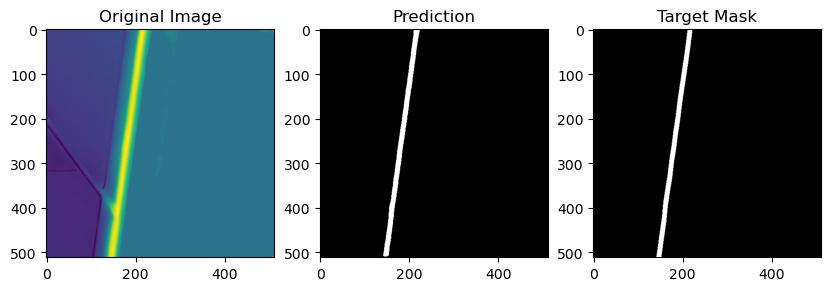

49


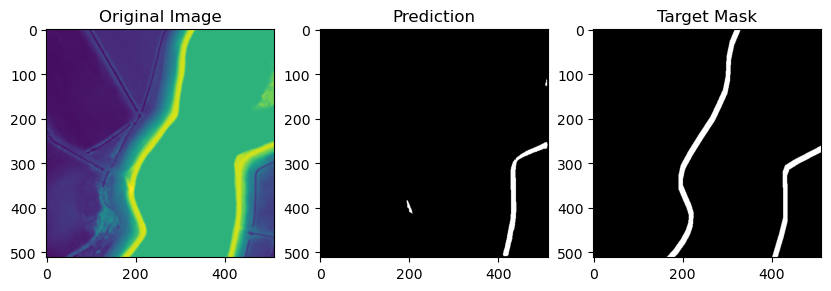

50


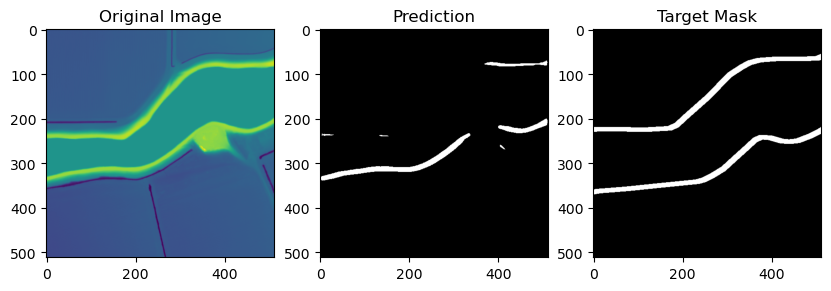

51


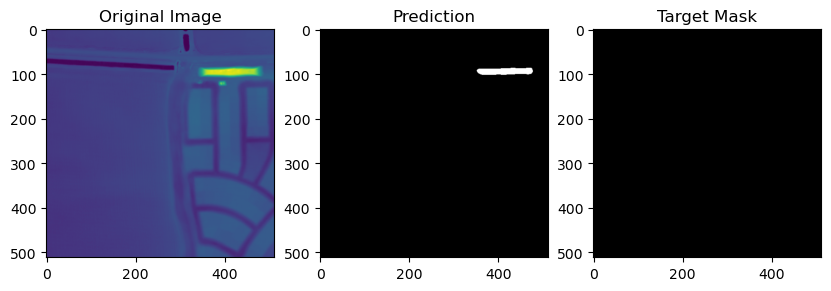

52


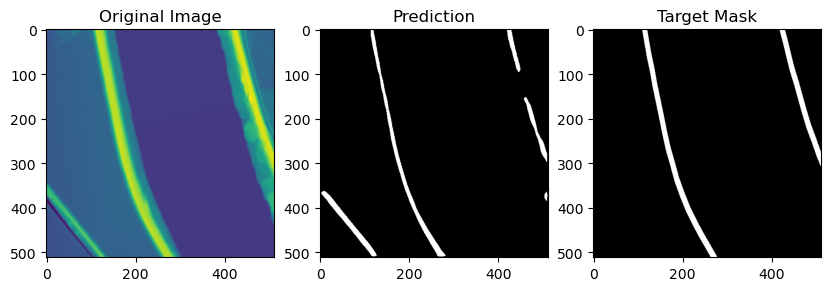

53


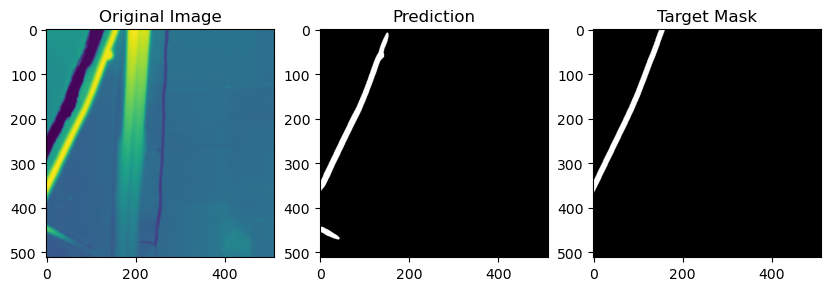

54


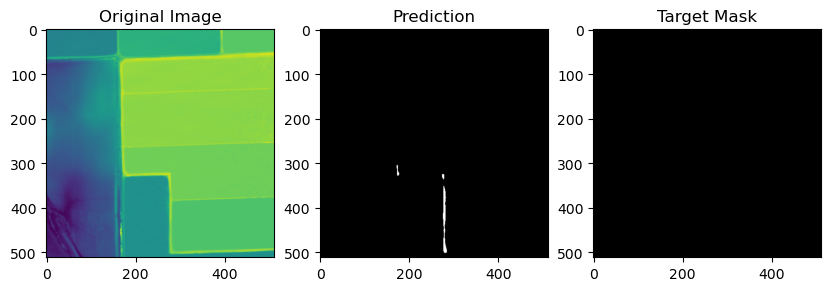

55


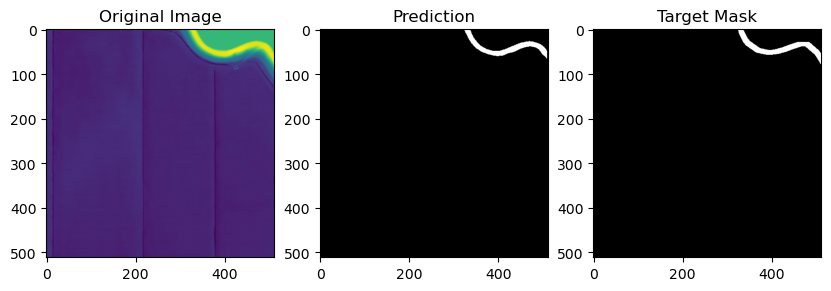

56


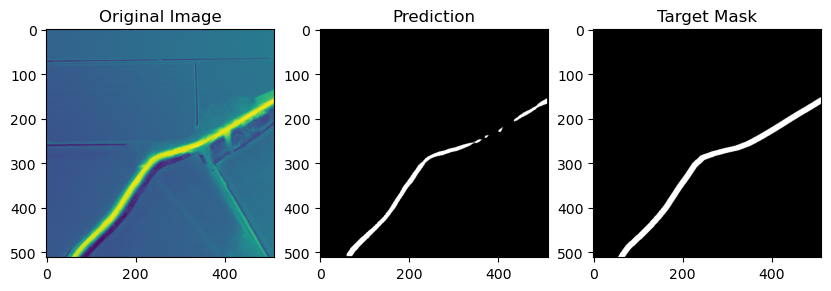

57


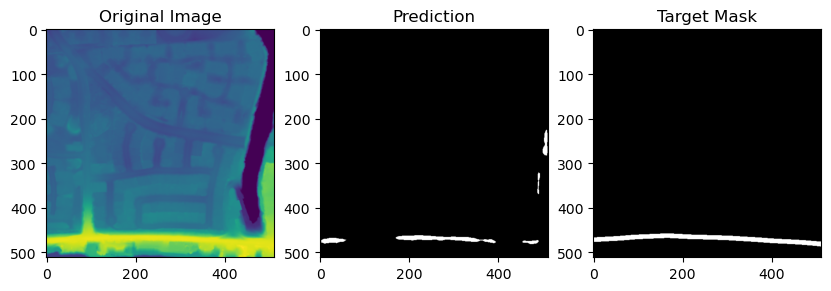

58


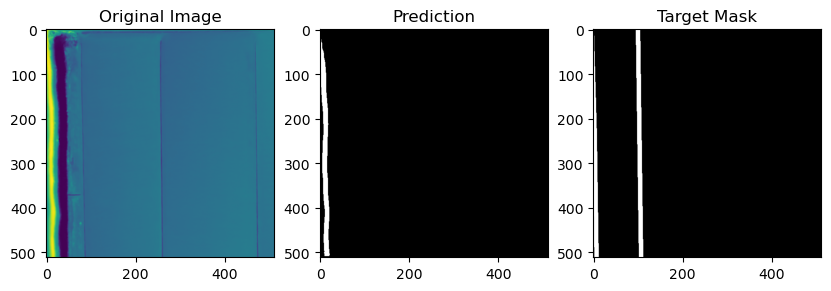

59


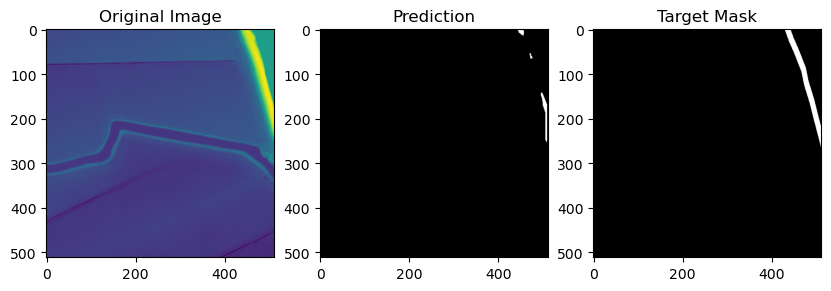

In [34]:
for ix in range(60):
    sample_image, sample_mask = val_dataset[ix]
    # sample_image = sample_image.unsqueeze(0)
    print(ix)
    output = infer_and_visualize(model, sample_image, sample_mask, apply_sigmoid=True)

In [35]:
torch.save(
    training_dataset, "../data/processed/w3-4-based-datasets/train_dataset_1m_512.pth"
)
torch.save(val_dataset, "../data/processed/w3-4-based-datasets/val_dataset_1m_512.pth")

# DeepLabV3

In [37]:
model = smp.DeepLabV3Plus(
    encoder_name="resnet34",  # Choose backbone
    encoder_weights="imagenet",  # Use pre-trained weights
    in_channels=1,  # Your data has 1 channel (grayscale)
    classes=1,  # Output is 1 class (binary segmentation)
).to(device)

optimizer = optim.Adam(model.parameters(), lr=2e-3)

In [38]:
best_loss = float("inf")
epochs = 25

train_loss_list = []
val_loss_list = []

for epoch in range(epochs):
    model.train()
    train_loss = 0.0

    for batch in train_loader:
        if training_dataset.weights_return:
            images, mask, weights = batch  # Extract weights if present
            images, mask, weights = (
                images.to(device),
                mask.to(device),
                weights.to(device),
            )
        else:
            images, mask = batch
            images, mask = images.to(device), mask.to(device)
            weights = torch.ones_like(mask)  # Default weights = 1 if not provided

        optimizer.zero_grad()
        output = model(images)

        # Compute weighted loss
        # By default reduction is mean, so it would take an average over
        # all images and all pixels in the batch, returning single scalar
        # But that would make it impossible to apply weights
        # So in our case we set reduction to none, this creates an instance of
        # loss function which is then applied to output, mask, where output is actually
        # an array of outputs (batch_size, 1, H, W)
        loss = nn.BCEWithLogitsLoss(reduction="none")(
            output, mask
        )  # Compute per-element loss

        # Computing weighted loss is just computing a weighted average
        # We normally would do loss.mean() which gets an average over
        # all images in batch and all their pixels
        # Here we want to still take an average over pixels, but
        # the average over images should be weighted
        # loss.shape = (batch_size, 1, H, W), so to average over pixels
        # we can take mean with dim=(2,3) argument, this results in
        # loss.shapr = (batch_size, 1), so to multiply by weights we need to
        # reshape with .view(-1, 1). Then to get weighted average we sum the loss
        # and divide over sum of weights
        # Loss is then just a scalar for which we can then compute gradients with
        # respect to model parameters
        loss = loss.mean(
            dim=(2, 3)
        )  # Compute mean over H and W (pixel-wise mean per image)

        # Normalize by total weight sum (to match validation loss scale)
        loss = (loss * weights.view(-1, 1)).sum() / weights.sum()

        loss.backward()
        optimizer.step()
        train_loss += loss.item()

    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for batch in val_loader:
            images, mask = batch  # Validation does not use weights
            images, mask = images.to(device), mask.to(device)

            output = model(images)
            loss = nn.BCEWithLogitsLoss()(output, mask)  # Standard loss for validation

            val_loss += loss.item()

    train_loss /= len(train_loader)
    val_loss /= len(val_loader)

    train_loss_list.append(train_loss)
    val_loss_list.append(val_loss)

    print(
        f"Epoch: {epoch+1}/{epochs} Train Loss: {train_loss:.6f} Val Loss: {val_loss:.6f}"
    )

Epoch: 1/25 Train Loss: 0.186716 Val Loss: 0.474910
Epoch: 2/25 Train Loss: 0.054053 Val Loss: 0.144992
Epoch: 3/25 Train Loss: 0.050184 Val Loss: 0.092876
Epoch: 4/25 Train Loss: 0.048382 Val Loss: 0.053032
Epoch: 5/25 Train Loss: 0.046799 Val Loss: 0.051410
Epoch: 6/25 Train Loss: 0.045869 Val Loss: 0.050071
Epoch: 7/25 Train Loss: 0.045633 Val Loss: 0.047408
Epoch: 8/25 Train Loss: 0.045356 Val Loss: 0.048421
Epoch: 9/25 Train Loss: 0.044239 Val Loss: 0.048858
Epoch: 10/25 Train Loss: 0.043766 Val Loss: 0.047998
Epoch: 11/25 Train Loss: 0.044332 Val Loss: 0.047440
Epoch: 12/25 Train Loss: 0.042251 Val Loss: 0.046277
Epoch: 13/25 Train Loss: 0.042748 Val Loss: 0.046261
Epoch: 14/25 Train Loss: 0.041757 Val Loss: 0.047092
Epoch: 15/25 Train Loss: 0.041743 Val Loss: 0.047318
Epoch: 16/25 Train Loss: 0.042276 Val Loss: 0.045328
Epoch: 17/25 Train Loss: 0.041474 Val Loss: 0.044455
Epoch: 18/25 Train Loss: 0.041149 Val Loss: 0.046610
Epoch: 19/25 Train Loss: 0.040127 Val Loss: 0.044800
Ep

In [39]:
def plot_training_validation_loss(train_loss_list, val_loss_list):
    # Plot training and validation loss
    epochs_range = range(1, len(train_loss_list) + 1)

    plt.figure(figsize=(8, 5))
    plt.plot(epochs_range, train_loss_list, label="Train Loss")
    plt.plot(epochs_range, val_loss_list, label="Validation Loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss over Epochs")
    plt.legend()
    plt.grid(True)
    plt.show()

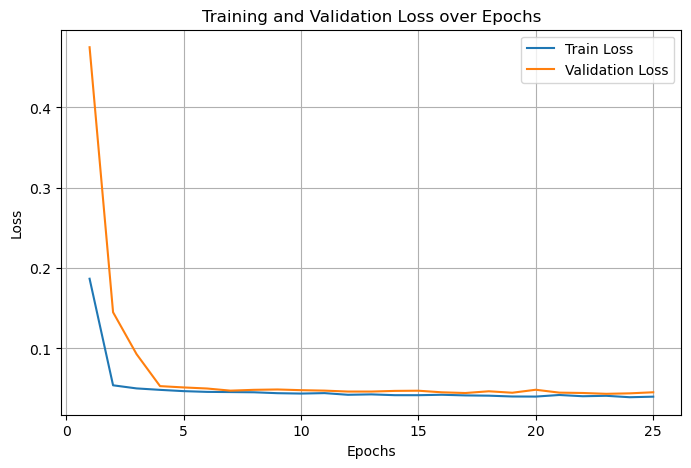

In [40]:
plot_training_validation_loss(train_loss_list, val_loss_list)

0


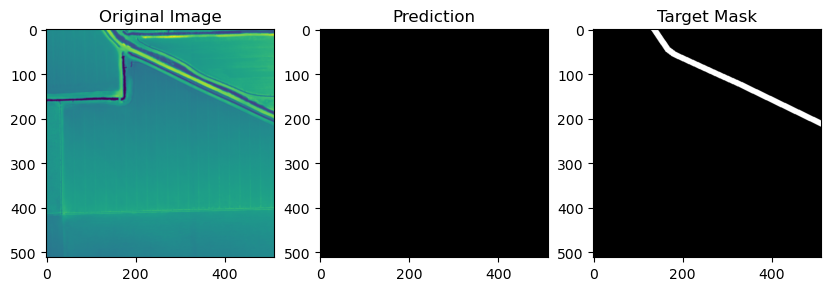

1


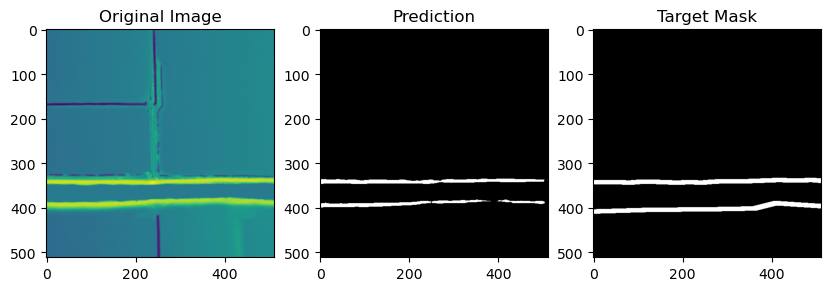

2


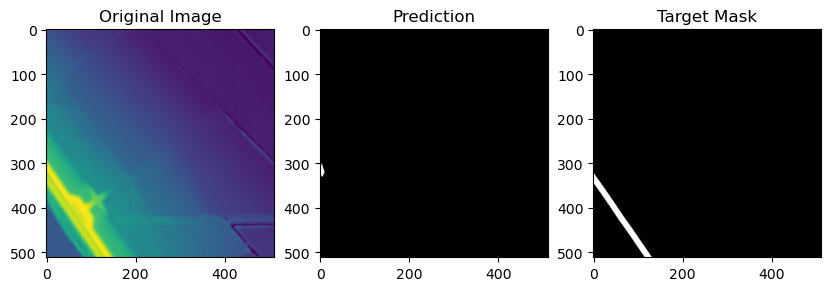

3


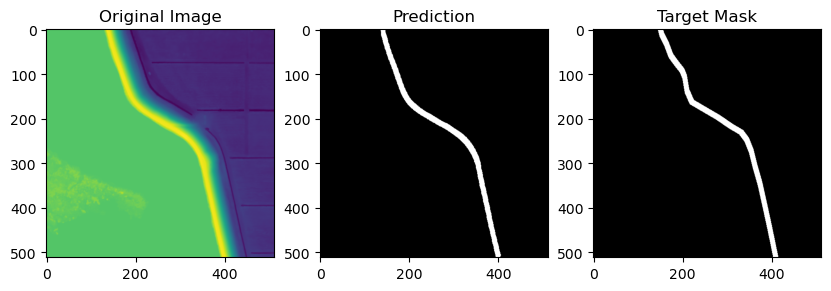

4


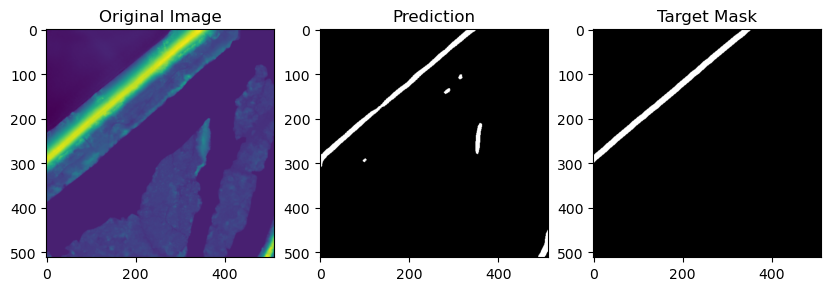

5


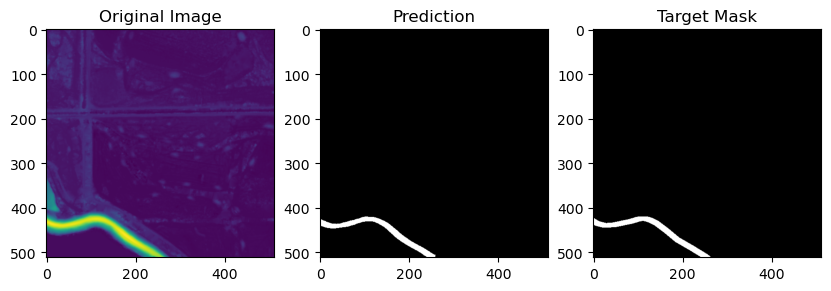

6


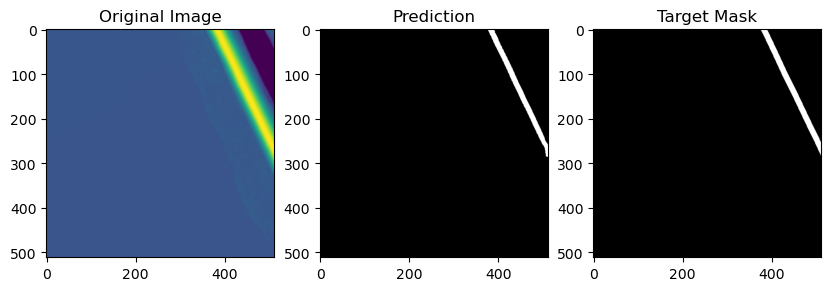

7


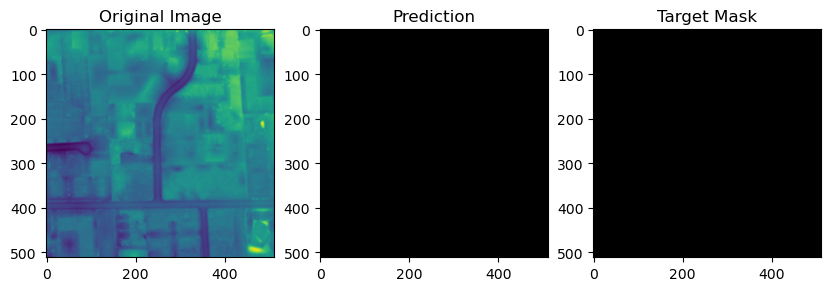

8


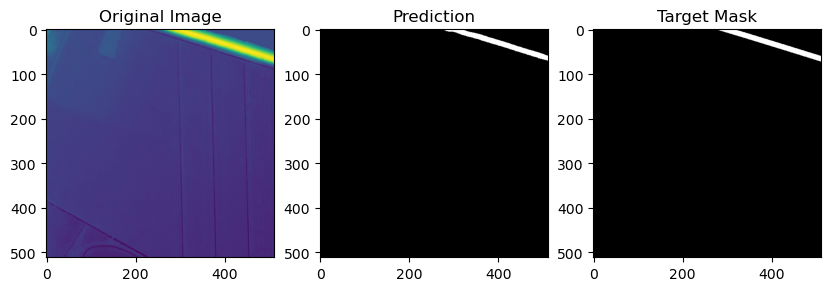

9


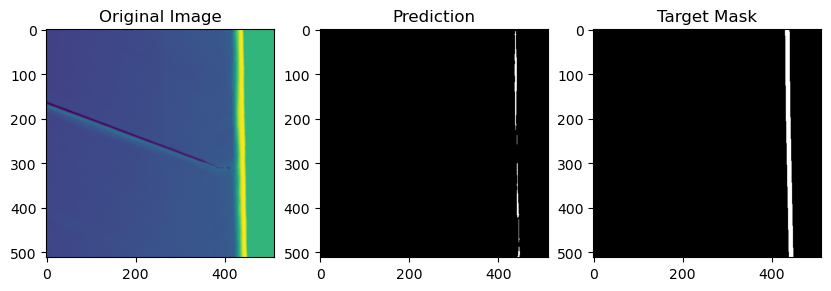

10


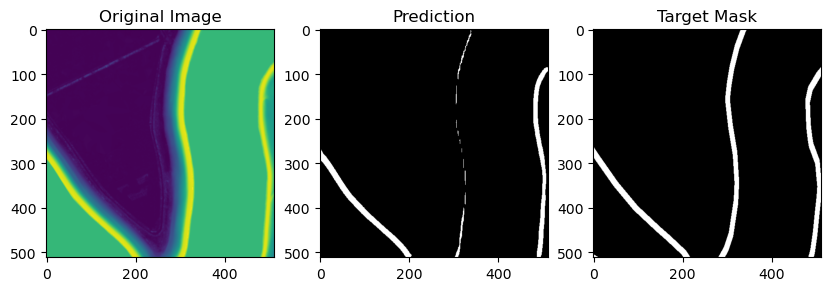

11


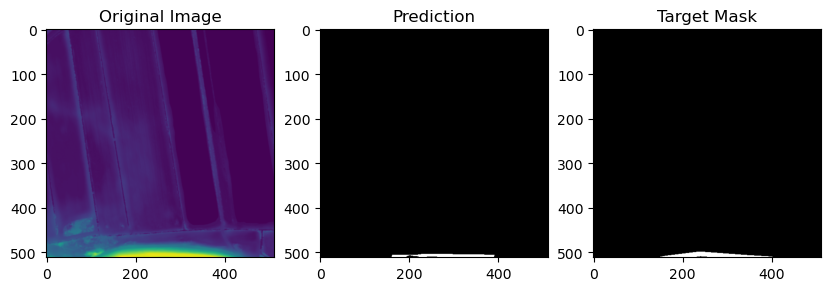

12


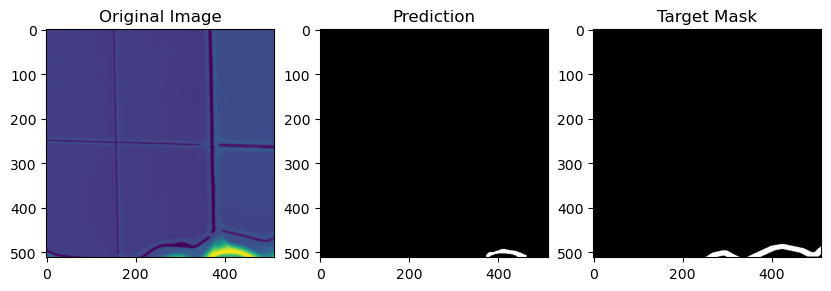

13


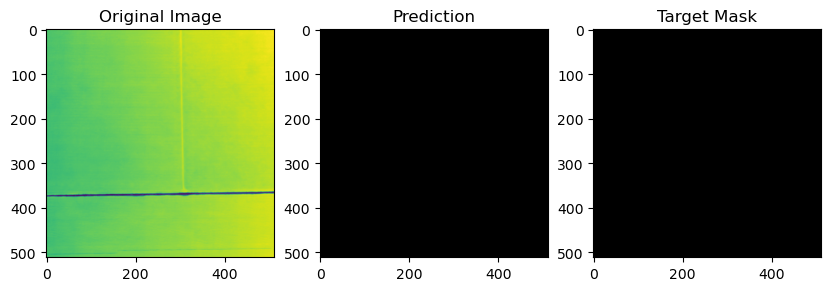

14


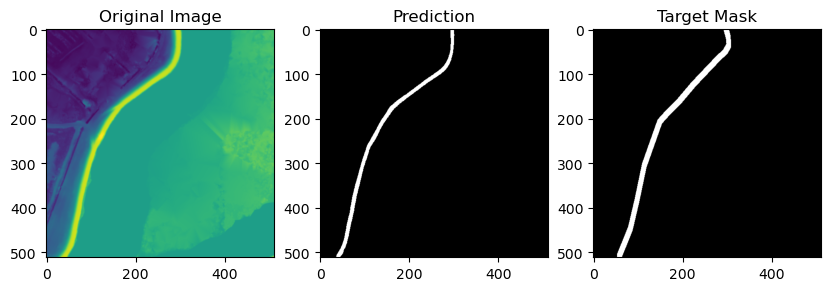

15


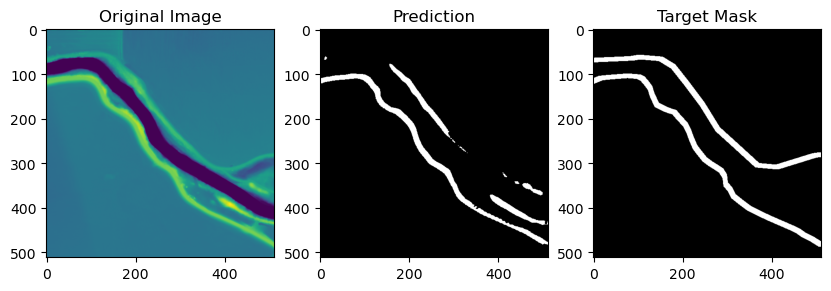

16


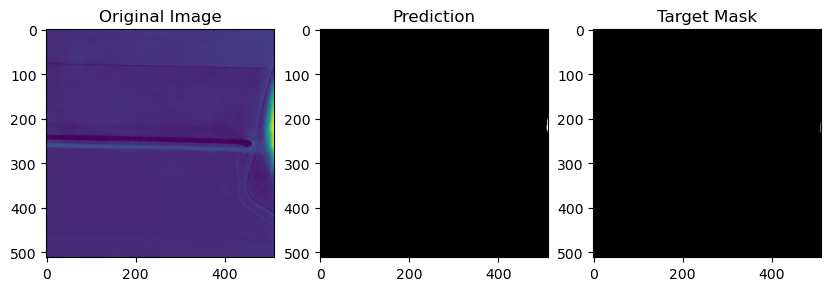

17


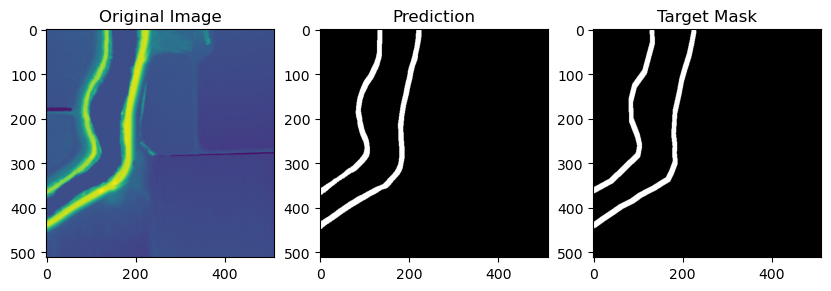

18


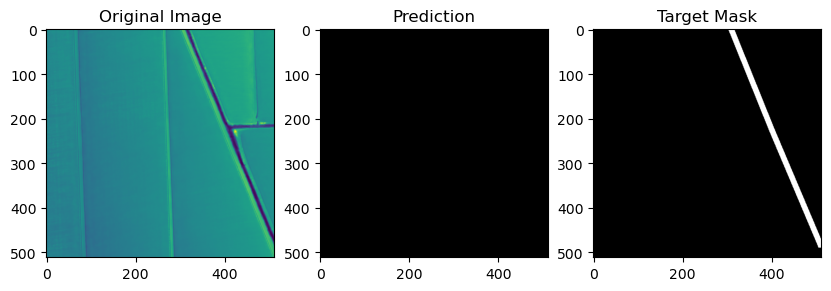

19


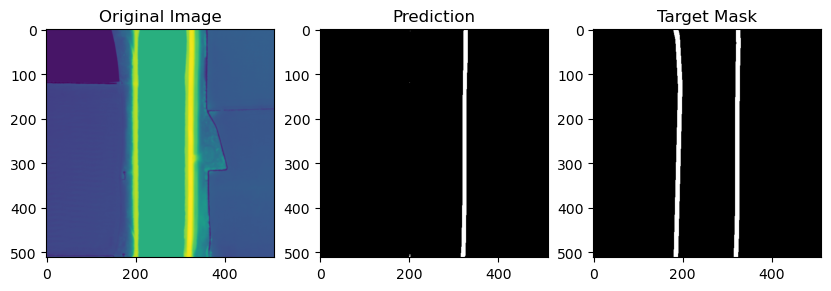

20


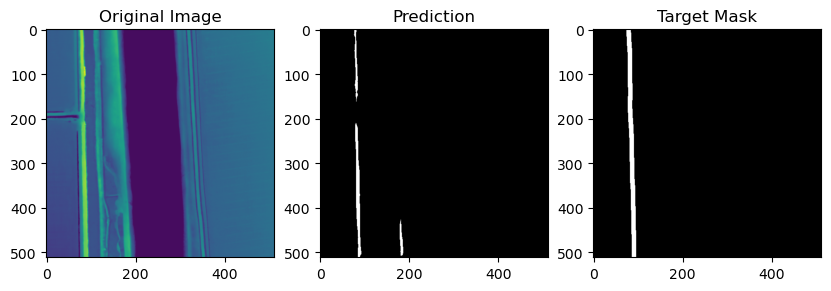

21


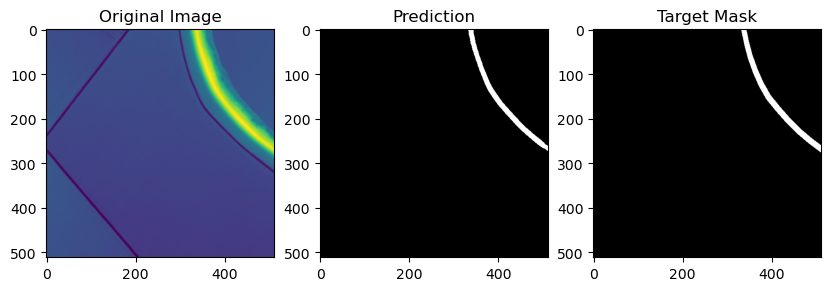

22


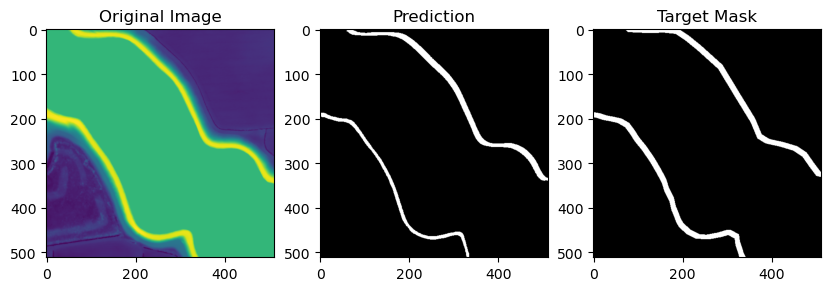

23


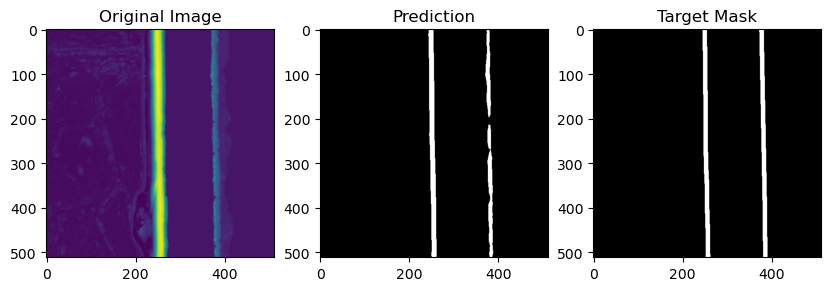

24


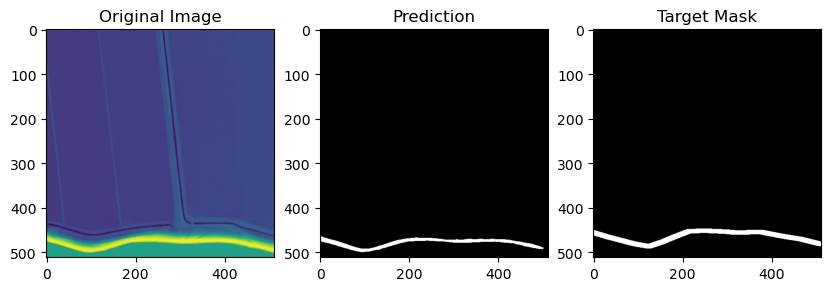

25


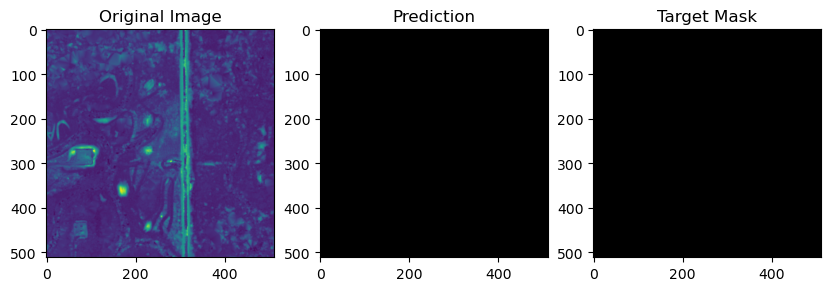

26


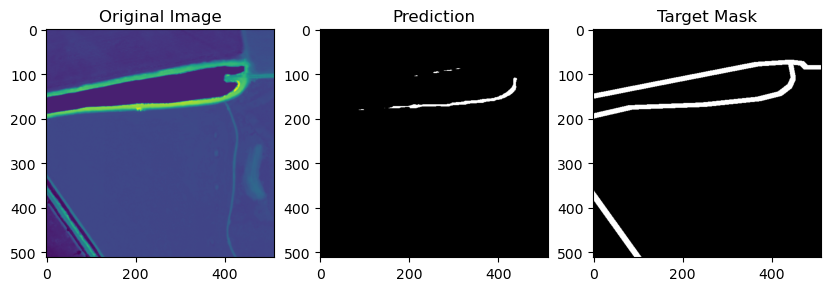

27


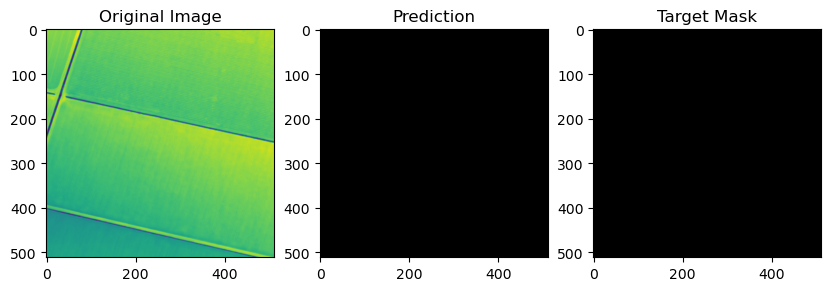

28


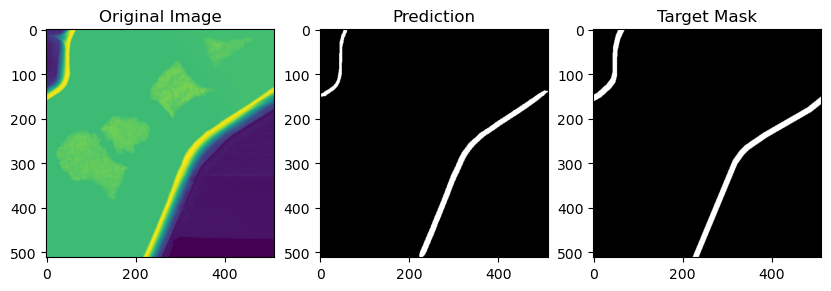

29


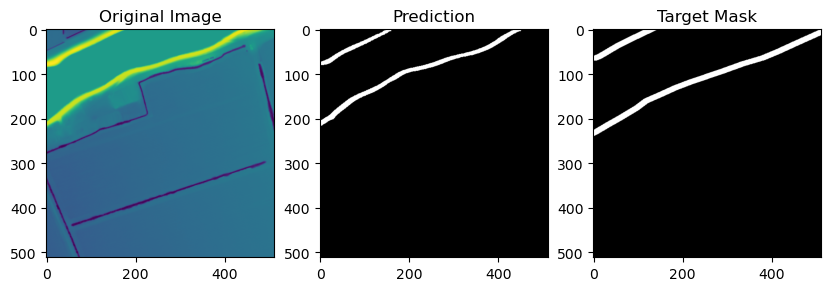

30


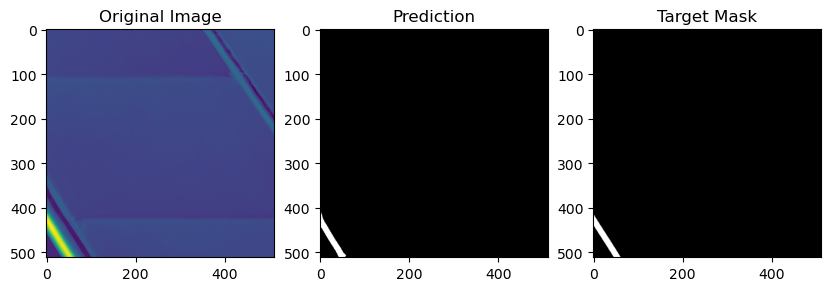

31


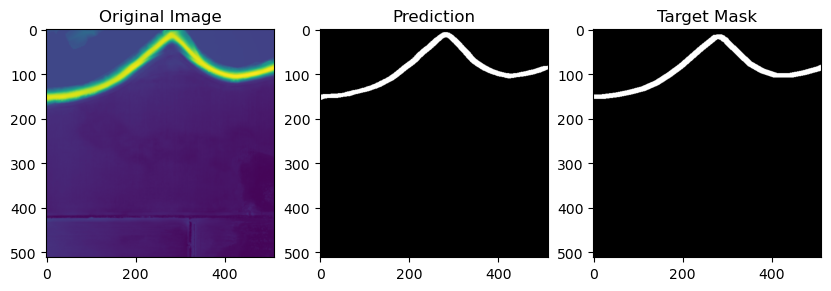

32


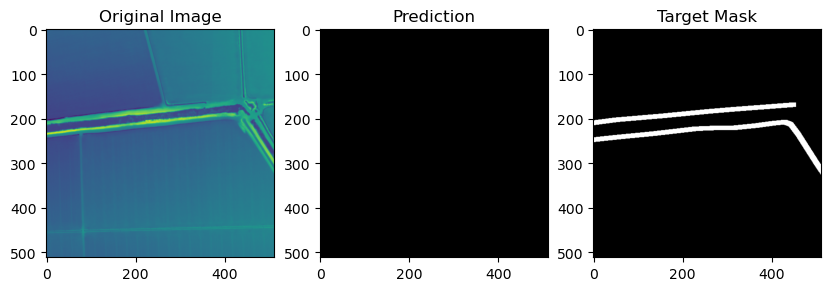

33


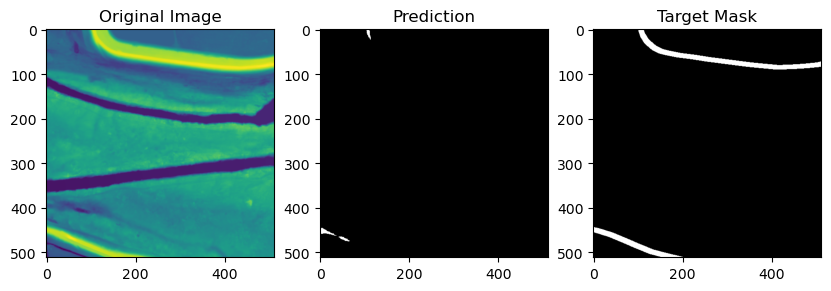

34


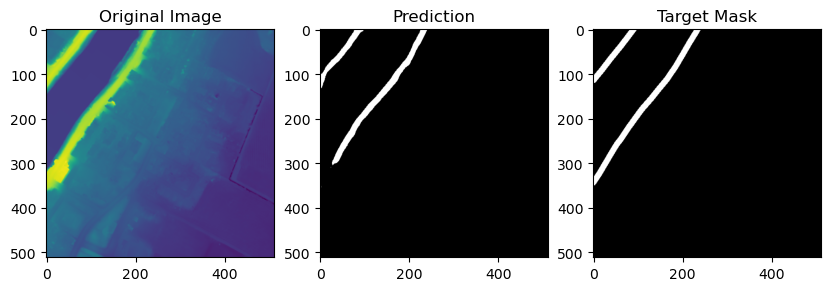

35


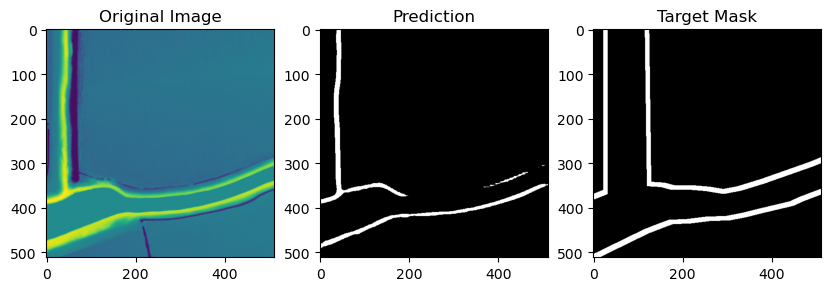

36


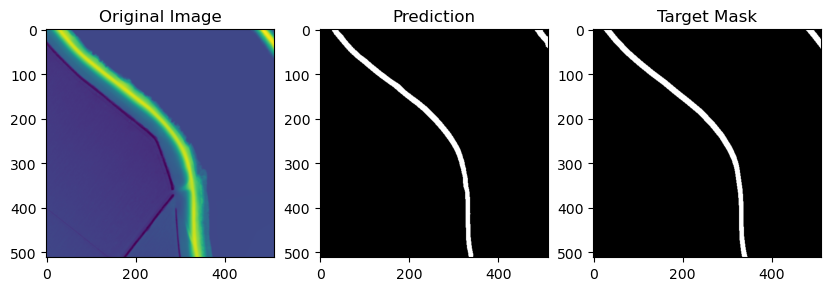

37


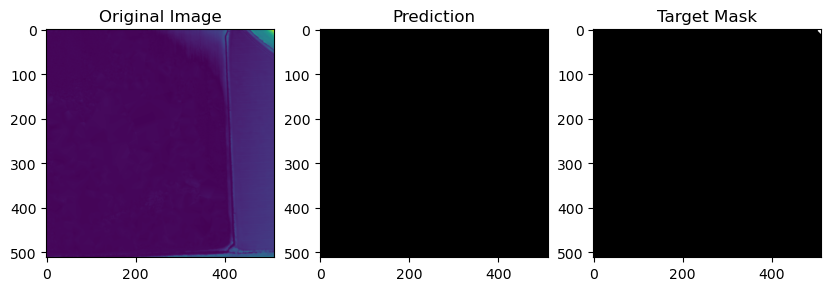

38


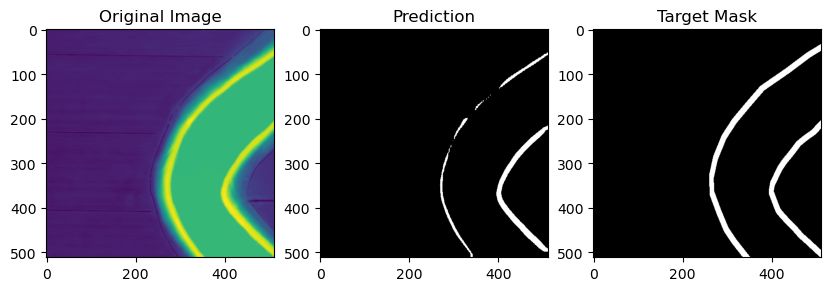

39


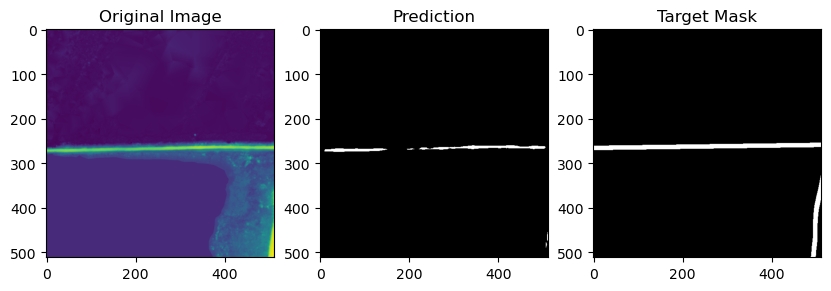

40


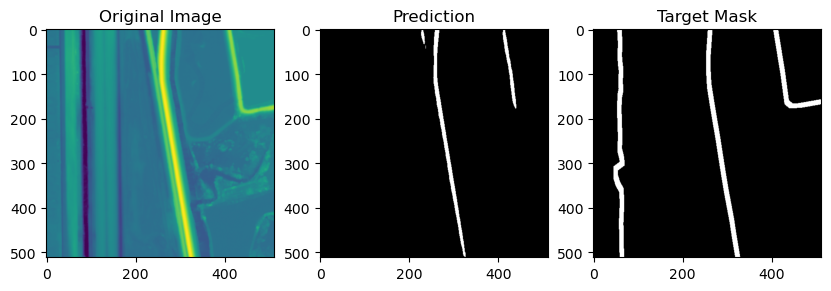

41


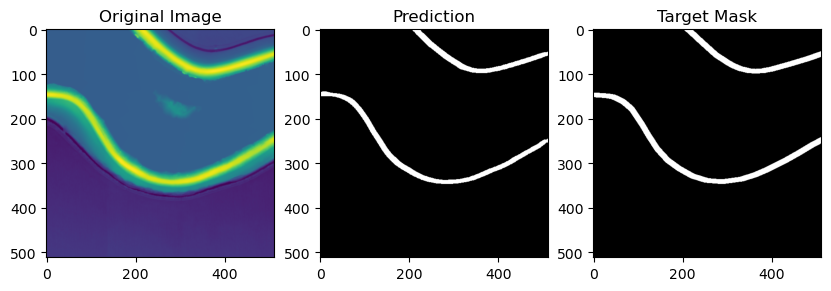

42


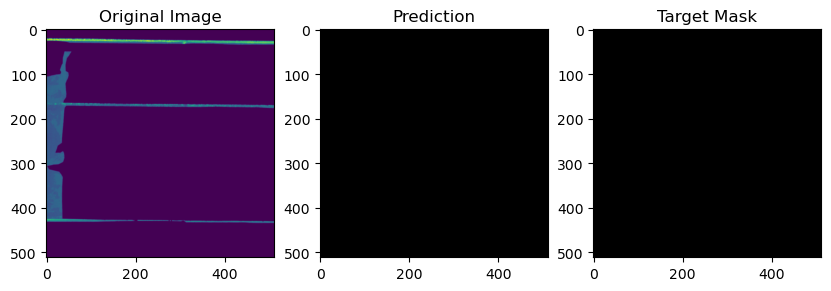

43


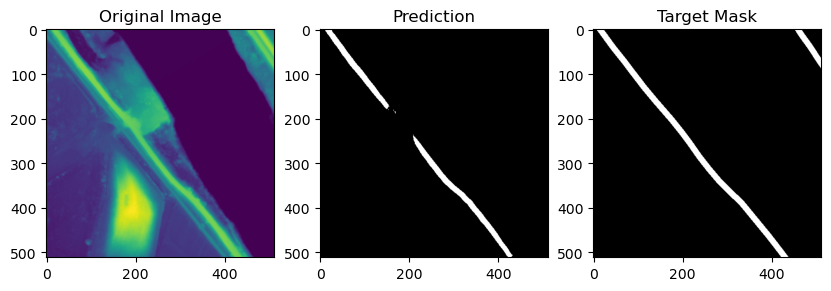

44


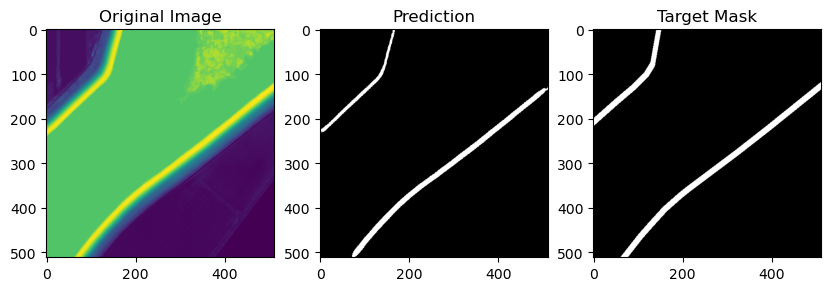

45


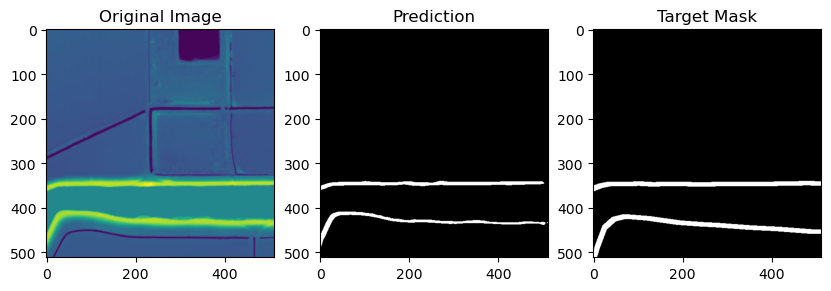

46


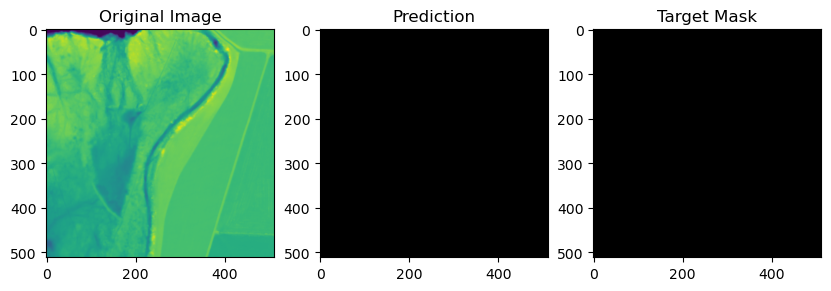

47


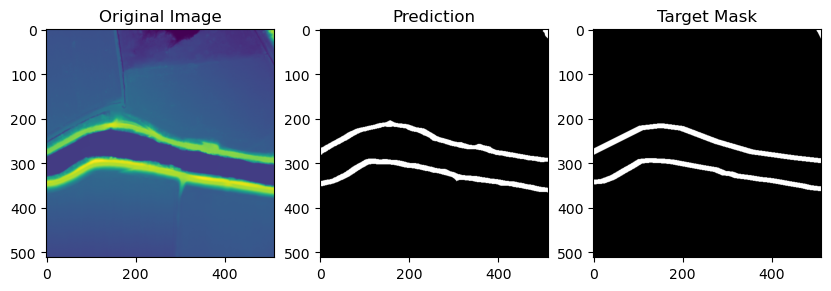

48


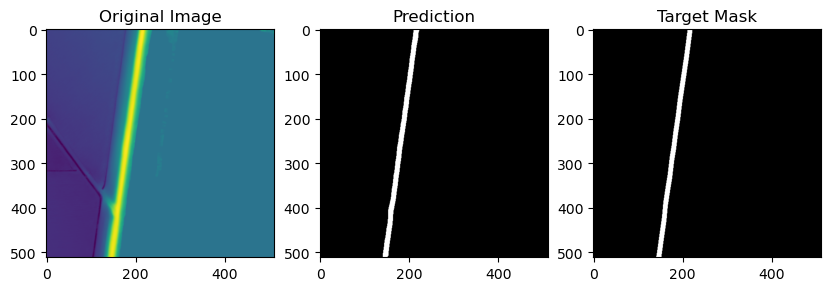

49


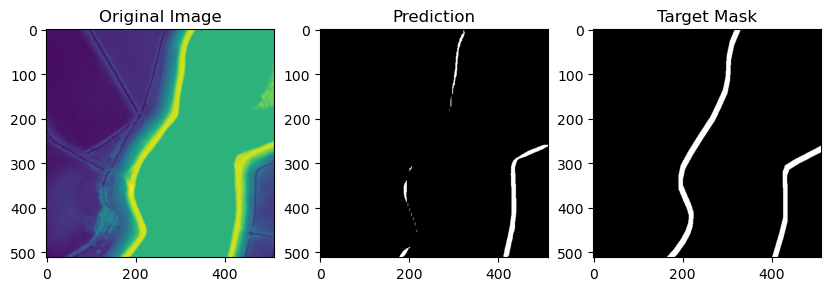

50


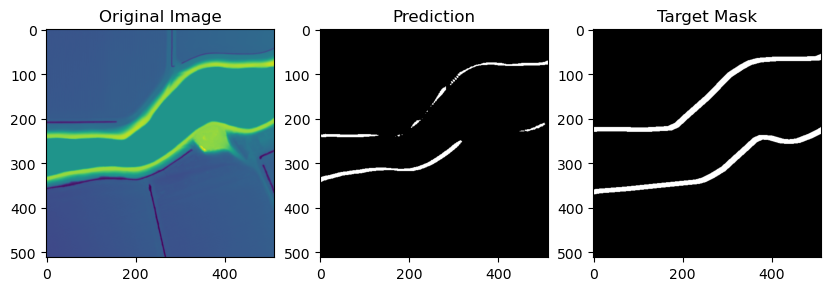

51


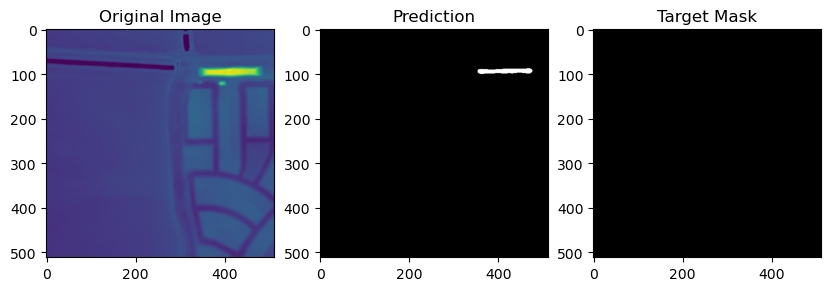

52


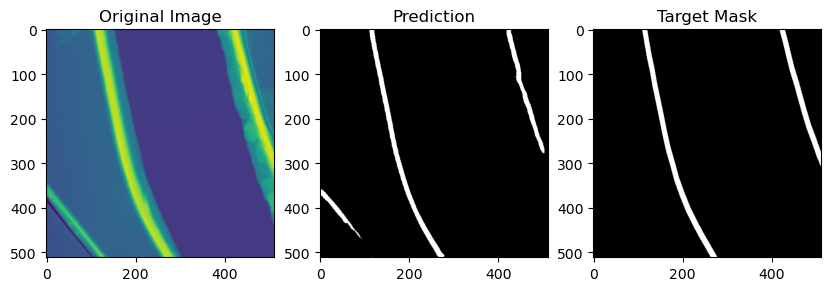

53


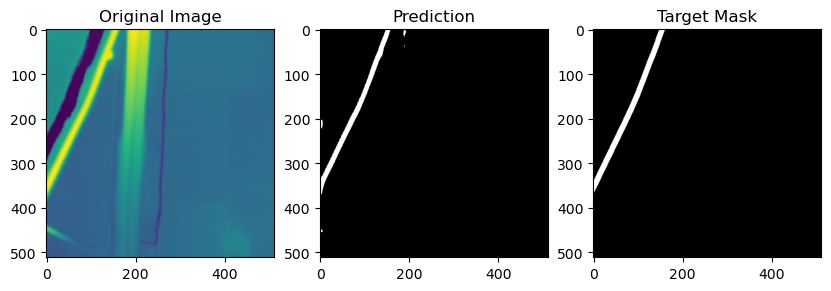

54


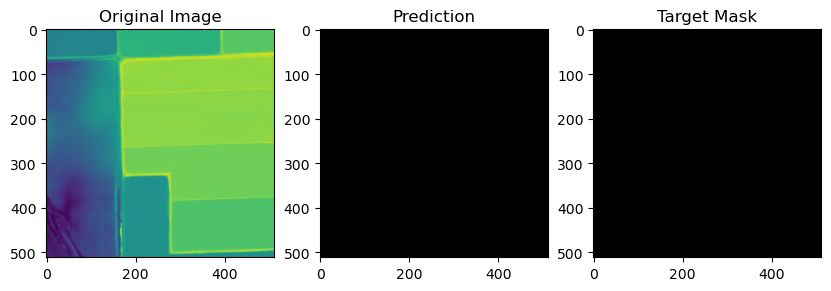

55


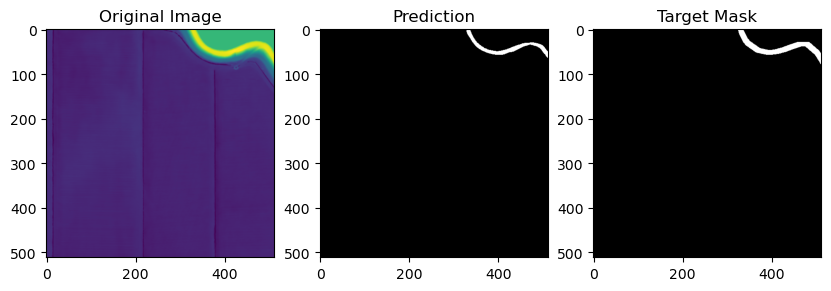

56


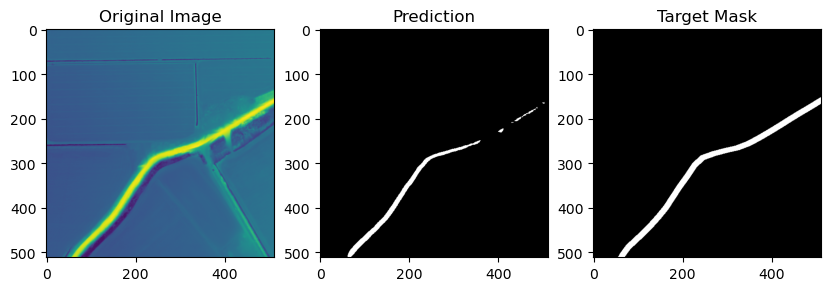

57


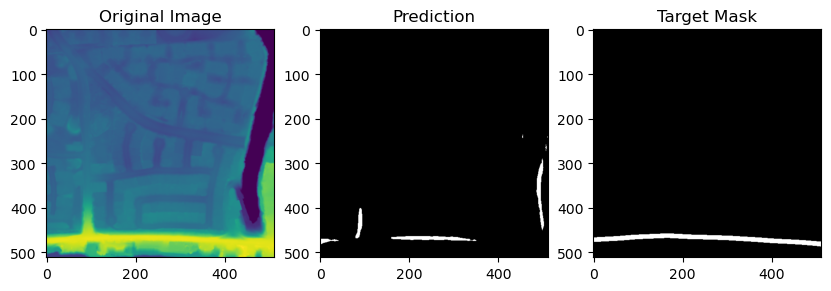

58


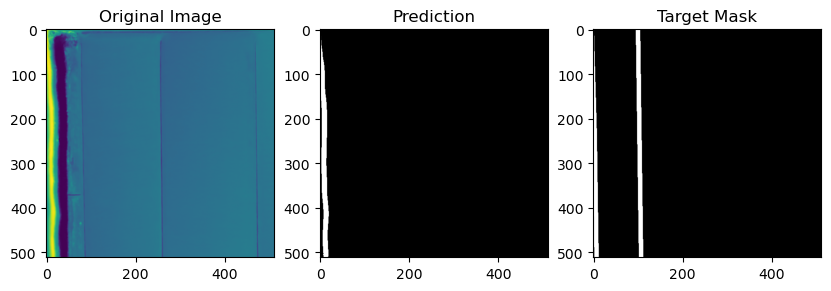

59


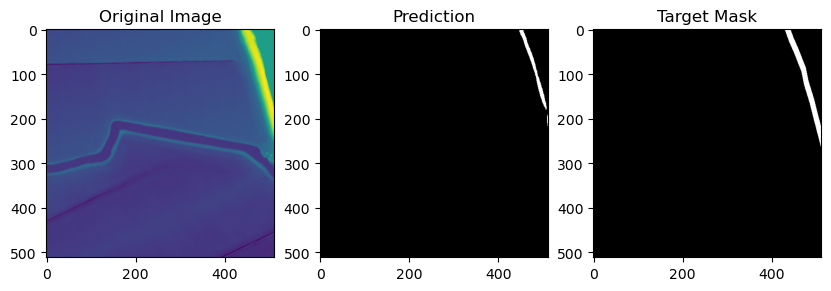

In [41]:
for ix in range(60):
    sample_image, sample_mask = val_dataset[ix]
    # sample_image = sample_image.unsqueeze(0)
    print(ix)
    output = infer_and_visualize(model, sample_image, sample_mask, apply_sigmoid=True)

In [59]:
val_loader.dataset.weights_return

False

In [1]:
model = smp.DeepLabV3Plus(
    encoder_name="resnet34",  # Choose backbone
    encoder_weights="imagenet",  # Use pre-trained weights
    in_channels=1,  # Your data has 1 channel (grayscale)
    classes=1,  # Output is 1 class (binary segmentation)
).to(device)

optimizer = optim.Adam(model.parameters(), lr=1e-3)

NameError: name 'smp' is not defined

In [61]:
best_loss = float("inf")
epochs = 25

train_loss_list = []
val_loss_list = []

for epoch in range(epochs):
    model.train()
    train_loss = 0.0

    for batch in train_loader:
        if training_dataset.weights_return:
            images, mask, weights = batch  # Extract weights if present
            images, mask, weights = (
                images.to(device),
                mask.to(device),
                weights.to(device),
            )
        else:
            images, mask = batch
            images, mask = images.to(device), mask.to(device)
            weights = torch.ones_like(mask)  # Default weights = 1 if not provided

        optimizer.zero_grad()
        output = model(images)

        # Compute weighted loss
        # By default reduction is mean, so it would take an average over
        # all images and all pixels in the batch, returning single scalar
        # But that would make it impossible to apply weights
        # So in our case we set reduction to none, this creates an instance of
        # loss function which is then applied to output, mask, where output is actually
        # an array of outputs (batch_size, 1, H, W)
        loss = nn.BCEWithLogitsLoss(reduction="none")(
            output, mask
        )  # Compute per-element loss

        # Computing weighted loss is just computing a weighted average
        # We normally would do loss.mean() which gets an average over
        # all images in batch and all their pixels
        # Here we want to still take an average over pixels, but
        # the average over images should be weighted
        # loss.shape = (batch_size, 1, H, W), so to average over pixels
        # we can take mean with dim=(2,3) argument, this results in
        # loss.shapr = (batch_size, 1), so to multiply by weights we need to
        # reshape with .view(-1, 1). Then to get weighted average we sum the loss
        # and divide over sum of weights
        # Loss is then just a scalar for which we can then compute gradients with
        # respect to model parameters
        loss = loss.mean(
            dim=(2, 3)
        )  # Compute mean over H and W (pixel-wise mean per image)

        # Normalize by total weight sum (to match validation loss scale)
        loss = (loss * weights.view(-1, 1)).sum() / weights.sum()

        loss.backward()
        optimizer.step()
        train_loss += loss.item()

    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for batch in val_loader:
            images, mask = batch  # Validation does not use weights
            images, mask = images.to(device), mask.to(device)

            output = model(images)
            loss = nn.BCEWithLogitsLoss()(output, mask)  # Standard loss for validation

            val_loss += loss.item()

    train_loss /= len(train_loader)
    val_loss /= len(val_loader)

    train_loss_list.append(train_loss)
    val_loss_list.append(val_loss)

    print(
        f"Epoch: {epoch+1}/{epochs} Train Loss: {train_loss:.6f} Val Loss: {val_loss:.6f}"
    )

Epoch: 1/25 Train Loss: 0.285146 Val Loss: 0.208438
Epoch: 2/25 Train Loss: 0.074336 Val Loss: 0.185636
Epoch: 3/25 Train Loss: 0.059451 Val Loss: 0.088792
Epoch: 4/25 Train Loss: 0.053574 Val Loss: 0.057594
Epoch: 5/25 Train Loss: 0.051026 Val Loss: 0.054008
Epoch: 6/25 Train Loss: 0.049869 Val Loss: 0.056452
Epoch: 7/25 Train Loss: 0.048517 Val Loss: 0.056055
Epoch: 8/25 Train Loss: 0.046585 Val Loss: 0.049614
Epoch: 9/25 Train Loss: 0.045973 Val Loss: 0.053415
Epoch: 10/25 Train Loss: 0.044980 Val Loss: 0.051825
Epoch: 11/25 Train Loss: 0.044086 Val Loss: 0.045407
Epoch: 12/25 Train Loss: 0.043072 Val Loss: 0.048616
Epoch: 13/25 Train Loss: 0.043440 Val Loss: 0.048189
Epoch: 14/25 Train Loss: 0.043055 Val Loss: 0.045260
Epoch: 15/25 Train Loss: 0.041986 Val Loss: 0.043560
Epoch: 16/25 Train Loss: 0.041669 Val Loss: 0.050822
Epoch: 17/25 Train Loss: 0.041020 Val Loss: 0.045566
Epoch: 18/25 Train Loss: 0.040224 Val Loss: 0.043992
Epoch: 19/25 Train Loss: 0.040378 Val Loss: 0.043151
Ep

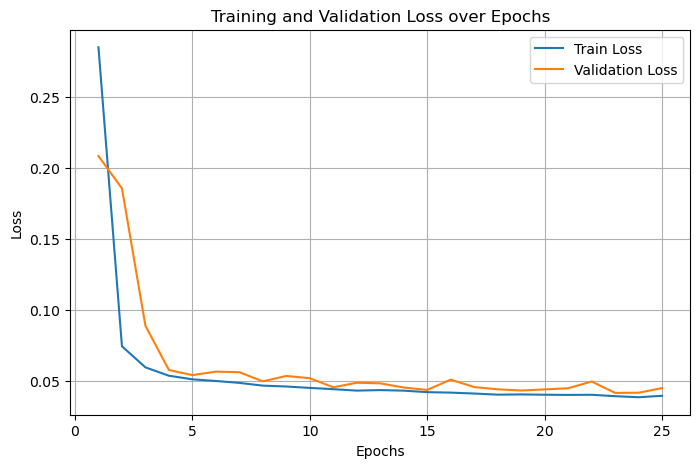

In [62]:
plot_training_validation_loss(train_loss_list, val_loss_list)

0


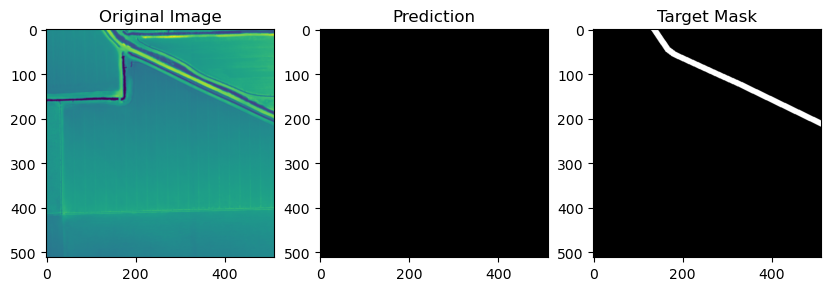

1


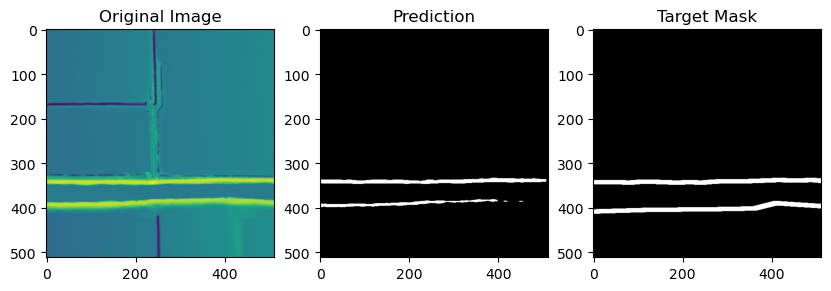

2


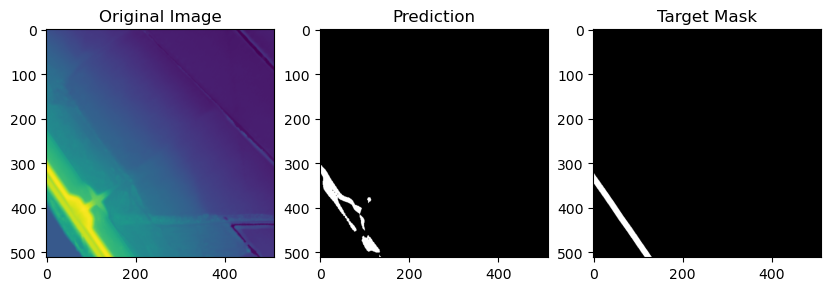

3


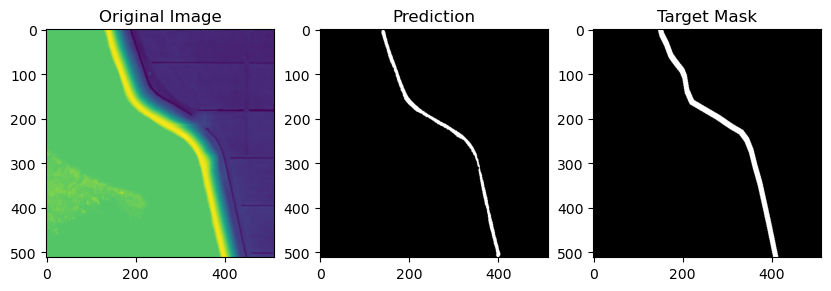

4


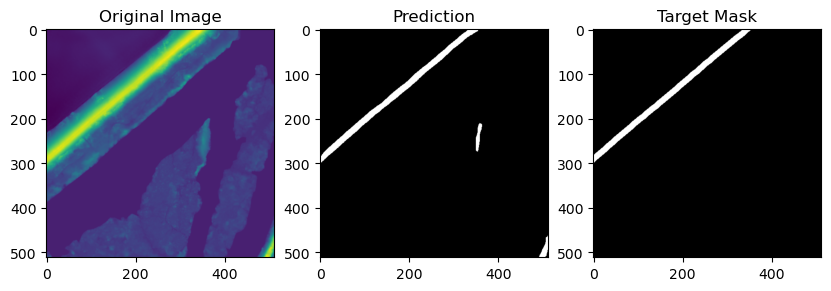

5


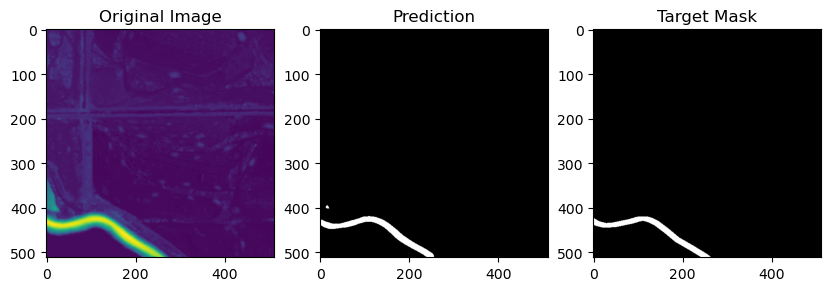

6


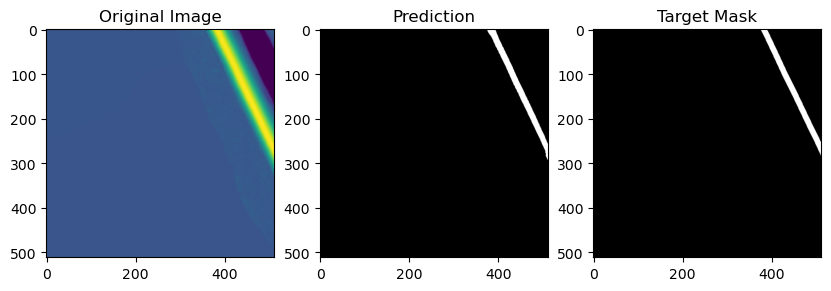

7


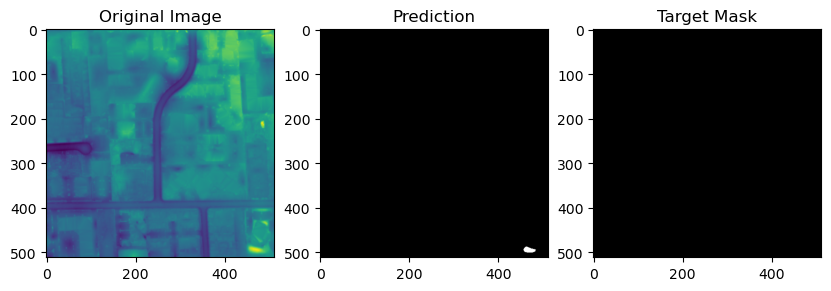

8


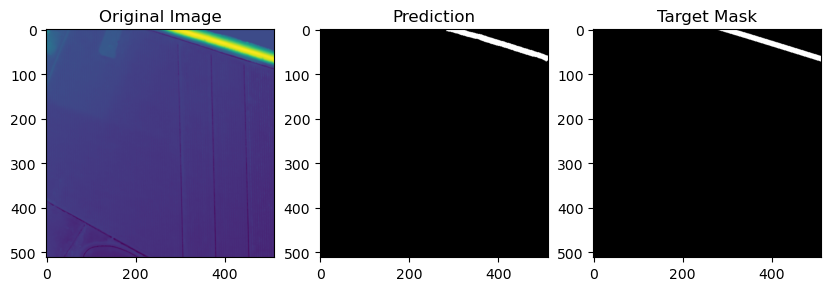

9


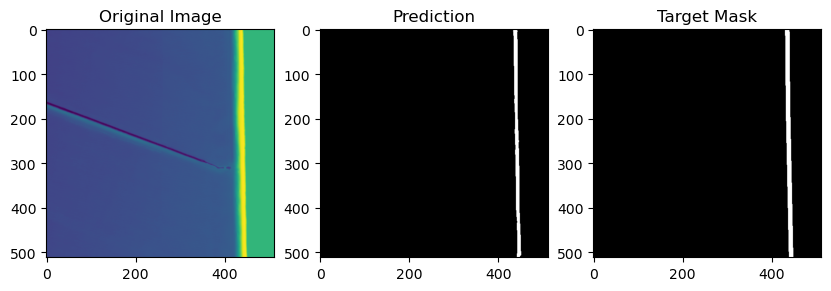

10


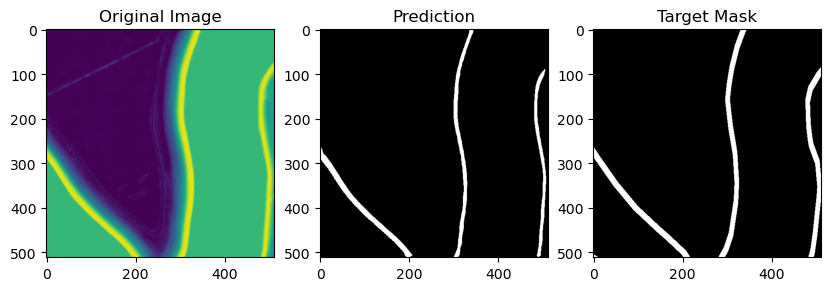

11


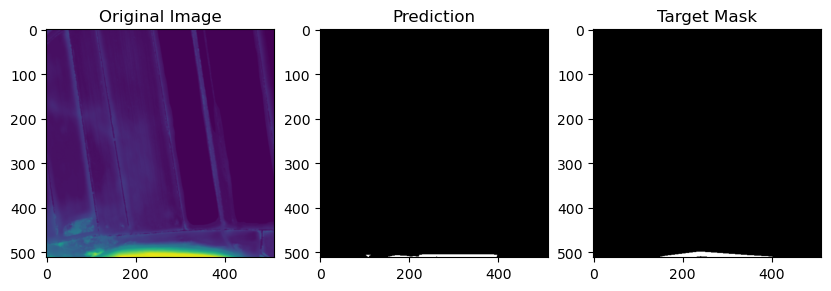

12


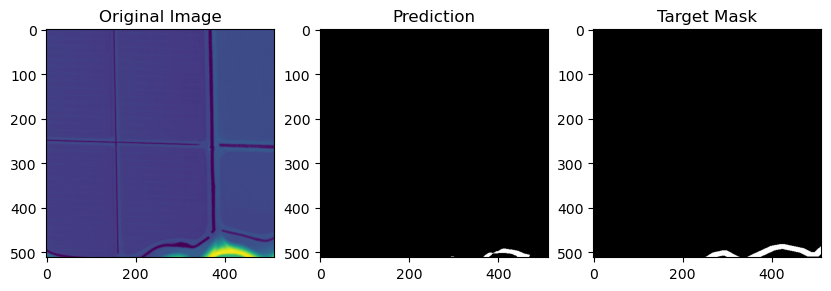

13


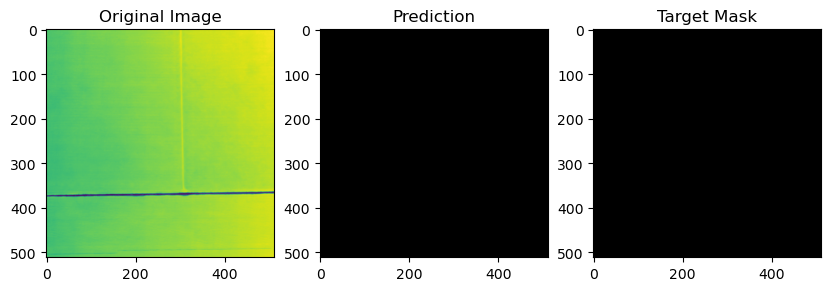

14


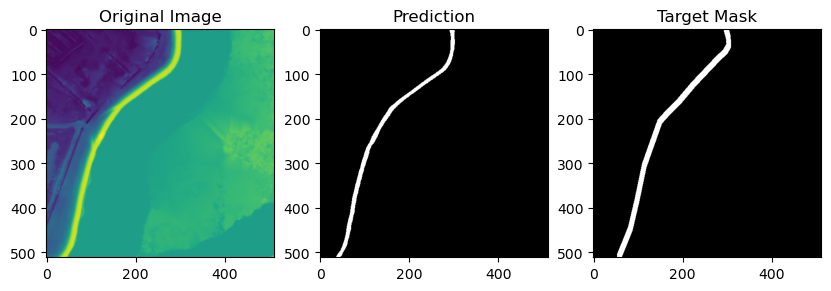

15


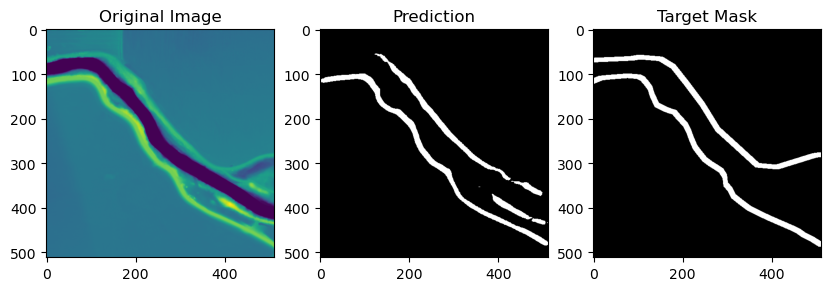

16


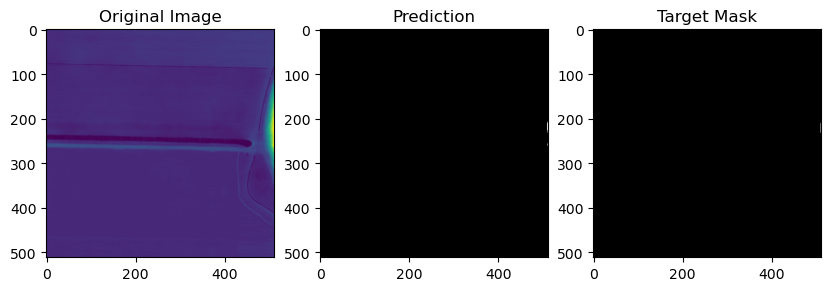

17


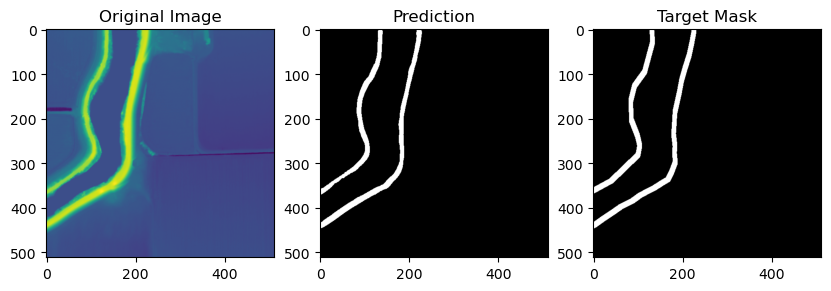

18


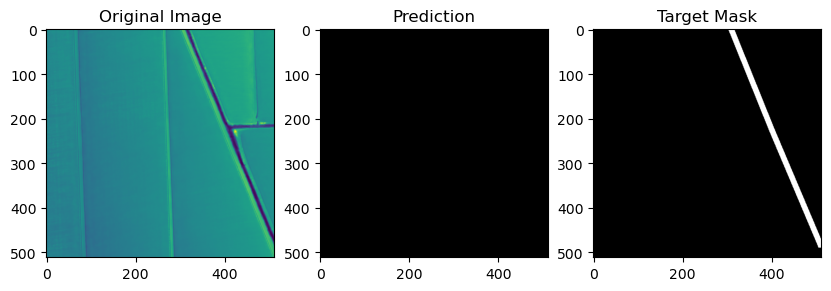

19


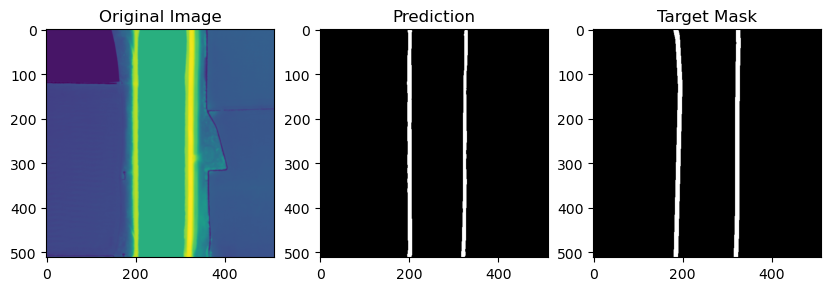

20


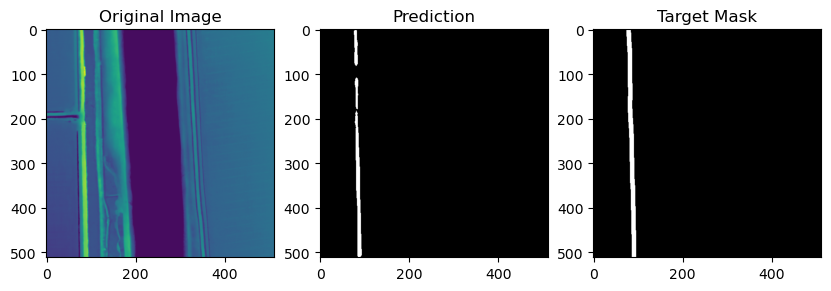

21


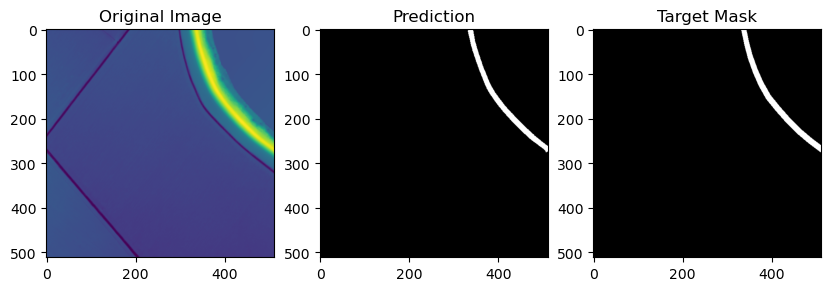

22


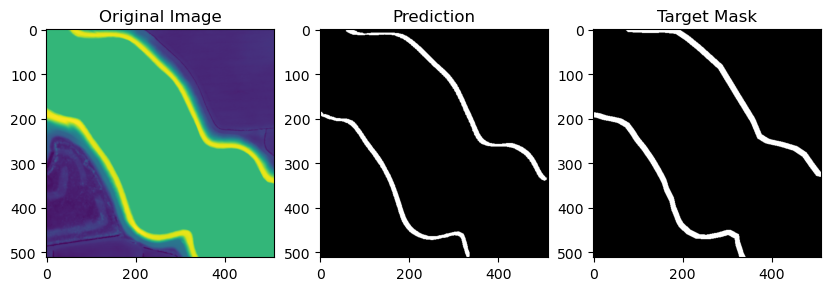

23


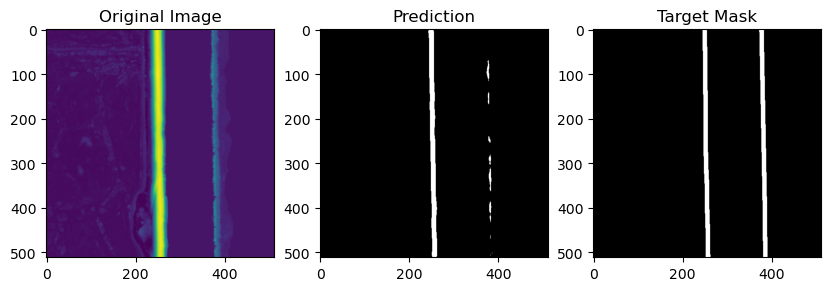

24


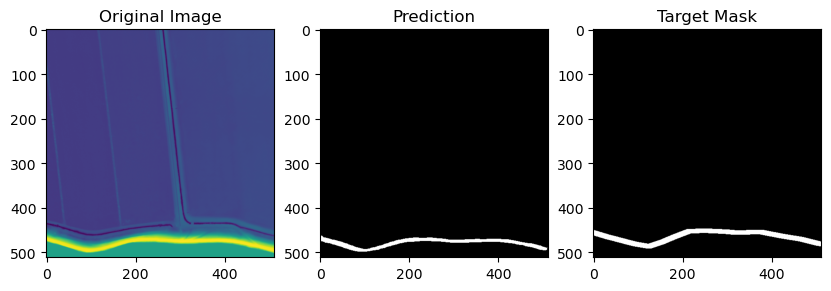

25


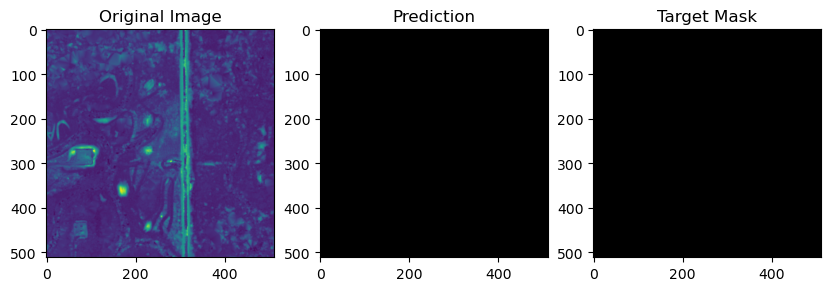

26


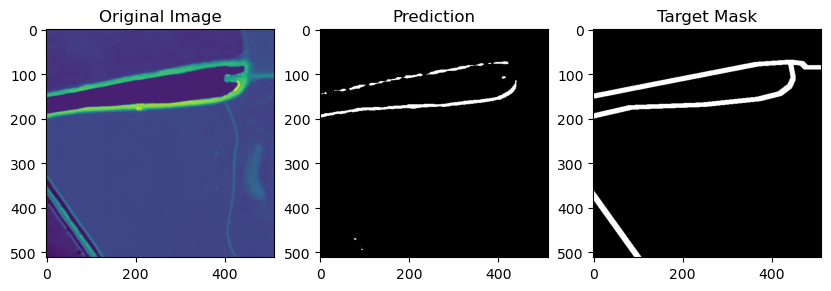

27


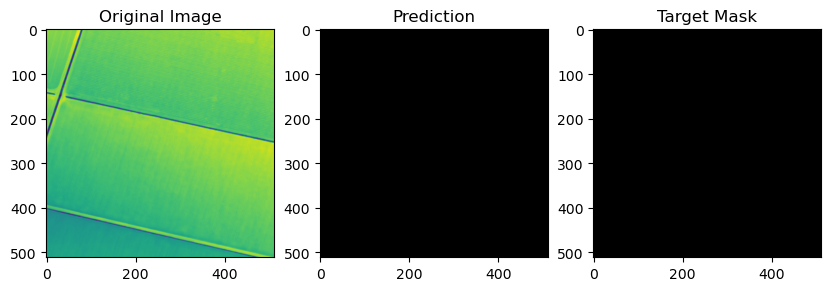

28


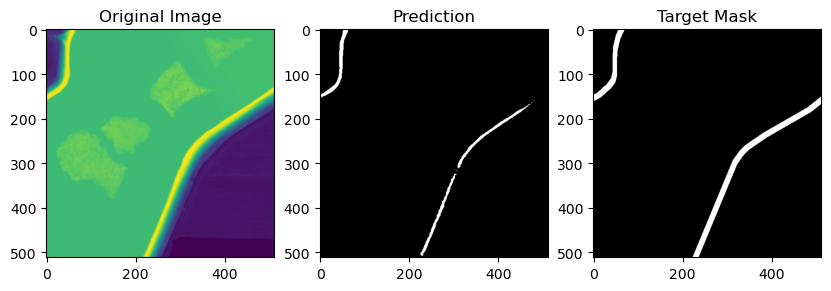

29


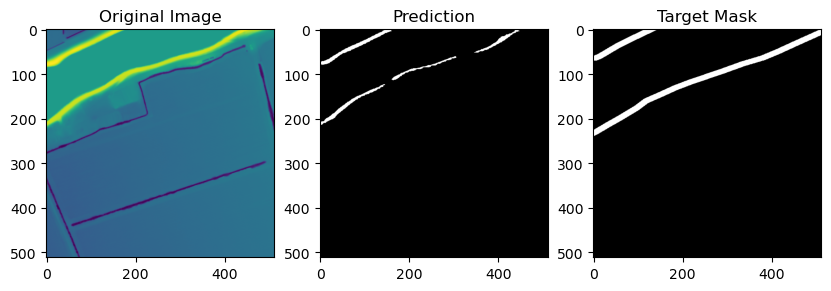

30


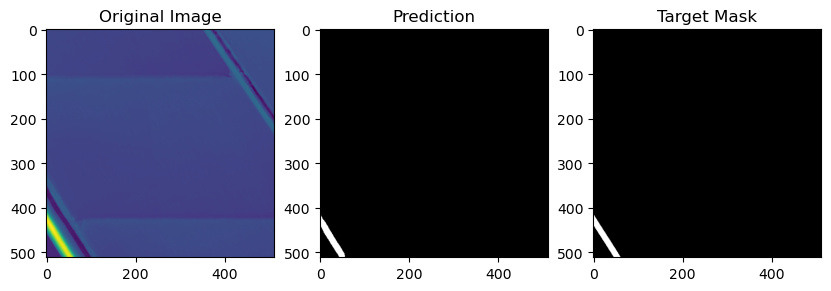

31


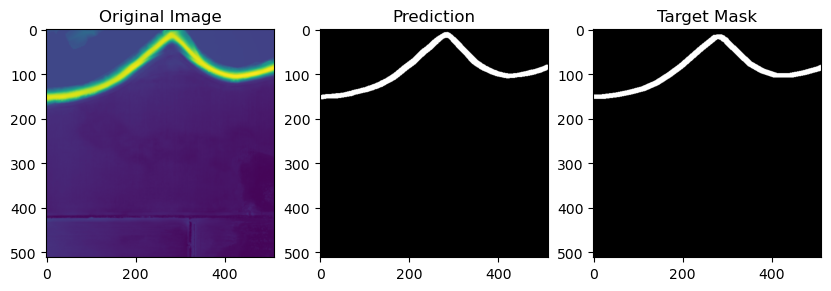

32


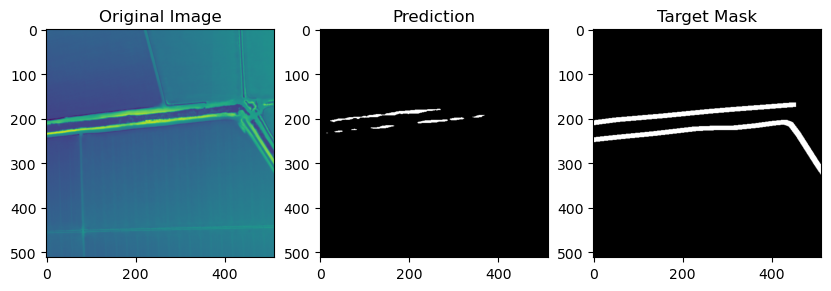

33


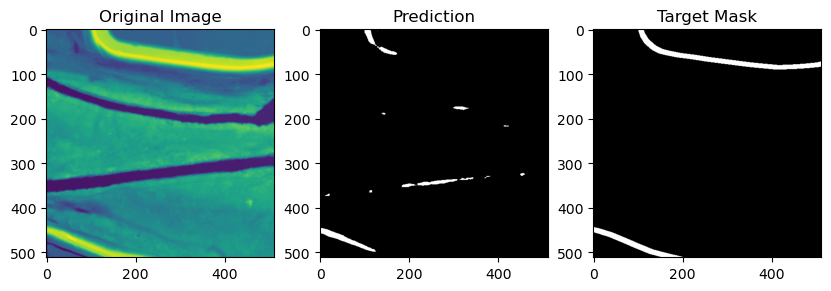

34


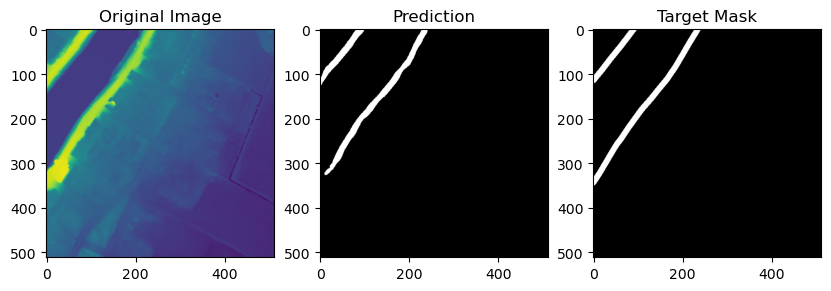

35


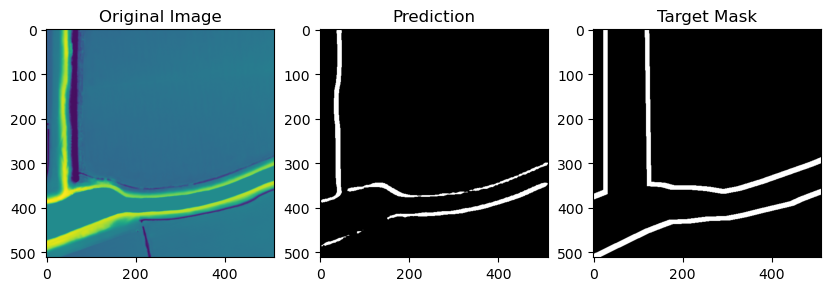

36


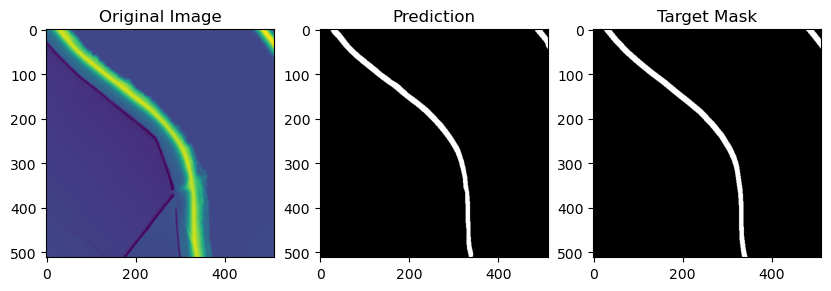

37


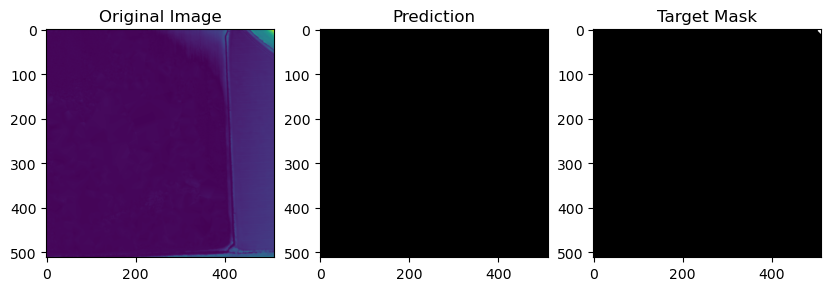

38


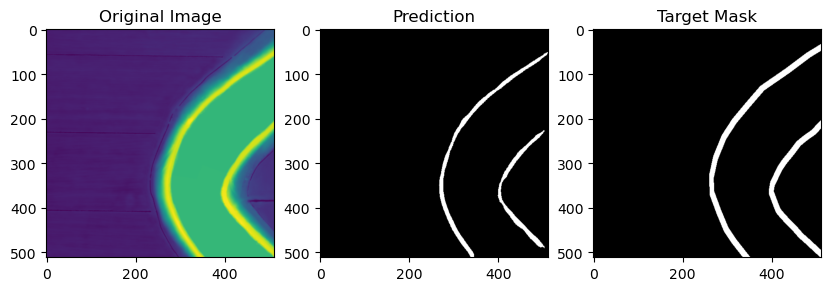

39


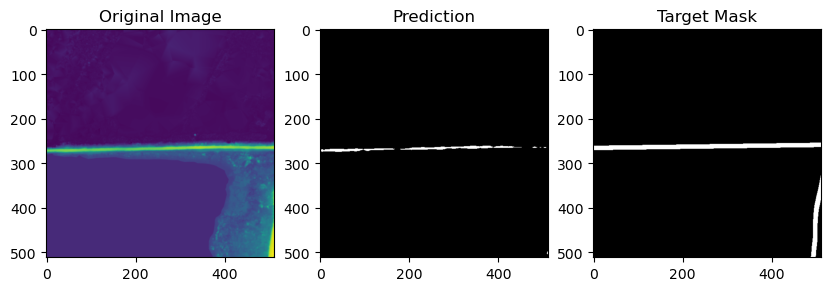

40


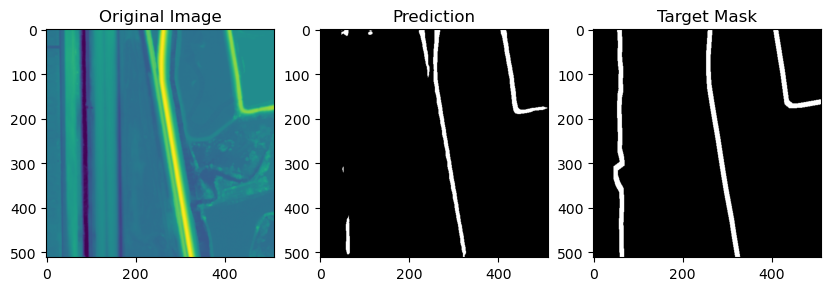

41


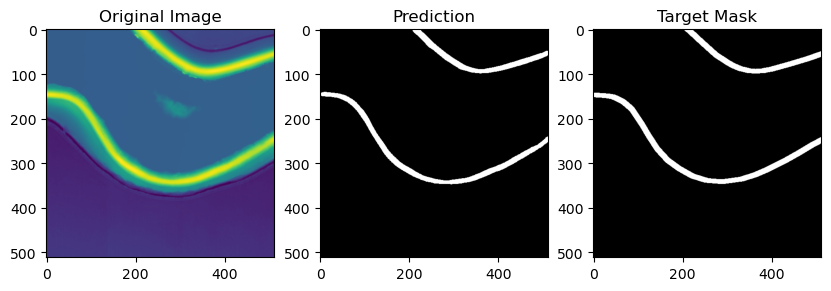

42


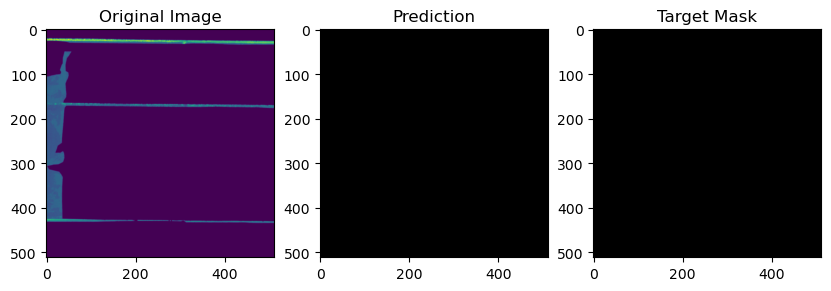

43


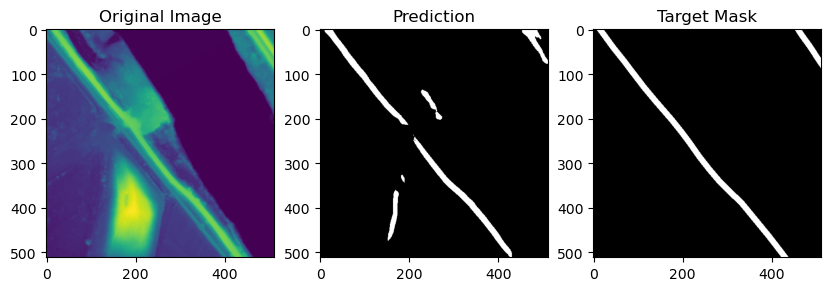

44


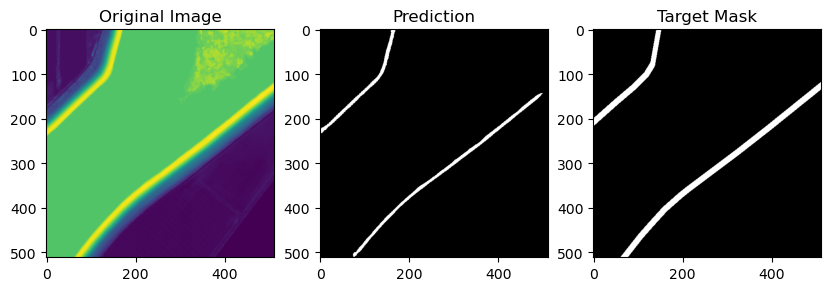

45


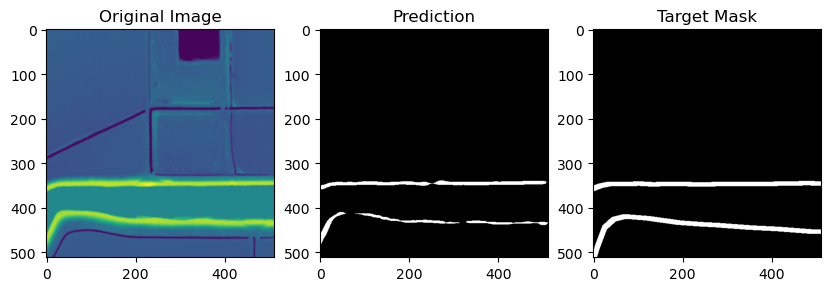

46


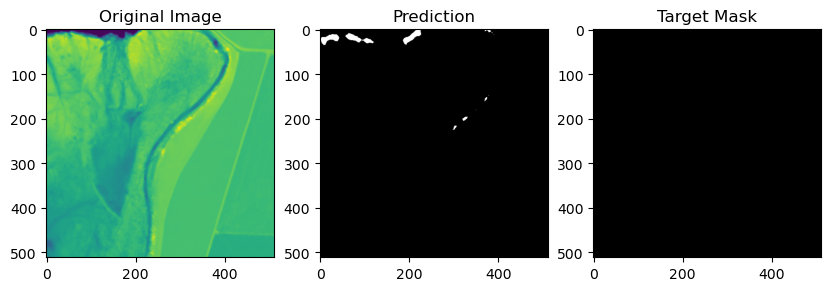

47


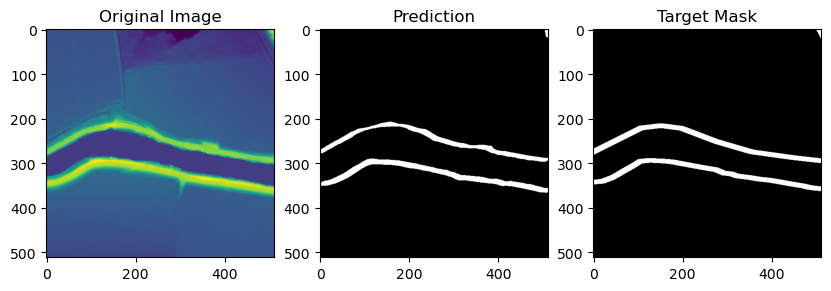

48


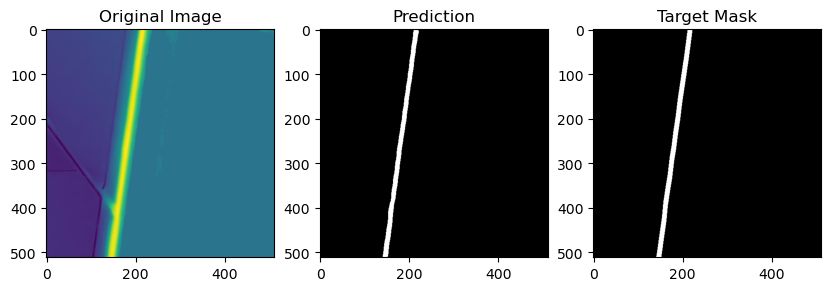

49


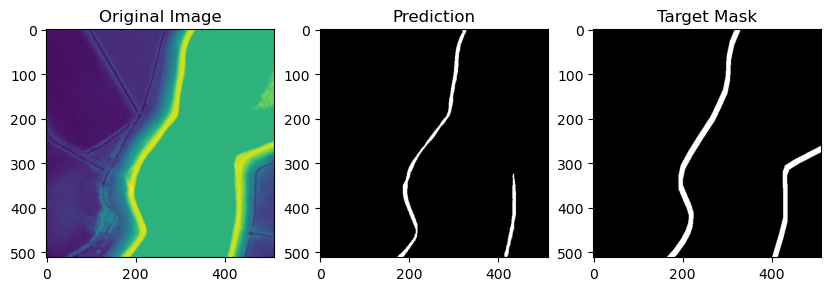

50


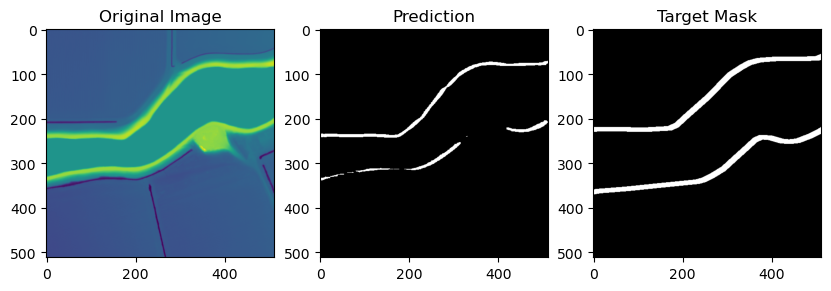

51


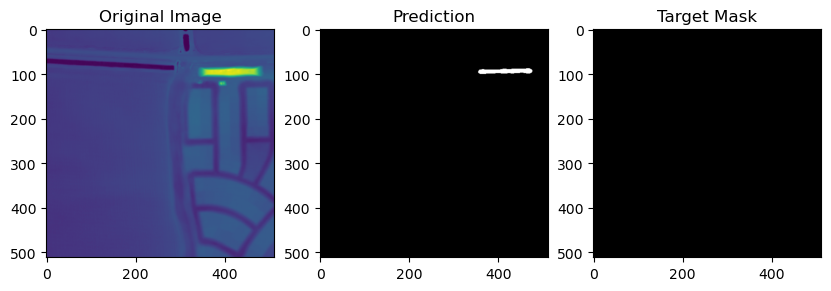

52


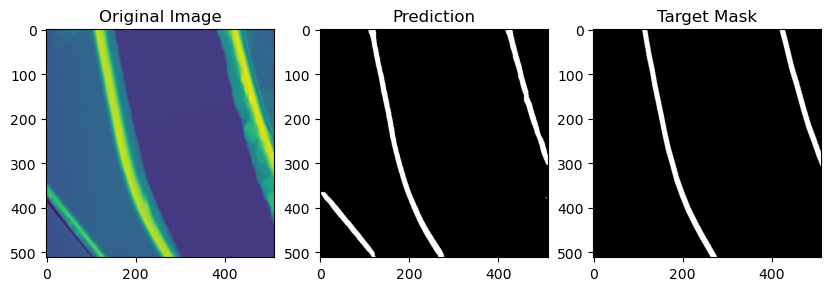

53


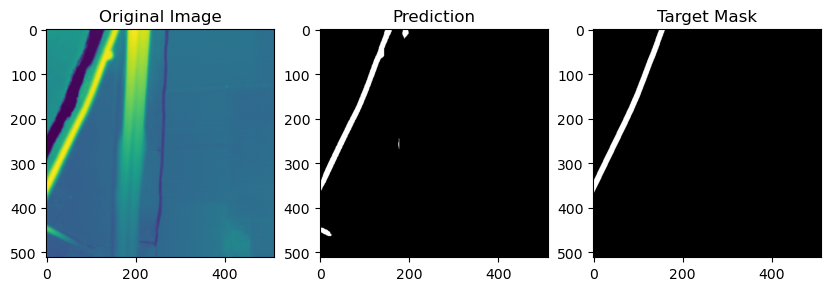

54


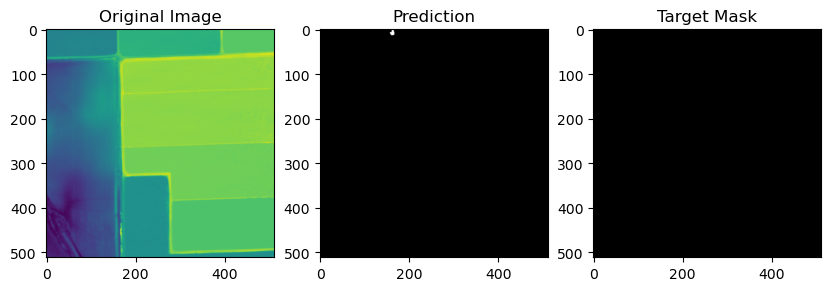

55


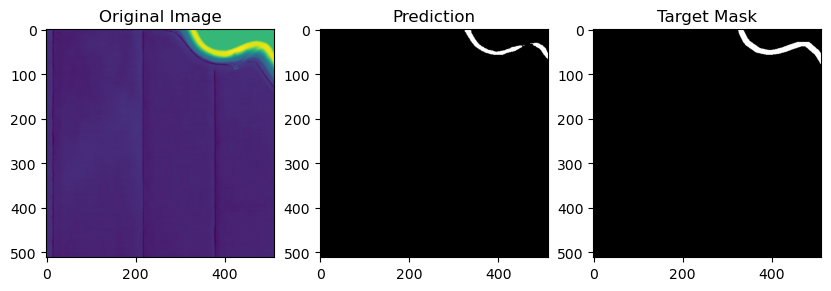

56


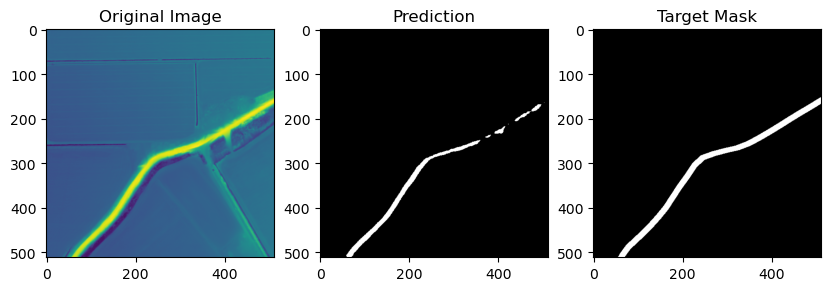

57


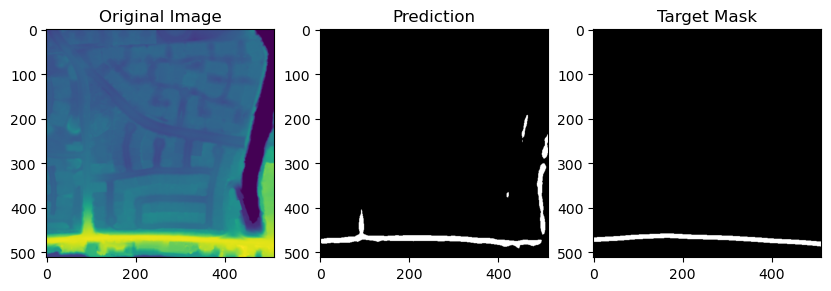

58


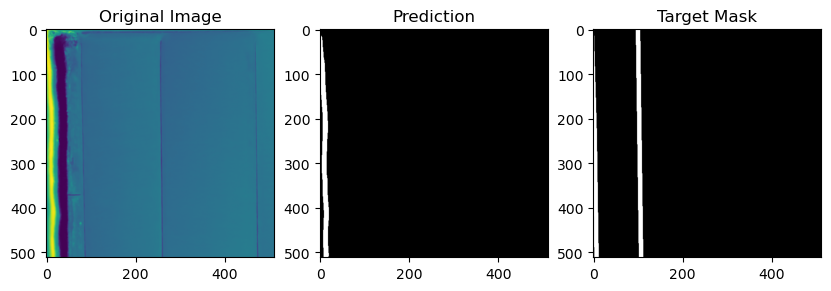

59


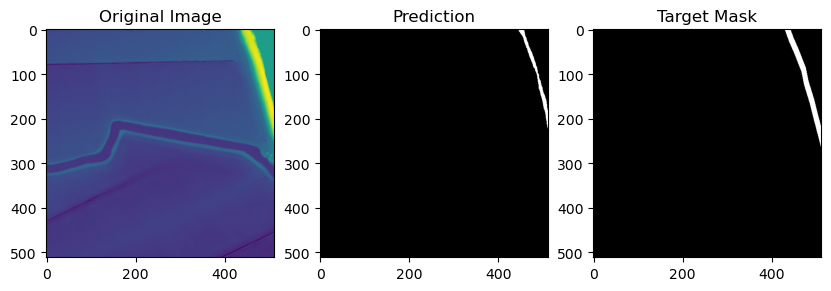

In [63]:
for ix in range(60):
    sample_image, sample_mask = val_dataset[ix]
    # sample_image = sample_image.unsqueeze(0)
    print(ix)
    output = infer_and_visualize(model, sample_image, sample_mask, apply_sigmoid=True)

In [64]:
model.__class__.__name__

'DeepLabV3Plus'

In [65]:
torch.save(model.state_dict(), "../models/w4-based-models/DeepLabV3Plus-1m_512.pth")

print("Saved model at ../models/w4-based-models/DeepLabV3Plus-1m_512.pth")

Saved model at ../models/w4-based-models/DeepLabV3Plus-1m_512.pth
